# **Breaking Bottlenecks: Delivery Gameplan for Olist**
Courtesy of Team Alpha (DTIDSOL-02):
- Josephine Rahma Gunawan
- Rio Pramana
- Risma Widiya Puspadevi

### **Contents:**

1. Understanding the Business Problem
2. Data Cleaning & Familiarisation
3. Exploratory Data Analysis (EDA)
4. Insights & Key Findings
5. Summary of Findings
6. Conclusion & Business Implications
7. Limitations & Considerations
8. Actionable Recommendations

# **Understanding the Business Problems**

### Background and Business Objective

E-commerce has rapidly transformed how people shop, especially in Brazil, where convenience, price, and speed play crucial roles in consumer decisions. According to a report by **NielsenIQ**, Brazilian shoppers cited the following top reasons for choosing online platforms:

- **77%** – Best price  
- **57%** – Delivery time  
- **54%** – Product variety  
- **39%** – Special promotions (e.g., free shipping, discounts, loyalty programmes)

The fact that *delivery time* ranks second highlights just how important a fast, reliable shipping experience is to customers (nearly as important as pricing itself).

For **Olist**, a major e-commerce platform that connects small and medium-sized retailers to marketplaces in Brazil, this puts increasing pressure on fulfilment operations. Delivery performance isn’t just a logistical concern. It's a business-critical metric that can influence customer satisfaction, retention, and ultimately, sales performance.

### Why Focus on On-Time Delivery (OTD)?

To evaluate delivery performance, we focus on the industry-standard metric: **On-Time Delivery (OTD)**. OTD measures the percentage of orders delivered within the promised timeframe and is calculated as:

> **OTD (%) = (Number of on-time deliveries / Total deliveries in the period) × 100**

As highlighted in a blog by **[Delage](https://delage.com.br/blog/otd-on-time-delivery-saiba-tudo-sobre-um-dos-principais-indicadores-para-o-e-commerce/)**, OTD has become one of the most relevant indicators in e-commerce logistics today. It reflects the efficiency of the entire order fulfilment process from the time an order is picked and packed to when it’s handed off by the courier.

Importantly, a survey by **Reclame Aqui** showed that **18.6% of consumers abandon their online shopping carts** if the estimated delivery time doesn’t meet their expectations. While this figure may seem modest at first glance, nearly **1 in 5 lost sales** can severely impact an e-commerce company’s bottom line, especially at scale.

Furthermore, an article by **[Gazeta do Povo](https://www.gazetadopovo.com.br/economia/e-commerce-brasileiro-busca-alternativas-a-correiodependencia-an1xq7tj25k1nnxytsml2tb4q/)** noted that logistics companies proudly advertise achieving **95% OTD** as a sign of operational excellence. While not a formal industry standard, this 95% mark is widely regarded as a benchmark for competitive performance in Brazil’s e-commerce landscape.

### Project Objective

Given the critical role that delivery time plays in consumer satisfaction and conversion rates, the objective of this project is to:

> **Improve Olist's delivery performance by increasing its On-Time Delivery (OTD) rate, aiming for a minimum benchmark of 95%.**

In addition to descriptive and diagnostic analysis, this project also leverages **machine learning to predict whether a delivery will be late or on time** based on various features available at the time of order. The goal is to take **preventive action** on high-risk deliveries such as prioritising processing or flagging for courier follow-up before issues occur.

Through data-driven insights and predictive modelling, this project aims to help Olist optimise its logistics performance, meet customer expectations, and improve overall business outcomes.

# Data Understanding & Cleaning

## Import Libraries & Datasets

In [1]:
# Data Handling & Manipulation
import pandas as pd                                         # for dataframes, CSV/Excel reading, tabular data manipulation
import numpy as np                                          # for numerical operations and array handling

# Data Visualisation (Static)
import matplotlib.pyplot as plt                             # for creating static plots
from matplotlib.ticker import FuncFormatter                 # for customising tick labels (e.g., currency, %)
import seaborn as sns                                       # for statistical visualisation (heatmaps, distplots, etc.)

# Data Visualisation (Interactive)
import plotly.express as px                                 # for quick and interactive visualisation
import plotly.graph_objects as go                           # for custom interactive plots
from plotly.subplots import make_subplots                   # for interactive subplots

# Statistical Testing & Inference
from statsmodels.stats.proportion import proportions_ztest  # for comparing proportions (e.g., late vs. on-time)
from scipy.stats import (
    normaltest,                                             # for checking normality
    chi2_contingency,                                       # for categorical association
    mannwhitneyu,                                           # for non-parametric testing
    ttest_ind,                                              # for independent sample t-test
    f_oneway,                                               # for one-way ANOVA
    kruskal,                                                # for Kruskal-Wallis test
    kstest                                                  # for Kolmogorov-Smirnov test
)
import statsmodels.api as sm                                # for advanced statistical modelling and diagnostics
import statsmodels.formula.api as smf                       # for formula-based statistical models
from statsmodels.stats.multicomp import pairwise_tukeyhsd   # for post-hoc tests after ANOVA

# Data Quality & Missing Value Visualisation
import missingno as msno                                    # for visualising missing data patterns

# System & Settings
import os                                                   # for file handling and directory operations
import warnings                                             # to suppress or manage warning messages
warnings.filterwarnings("ignore", category=FutureWarning)
pd.set_option('display.max_colwidth', None)                 # display full content in cells (useful for text data)

In [2]:
# List of date columns for each Olist dataset
# This dictionary maps each dataset filename to a list of columns that should be parsed as dates.
date_cols = {
    'olist_orders_dataset.csv': [
        'order_purchase_timestamp',
        'order_approved_at',
        'order_delivered_carrier_date',
        'order_delivered_customer_date',
        'order_estimated_delivery_date',
    ],
    'olist_order_items_dataset.csv': [
        'shipping_limit_date',
    ],
    'olist_order_reviews_dataset.csv': [
        'review_creation_date',
        'review_answer_timestamp',
    ],
    # The following datasets have NO date columns:
    # 'olist_customers_dataset.csv'
    # 'olist_geolocation_dataset.csv'
    # 'olist_order_payments_dataset.csv'
    # 'olist_products_dataset.csv'
    # 'olist_sellers_dataset.csv'
    # 'product_category_name_translation.csv'
}

def read_olist_csv(path):
    """
    Reads an Olist CSV and parses dates for the correct columns.
    Args:
        path (str): Path to the CSV file.
    Returns:
        pd.DataFrame: Loaded dataframe with date columns parsed as datetime.
    """
    # Extract just the filename, e.g., 'olist_orders_dataset.csv'
    filename = os.path.basename(path)
    # Get the correct date columns for this file, or an empty list
    parse_dates = date_cols.get(filename, [])
    # Read the CSV, parsing the specified date columns (if any)
    return pd.read_csv(path, parse_dates=parse_dates)

### Load original (raw) datasets:

In [3]:
original_df_orders           = read_olist_csv('../data/original_data/olist_orders_dataset.csv')
original_df_customers        = read_olist_csv('../data/original_data/olist_customers_dataset.csv')
original_df_order_items      = read_olist_csv('../data/original_data/olist_order_items_dataset.csv')
original_df_order_payments   = read_olist_csv('../data/original_data/olist_order_payments_dataset.csv')
original_df_reviews          = read_olist_csv('../data/original_data/olist_order_reviews_dataset.csv')
original_df_products         = read_olist_csv('../data/original_data/olist_products_dataset.csv')
original_df_prod_cat_tr      = read_olist_csv('../data/original_data/product_category_name_translation.csv')
original_df_sellers          = read_olist_csv('../data/original_data/olist_sellers_dataset.csv')
original_df_geolocation      = read_olist_csv('../data/original_data/olist_geolocation_dataset.csv')

In [4]:
cleaned_delivered_df_orders         = read_olist_csv('../data/cleaned_data/olist_orders_dataset.csv')
cleaned_df_customers                = read_olist_csv('../data/cleaned_data/olist_customers_dataset.csv')
cleaned_delivered_df_order_items    = read_olist_csv('../data/cleaned_data/olist_order_items_dataset.csv')
cleaned_delivered_df_order_payments = read_olist_csv('../data/cleaned_data/olist_order_payments_dataset.csv')
cleaned_delivered_df_reviews        = read_olist_csv('../data/cleaned_data/olist_order_reviews_dataset.csv')
cleaned_df_products                 = read_olist_csv('../data/cleaned_data/olist_products_dataset.csv')
cleaned_df_prod_cat_tr              = read_olist_csv('../data/cleaned_data/product_category_name_translation.csv')
cleaned_df_sellers                  = read_olist_csv('../data/cleaned_data/olist_sellers_dataset.csv')
cleaned_df_geolocation              = read_olist_csv('../data/cleaned_data/olist_geolocation_dataset.csv')

## Orders Dataset

In [5]:
# Load the orders dataset:
original_df_orders.head(10)

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26
5,a4591c265e18cb1dcee52889e2d8acc3,503740e9ca751ccdda7ba28e9ab8f608,delivered,2017-07-09 21:57:05,2017-07-09 22:10:13,2017-07-11 14:58:04,2017-07-26 10:57:55,2017-08-01
6,136cce7faa42fdb2cefd53fdc79a6098,ed0271e0b7da060a393796590e7b737a,invoiced,2017-04-11 12:22:08,2017-04-13 13:25:17,NaT,NaT,2017-05-09
7,6514b8ad8028c9f2cc2374ded245783f,9bdf08b4b3b52b5526ff42d37d47f222,delivered,2017-05-16 13:10:30,2017-05-16 13:22:11,2017-05-22 10:07:46,2017-05-26 12:55:51,2017-06-07
8,76c6e866289321a7c93b82b54852dc33,f54a9f0e6b351c431402b8461ea51999,delivered,2017-01-23 18:29:09,2017-01-25 02:50:47,2017-01-26 14:16:31,2017-02-02 14:08:10,2017-03-06
9,e69bfb5eb88e0ed6a785585b27e16dbf,31ad1d1b63eb9962463f764d4e6e0c9d,delivered,2017-07-29 11:55:02,2017-07-29 12:05:32,2017-08-10 19:45:24,2017-08-16 17:14:30,2017-08-23


| Column Name                    | Description                                                                 |
|-------------------------------|-----------------------------------------------------------------------------|
| `order_id`                    | Unique identifier for each order.                                           |
| `customer_id`                 | Unique identifier for the customer who placed the order.                    |
| `order_status`                | Current status of the order (e.g., delivered, shipped, etc.).     |
| `order_purchase_timestamp`    | Date and time when the order was placed.                                    |
| `order_approved_at`           | Date and time when the order was approved for processing.                   |
| `order_delivered_carrier_date`| Date the order was handed over to the logistics/delivery carrier.           |
| `order_delivered_customer_date`| Date the order was delivered to the customer.                              |
| `order_estimated_delivery_date`| Estimated delivery date promised to the customer at the time of purchase.  |


In [6]:
original_df_orders.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 8 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   order_id                       99441 non-null  object        
 1   customer_id                    99441 non-null  object        
 2   order_status                   99441 non-null  object        
 3   order_purchase_timestamp       99441 non-null  datetime64[ns]
 4   order_approved_at              99281 non-null  datetime64[ns]
 5   order_delivered_carrier_date   97658 non-null  datetime64[ns]
 6   order_delivered_customer_date  96476 non-null  datetime64[ns]
 7   order_estimated_delivery_date  99441 non-null  datetime64[ns]
dtypes: datetime64[ns](5), object(3)
memory usage: 6.1+ MB


In [7]:
original_df_orders.describe()

,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
count,99441,99281,97658,96476,99441
mean,2017-12-31 08:43:12.776581120,2017-12-31 18:35:24.098800128,2018-01-04 21:49:48.138278656,2018-01-14 12:09:19.035542272,2018-01-24 03:08:37.730111232
min,2016-09-04 21:15:19,2016-09-15 12:16:38,2016-10-08 10:34:01,2016-10-11 13:46:32,2016-09-30 00:00:00
25%,2017-09-12 14:46:19,2017-09-12 23:24:16,2017-09-15 22:28:50.249999872,2017-09-25 22:07:22.249999872,2017-10-03 00:00:00
50%,2018-01-18 23:04:36,2018-01-19 11:36:13,2018-01-24 16:10:58,2018-02-02 19:28:10.500000,2018-02-15 00:00:00
75%,2018-05-04 15:42:16,2018-05-04 20:35:10,2018-05-08 13:37:45,2018-05-15 22:48:52.249999872,2018-05-25 00:00:00
max,2018-10-17 17:30:18,2018-09-03 17:40:06,2018-09-11 19:48:28,2018-10-17 13:22:46,2018-11-12 00:00:00


In [8]:
# Data Distribution:
# Filter datetime columns:
datetime_columns = original_df_orders.select_dtypes(include=['datetime64[ns]']).columns.to_list()

# Calculate subplot layout:
n_plots = len(datetime_columns)
n_rows = int(np.ceil(n_plots / 2))
n_cols = 2 if n_plots > 1 else 1

# Blue colour palette:
blue_palette = ['#1f77b4', '#4c78a8', '#5dade2', '#3498db', '#2980b9', '#154360', '#7fb3d5', '#2874a6']

# Create subplot figure:
fig = make_subplots(rows=n_rows, cols=n_cols, subplot_titles=datetime_columns)

# Plot each datetime column:
for i, column in enumerate(datetime_columns):
    row = i // 2 + 1
    col = i % 2 + 1
    color = blue_palette[i % len(blue_palette)]
    
    # Convert to datetime and group by month:
    data = original_df_orders.copy()
    data[column] = pd.to_datetime(data[column])
    monthly_counts = data[column].dt.to_period('M').value_counts().sort_index()
    monthly_counts.index = monthly_counts.index.to_timestamp()

    # Add histogram bar:
    fig.add_trace(
        go.Bar(
            x=monthly_counts.index,
            y=monthly_counts.values,
            marker_color=color,
            name=f"{column} - Bar",
            opacity=0.6
        ),
        row=row,
        col=col
    )
    
    # Add line on top of bar:
    fig.add_trace(
        go.Scatter(
            x=monthly_counts.index,
            y=monthly_counts.values,
            mode='lines+markers',
            line=dict(color=color, width=2),
            marker=dict(size=4),
            name=f"{column} - Line"
        ),
        row=row,
        col=col
    )

# Layout styling:
fig.update_layout(
    title_text='Datetime Column Trends (Histogram + Line)',
    title_font_size=22,
    height=400 * n_rows,
    showlegend=False,
    template='plotly_white'
)

fig.update_xaxes(title_text='Date')
fig.update_yaxes(title_text='Count')

fig.show()

In [9]:
summary = []

for col in original_df_orders.columns:
    unique_vals = original_df_orders[col].dropna().unique()
    
    # Limit display to max 10 values
    if len(unique_vals) > 10:
        display_vals = list(unique_vals[:10]) + ['...']
    else:
        display_vals = list(unique_vals)
    
    summary.append({
        'Column': col,
        'Unique Count': len(unique_vals),
        'Sample Values (max 10)': display_vals
    })

df_summary = pd.DataFrame(summary)
df_summary

,Column,Unique Count,Sample Values (max 10)
0,order_id,99441,"[e481f51cbdc54678b7cc49136f2d6af7, 53cdb2fc8bc7dce0b6741e2150273451, 47770eb9100c2d0c44946d9cf07ec65d, 949d5b44dbf5de918fe9c16f97b45f8a, ad21c59c0840e6cb83a9ceb5573f8159, a4591c265e18cb1dcee52889e2d8acc3, 136cce7faa42fdb2cefd53fdc79a6098, 6514b8ad8028c9f2cc2374ded245783f, 76c6e866289321a7c93b82b54852dc33, e69bfb5eb88e0ed6a785585b27e16dbf, ...]"
1,customer_id,99441,"[9ef432eb6251297304e76186b10a928d, b0830fb4747a6c6d20dea0b8c802d7ef, 41ce2a54c0b03bf3443c3d931a367089, f88197465ea7920adcdbec7375364d82, 8ab97904e6daea8866dbdbc4fb7aad2c, 503740e9ca751ccdda7ba28e9ab8f608, ed0271e0b7da060a393796590e7b737a, 9bdf08b4b3b52b5526ff42d37d47f222, f54a9f0e6b351c431402b8461ea51999, 31ad1d1b63eb9962463f764d4e6e0c9d, ...]"
2,order_status,8,"[delivered, invoiced, shipped, processing, unavailable, canceled, created, approved]"
3,order_purchase_timestamp,98875,"[2017-10-02 10:56:33, 2018-07-24 20:41:37, 2018-08-08 08:38:49, 2017-11-18 19:28:06, 2018-02-13 21:18:39, 2017-07-09 21:57:05, 2017-04-11 12:22:08, 2017-05-16 13:10:30, 2017-01-23 18:29:09, 2017-07-29 11:55:02, ...]"
4,order_approved_at,90733,"[2017-10-02 11:07:15, 2018-07-26 03:24:27, 2018-08-08 08:55:23, 2017-11-18 19:45:59, 2018-02-13 22:20:29, 2017-07-09 22:10:13, 2017-04-13 13:25:17, 2017-05-16 13:22:11, 2017-01-25 02:50:47, 2017-07-29 12:05:32, ...]"
5,order_delivered_carrier_date,81018,"[2017-10-04 19:55:00, 2018-07-26 14:31:00, 2018-08-08 13:50:00, 2017-11-22 13:39:59, 2018-02-14 19:46:34, 2017-07-11 14:58:04, 2017-05-22 10:07:46, 2017-01-26 14:16:31, 2017-08-10 19:45:24, 2017-05-18 11:40:40, ...]"
6,order_delivered_customer_date,95664,"[2017-10-10 21:25:13, 2018-08-07 15:27:45, 2018-08-17 18:06:29, 2017-12-02 00:28:42, 2018-02-16 18:17:02, 2017-07-26 10:57:55, 2017-05-26 12:55:51, 2017-02-02 14:08:10, 2017-08-16 17:14:30, 2017-05-29 11:18:31, ...]"
7,order_estimated_delivery_date,459,"[2017-10-18 00:00:00, 2018-08-13 00:00:00, 2018-09-04 00:00:00, 2017-12-15 00:00:00, 2018-02-26 00:00:00, 2017-08-01 00:00:00, 2017-05-09 00:00:00, 2017-06-07 00:00:00, 2017-03-06 00:00:00, 2017-08-23 00:00:00, ...]"


In [10]:
# Unique order_status values:
print(original_df_orders['order_status'].unique())

['delivered' 'invoiced' 'shipped' 'processing' 'unavailable' 'canceled'
 'created' 'approved']


In [11]:
# Get a sample row for each unique order_status value:
# This helps us understand what each status typically looks like in terms of timestamps.
status_examples = original_df_orders.groupby('order_status').first().reset_index()

# Prepare a new DataFrame for display purposes:
display_df = pd.DataFrame()

# Iterate through each sample row and format datetime columns:
for _, row in status_examples.iterrows():
    formatted_row = row.copy()
    
    # Format datetime columns to a readable string; if missing, mark as "N/A":
    for col in row.index:
        if pd.api.types.is_datetime64_any_dtype(row[col]):
            formatted_row[col] = "N/A" if pd.isna(row[col]) else row[col].strftime('%Y-%m-%d %H:%M:%S')
    
    # Add the formatted row to the display dataframe:
    display_df = pd.concat([display_df, pd.DataFrame([formatted_row])])

# Adjust display settings for better output formatting in Jupyter:
pd.set_option('display.max_columns', None)           # To show all columns
pd.set_option('display.width', 1000)                 # To widen display to fit more content
pd.set_option('display.colheader_justify', 'center') # To centre-align column headers

# Create a simplified view focusing on key timestamp columns relevant to delivery tracking:
compact_view = display_df[['order_status', 'order_purchase_timestamp', 'order_approved_at', 
                           'order_delivered_carrier_date', 'order_delivered_customer_date', 
                           'order_estimated_delivery_date']]

# Result:
print("\nCompact Order Status Examples:\n")
display(compact_view)


Compact Order Status Examples:



,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,approved,2017-02-06 20:18:17,2017-02-06 20:30:19,NaT,NaT,2017-03-01
1,canceled,2018-08-04 14:29:27,2018-08-07 04:10:26,2018-01-29 22:33:25,2018-03-21 22:03:51,2018-08-14
2,created,2017-12-05 01:07:52,NaT,NaT,NaT,2018-01-11
3,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18
4,invoiced,2017-04-11 12:22:08,2017-04-13 13:25:17,NaT,NaT,2017-05-09
5,processing,2017-09-03 14:22:03,2017-09-03 14:30:09,NaT,NaT,2017-10-03
6,shipped,2018-06-04 16:44:48,2018-06-05 04:31:18,2018-06-05 14:32:00,NaT,2018-06-28
7,unavailable,2017-11-16 15:09:28,2017-11-16 15:26:57,NaT,NaT,2017-12-05


In [12]:
# Count the number of orders that are not "delivered"
non_delivered_count = original_df_orders[original_df_orders['order_status'] != 'delivered'].shape[0]

# Get the percentage of non-delivered orders
total_orders = original_df_orders.shape[0]
non_delivered_percentage = (non_delivered_count / total_orders) * 100

# Count by each status type that isn't "delivered"
status_counts = original_df_orders[original_df_orders['order_status'] != 'delivered']['order_status'].value_counts()

print(f"Total orders: {total_orders}")
print(f"Non-delivered orders: {non_delivered_count} ({non_delivered_percentage:.2f}%)")
print("\nBreakdown by status:")
display(status_counts)

Total orders: 99441
Non-delivered orders: 2963 (2.98%)

Breakdown by status:


order_status
shipped        1107
canceled        625
unavailable     609
invoiced        314
processing      301
created           5
approved          2
Name: count, dtype: int64

> **Project Scope:**  
> For this analysis, we are only interested in orders with the status **"delivered"** as our objective is to evaluate delivery performance. Orders with other statuses will be excluded from the evaluation.

In [13]:
# Keep only delivered orders:
df_orders_delivered = original_df_orders[original_df_orders['order_status'] == 'delivered'].copy()
df_orders_delivered.shape

(96478, 8)

In [14]:
# Count how many completely duplicated rows exist in the dataset (including the order_id):
df_orders_delivered.duplicated().sum()

0

In [15]:
# Count duplicated rows excluding 'order_id' to check for potential duplicate content across different orders:
df_orders_delivered.drop(columns='order_id').duplicated().sum()

0

In [16]:
# Count missing (NaN) values for each column to assess data completeness:
df_orders_delivered.isna().sum()

order_id                          0
customer_id                       0
order_status                      0
order_purchase_timestamp          0
order_approved_at                14
order_delivered_carrier_date      2
order_delivered_customer_date     8
order_estimated_delivery_date     0
dtype: int64

### Handling Missing Values

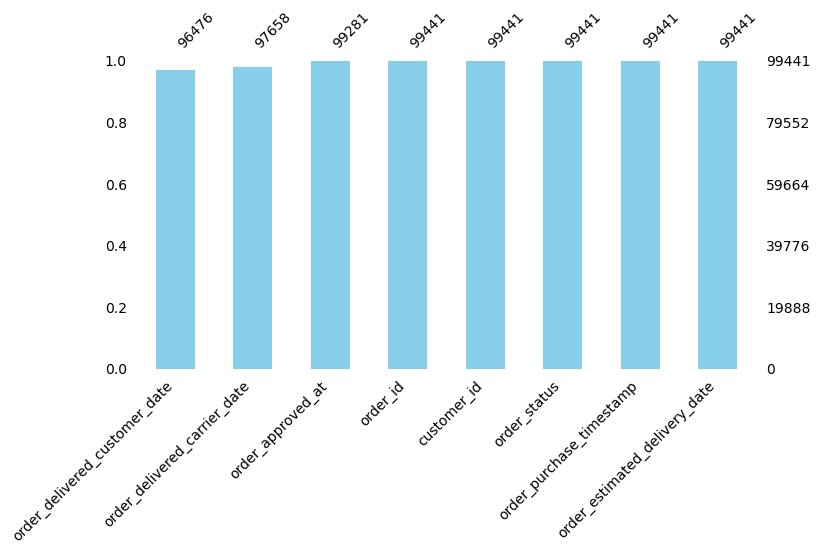

In [17]:
#check missing value with missingno bar
msno.bar(original_df_orders,color="skyblue", sort="ascending", figsize=(8,4), fontsize=10);

<Axes: >

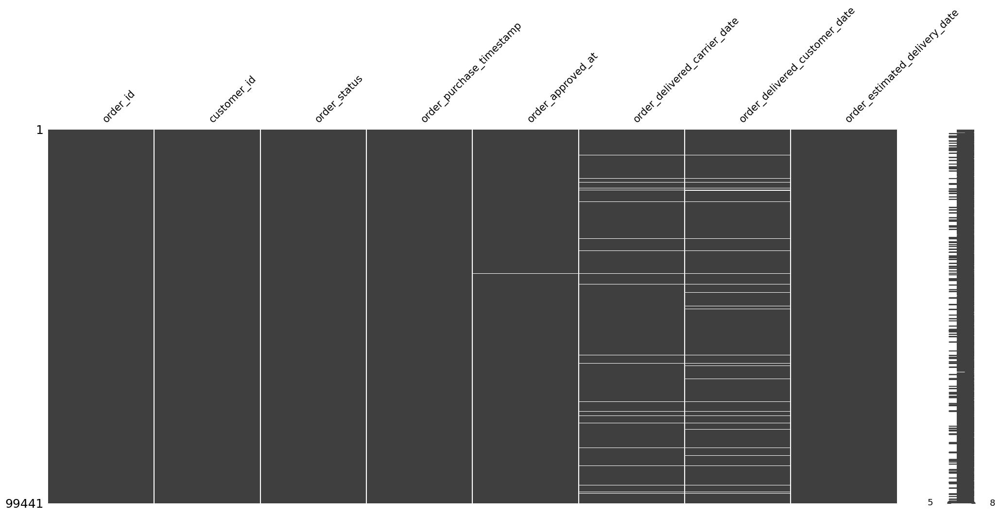

In [18]:
#check missing value using missingno matrix
msno.matrix(original_df_orders,fontsize=15)

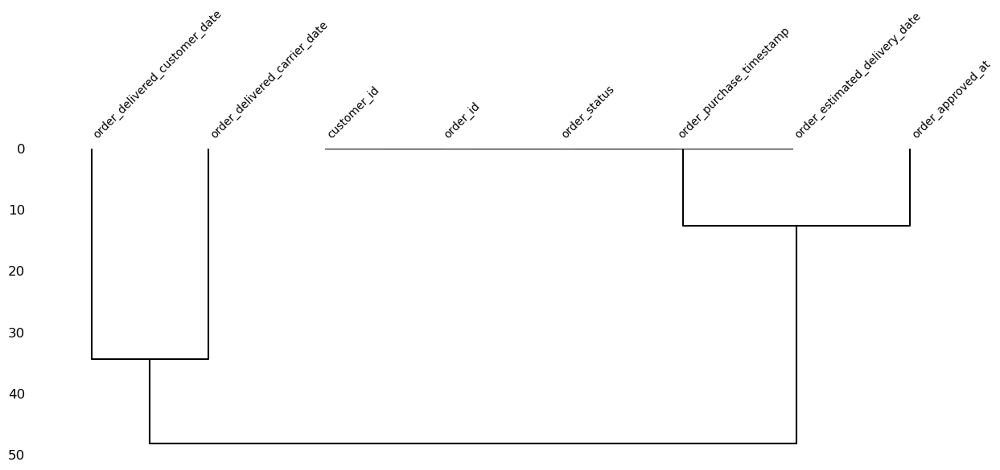

In [19]:
#check missing value using dendogram
msno.dendrogram(original_df_orders, figsize=(15,5), fontsize=10)
plt.show()

,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
order_purchase_timestamp,1.000000,0.995289,0.975137,0.952861,0.998347
order_approved_at,0.995289,1.000000,0.979738,0.957415,0.993646
order_delivered_carrier_date,0.975137,0.979738,1.000000,0.977539,0.974070
order_delivered_customer_date,0.952861,0.957415,0.977539,1.000000,0.952912
order_estimated_delivery_date,0.998347,0.993646,0.974070,0.952912,1.000000


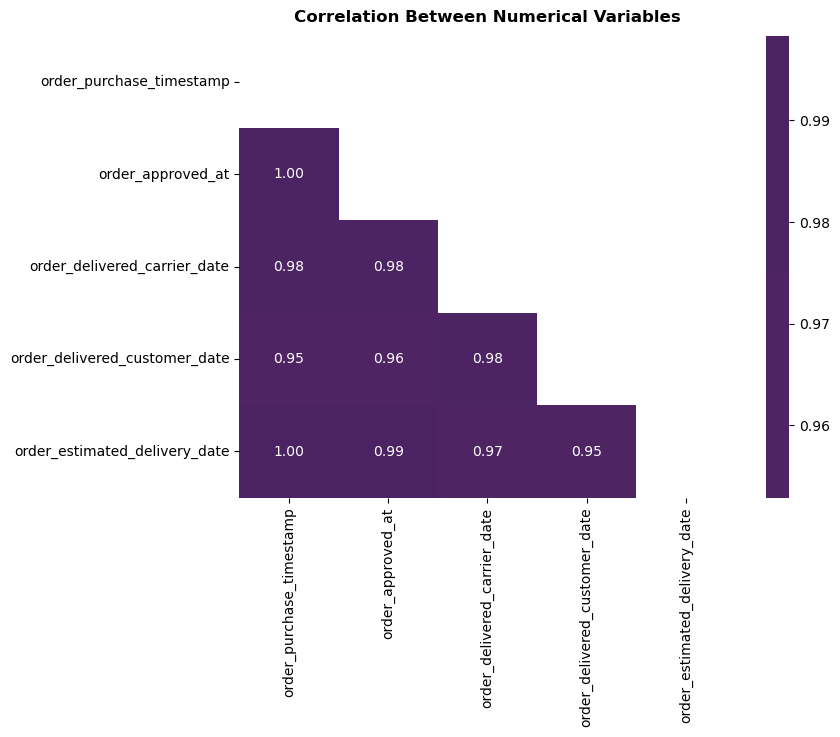

In [20]:
#correlation between numerical variables
onlynumeric_columns = original_df_orders.select_dtypes(include=['datetime64[ns]']).columns.to_list()
correlation_numercial = original_df_orders[onlynumeric_columns].corr(method = "spearman")
mtrx = np.triu(correlation_numercial)
display(correlation_numercial)

plt.figure(figsize = (8, 6))
sns.heatmap(
    data = correlation_numercial,
    annot = True,
    fmt = ".2f",
    cmap = "flare",
    center = 0,
    mask = mtrx
)

plt.title("Correlation Between Numerical Variables", size=12, pad=10, fontweight='bold')
plt.show()

#### Missing `order_approved_at`

In [21]:
# Filter rows where 'order_approved_at' is missing:
missing_approved = original_df_orders[original_df_orders['order_approved_at'].isna()]

# Display the rows:
print(missing_approved[['order_status', 'order_purchase_timestamp', 'order_approved_at',
                        'order_delivered_carrier_date', 'order_delivered_customer_date',
                        'order_estimated_delivery_date']].head(10))


     order_status order_purchase_timestamp order_approved_at order_delivered_carrier_date order_delivered_customer_date order_estimated_delivery_date
1130   canceled     2018-08-28 15:26:39           NaT                    NaT                           NaT                        2018-09-12         
1801   canceled     2018-09-20 13:54:16           NaT                    NaT                           NaT                        2018-10-17         
1868   canceled     2017-03-04 12:14:30           NaT                    NaT                           NaT                        2017-04-10         
2029   canceled     2018-08-29 16:27:49           NaT                    NaT                           NaT                        2018-09-13         
2161   canceled     2017-05-01 16:12:39           NaT                    NaT                           NaT                        2017-05-30         
3056   canceled     2016-10-04 19:41:32           NaT                    NaT                        

In [22]:
# Unique order_status values where order_approved_at is missing:
print(missing_approved['order_status'].unique())

['canceled' 'delivered' 'created']


In [23]:
# Delivered orders with missing order_approved_at:
delivered_missing = missing_approved[missing_approved['order_status'] == 'delivered']
display(delivered_missing)

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
5323,e04abd8149ef81b95221e88f6ed9ab6a,2127dc6603ac33544953ef05ec155771,delivered,2017-02-18 14:40:00,NaT,2017-02-23 12:04:47,2017-03-01 13:25:33,2017-03-17
16567,8a9adc69528e1001fc68dd0aaebbb54a,4c1ccc74e00993733742a3c786dc3c1f,delivered,2017-02-18 12:45:31,NaT,2017-02-23 09:01:52,2017-03-02 10:05:06,2017-03-21
19031,7013bcfc1c97fe719a7b5e05e61c12db,2941af76d38100e0f8740a374f1a5dc3,delivered,2017-02-18 13:29:47,NaT,2017-02-22 16:25:25,2017-03-01 08:07:38,2017-03-17
22663,5cf925b116421afa85ee25e99b4c34fb,29c35fc91fc13fb5073c8f30505d860d,delivered,2017-02-18 16:48:35,NaT,2017-02-22 11:23:10,2017-03-09 07:28:47,2017-03-31
23156,12a95a3c06dbaec84bcfb0e2da5d228a,1e101e0daffaddce8159d25a8e53f2b2,delivered,2017-02-17 13:05:55,NaT,2017-02-22 11:23:11,2017-03-02 11:09:19,2017-03-20
26800,c1d4211b3dae76144deccd6c74144a88,684cb238dc5b5d6366244e0e0776b450,delivered,2017-01-19 12:48:08,NaT,2017-01-25 14:56:50,2017-01-30 18:16:01,2017-03-01
38290,d69e5d356402adc8cf17e08b5033acfb,68d081753ad4fe22fc4d410a9eb1ca01,delivered,2017-02-19 01:28:47,NaT,2017-02-23 03:11:48,2017-03-02 03:41:58,2017-03-27
39334,d77031d6a3c8a52f019764e68f211c69,0bf35cac6cc7327065da879e2d90fae8,delivered,2017-02-18 11:04:19,NaT,2017-02-23 07:23:36,2017-03-02 16:15:23,2017-03-22
48401,7002a78c79c519ac54022d4f8a65e6e8,d5de688c321096d15508faae67a27051,delivered,2017-01-19 22:26:59,NaT,2017-01-27 11:08:05,2017-02-06 14:22:19,2017-03-16
61743,2eecb0d85f281280f79fa00f9cec1a95,a3d3c38e58b9d2dfb9207cab690b6310,delivered,2017-02-17 17:21:55,NaT,2017-02-22 11:42:51,2017-03-03 12:16:03,2017-03-20


These rows show orders marked as `'delivered'` with missing `order_approved_at` timestamps. This breaks the expected flow — purchase → approval → delivery. Possible reasons include:
- Approval event was not properly recorded.
- Snapshot timing issue—approval data not yet flushed when extracted.
- Legacy or early 2017 data may have incomplete approval tracking.

Because these orders are only missing `order_approved_at`, and the other delivery-related dates are normal, we will keep these rows and replace the missing values using KNN imputer

In [24]:
df_order_imp = original_df_orders.copy()

In [25]:
from sklearn.impute import KNNImputer

# Make a working copy
df_order_imp = original_df_orders.copy()

# List of datetime columns to use as predictors
datetime_cols = [
    'order_purchase_timestamp',
    'order_approved_at',
]

# Build a numeric dataframe: convert each Timestamp to seconds since epoch (float), keep NaN for missing
df_num = df_order_imp[datetime_cols].apply(
    lambda col: col.apply(lambda ts: ts.timestamp() if pd.notnull(ts) else np.nan)
)

# Impute with KNN
imputer = KNNImputer(n_neighbors=5)
imputed_arr = imputer.fit_transform(df_num)
imputed_df = pd.DataFrame(imputed_arr,
                          columns=datetime_cols,
                          index=df_order_imp.index)

# Back-convert only the originally missing order_approved_at entries
mask = df_order_imp['order_approved_at'].isna()

df_order_imp.loc[mask, 'order_approved_at'] = pd.to_datetime(
    imputed_df.loc[mask, 'order_approved_at'], unit='s'
)

df_order_imp['order_approved_at'] = pd.to_datetime(
    df_order_imp['order_approved_at'], errors='coerce')

print("Missing before:", original_df_orders['order_approved_at'].isna().sum())
print("Missing after: ", df_order_imp['order_approved_at'].isna().sum())

Missing before: 160
Missing after:  0


In [26]:
# First, identify the orders where order_approved_at is missing
delivered_missing_order_ids = delivered_missing['order_id'].tolist()

# Create a new DataFrame with the imputed order_approved_at values
df_imputed_approved = df_order_imp[df_order_imp['order_id'].isin(delivered_missing_order_ids)]

# Display the orders before and after imputation
comparison_df = pd.DataFrame({
    'order_id': delivered_missing['order_id'],
    'purchase_timestamp': delivered_missing['order_purchase_timestamp'],
    'original_approved_at': delivered_missing['order_approved_at'],
    'imputed_approved_at': df_imputed_approved['order_approved_at']
})

print(df_order_imp['order_approved_at'].apply(type).value_counts())
# every row should show <class 'pandas._libs.tslibs.timestamps.Timestamp'>

# Add delivery dates for context
comparison_df['carrier_date'] = delivered_missing['order_delivered_carrier_date']
comparison_df['customer_date'] = delivered_missing['order_delivered_customer_date']

# Calculate time differences after imputation (in hours)
comparison_df['hours_purchase_to_approval'] = (comparison_df['imputed_approved_at'] - 
                                             comparison_df['purchase_timestamp']).dt.total_seconds() / 3600

# Calculate time differences from approval to delivery (in days)
comparison_df['days_approval_to_carrier'] = (comparison_df['carrier_date'] - 
                                           comparison_df['imputed_approved_at']).dt.total_seconds() / (3600*24)

# Display the results
print(f"Imputed approval times for {len(comparison_df)} orders with missing approval dates:")
display(comparison_df[['order_id', 'purchase_timestamp', 'imputed_approved_at', 
                      'hours_purchase_to_approval', 'days_approval_to_carrier']].head(10))

order_approved_at
<class 'pandas._libs.tslibs.timestamps.Timestamp'>    99441
Name: count, dtype: int64
Imputed approval times for 14 orders with missing approval dates:


,order_id,purchase_timestamp,imputed_approved_at,hours_purchase_to_approval,days_approval_to_carrier
5323,e04abd8149ef81b95221e88f6ed9ab6a,2017-02-18 14:40:00,2017-02-18 14:51:44.400000095,0.195667,4.884058
16567,8a9adc69528e1001fc68dd0aaebbb54a,2017-02-18 12:45:31,2017-02-19 02:58:00.799999952,14.208278,4.252676
19031,7013bcfc1c97fe719a7b5e05e61c12db,2017-02-18 13:29:47,2017-02-19 02:10:39.000000000,12.681111,3.593588
22663,5cf925b116421afa85ee25e99b4c34fb,2017-02-18 16:48:35,2017-02-18 17:16:42.200000048,0.468667,3.754488
23156,12a95a3c06dbaec84bcfb0e2da5d228a,2017-02-17 13:05:55,2017-02-17 16:11:57.599999905,3.100722,4.799461
26800,c1d4211b3dae76144deccd6c74144a88,2017-01-19 12:48:08,2017-01-20 01:49:50.400000095,13.028444,5.546523
38290,d69e5d356402adc8cf17e08b5033acfb,2017-02-19 01:28:47,2017-02-21 03:23:34.200000048,49.913111,1.991826
39334,d77031d6a3c8a52f019764e68f211c69,2017-02-18 11:04:19,2017-02-18 11:33:14.799999952,0.482167,4.826634
48401,7002a78c79c519ac54022d4f8a65e6e8,2017-01-19 22:26:59,2017-01-20 10:07:47.799999952,11.680222,7.041866
61743,2eecb0d85f281280f79fa00f9cec1a95,2017-02-17 17:21:55,2017-02-17 17:47:28.799999952,0.426056,4.746785


In [ ]:
# 1) build a mapping from order_id → imputed approved timestamp
imp_map = df_order_imp.set_index('order_id')['order_approved_at']

# 2) locate the rows in delivered-subset that still lack approval times
mask = df_orders_delivered['order_approved_at'].isna()

# 3) use .map() to fill only those missing spots
df_orders_delivered.loc[mask, 'order_approved_at'] = (
    df_orders_delivered.loc[mask, 'order_id'].map(imp_map)
)

# now check
print("Missing in delivered before:", mask.sum())
print("Missing in delivered after: ", df_orders_delivered['order_approved_at'].isna().sum())

Missing in delivered before: 14
Missing in delivered after:  0


#### Missing `order_delivered_customer_date`

In [28]:
# Delivered orders but missing order_delivered_customer_date:
missing_delivery = df_orders_delivered[df_orders_delivered['order_delivered_customer_date'].isna()]
display(missing_delivery)

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
3002,2d1e2d5bf4dc7227b3bfebb81328c15f,ec05a6d8558c6455f0cbbd8a420ad34f,delivered,2017-11-28 17:44:07,2017-11-28 17:56:40,2017-11-30 18:12:23,NaT,2017-12-18
20618,f5dd62b788049ad9fc0526e3ad11a097,5e89028e024b381dc84a13a3570decb4,delivered,2018-06-20 06:58:43,2018-06-20 07:19:05,2018-06-25 08:05:00,NaT,2018-07-16
43834,2ebdfc4f15f23b91474edf87475f108e,29f0540231702fda0cfdee0a310f11aa,delivered,2018-07-01 17:05:11,2018-07-01 17:15:12,2018-07-03 13:57:00,NaT,2018-07-30
79263,e69f75a717d64fc5ecdfae42b2e8e086,cfda40ca8dd0a5d486a9635b611b398a,delivered,2018-07-01 22:05:55,2018-07-01 22:15:14,2018-07-03 13:57:00,NaT,2018-07-30
82868,0d3268bad9b086af767785e3f0fc0133,4f1d63d35fb7c8999853b2699f5c7649,delivered,2018-07-01 21:14:02,2018-07-01 21:29:54,2018-07-03 09:28:00,NaT,2018-07-24
92643,2d858f451373b04fb5c984a1cc2defaf,e08caf668d499a6d643dafd7c5cc498a,delivered,2017-05-25 23:22:43,2017-05-25 23:30:16,NaT,NaT,2017-06-23
97647,ab7c89dc1bf4a1ead9d6ec1ec8968a84,dd1b84a7286eb4524d52af4256c0ba24,delivered,2018-06-08 12:09:39,2018-06-08 12:36:39,2018-06-12 14:10:00,NaT,2018-06-26
98038,20edc82cf5400ce95e1afacc25798b31,28c37425f1127d887d7337f284080a0f,delivered,2018-06-27 16:09:12,2018-06-27 16:29:30,2018-07-03 19:26:00,NaT,2018-07-19


Handling Missing order_delivered_customer_date in Delivered Orders

Found 8 orders with status "delivered" but missing the actual delivery date.

These records cannot be used to calculate delivery performance or lateness, so they were dropped from the analysis.

Impact: This step ensures that only complete, analyzable delivery events are used, avoiding bias or errors in our delivery metrics.

We did not impute missing delivered dates because there is no reliable, business-justified way to infer them. For operational KPIs, only factual delivery events are included. Since it’s less than 0.01% of orders (8 out of 96k rows), dropping them protects metric accuracy and business trust, following industry best practice

In [29]:
# Drop rows with missing order_delivered_customer_date:
df_orders_delivered = df_orders_delivered[df_orders_delivered['order_delivered_customer_date'].notna()]

#### Missing `order_delivered_carrier_date`

In [30]:
# Delivered orders but missing order_delivered_carrier_date:
missing_carrier = df_orders_delivered[df_orders_delivered['order_delivered_carrier_date'].isna()]
display(missing_carrier)

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
73222,2aa91108853cecb43c84a5dc5b277475,afeb16c7f46396c0ed54acb45ccaaa40,delivered,2017-09-29 08:52:58,2017-09-29 09:07:16,NaT,2017-11-20 19:44:47,2017-11-14


For delivery performance from the customer perspective, this order is valid, we know when it was delivered. We can't remove this row since it provides valuable example of a delivery performance, especially since this particular order was delivered late.

However, for seller-specific lateness KPIs (e.g. how often this seller is late to deliver the items to Olist carrier), we can’t fairly evaluate this seller, because we have no record of when they handed the order off. Imputing that value would introduce unjustified assumptions and risk biasing our seller performance insights.

So **we keep this row** for customer delivery metrics, but exclude it from seller-side performance analysis **without doing any imputation**.

In [31]:
order_id = '2aa91108853cecb43c84a5dc5b277475'

purchase_ts = df_orders_delivered.loc[
    df_orders_delivered['order_id']==order_id, 
    'order_purchase_timestamp'
].iat[0]
seller = original_df_order_items.loc[
    original_df_order_items['order_id']==order_id, 
    'seller_id'
].iat[0]

hist = (
    df_orders_delivered[df_orders_delivered['order_delivered_carrier_date'].notna()]
      .merge(original_df_order_items[['order_id','seller_id']], on='order_id')
)

seller_delta = (
    (hist.loc[hist['seller_id']==seller, 'order_delivered_carrier_date']
     - hist.loc[hist['seller_id']==seller, 'order_approved_at'])
    .median()
)

df_orders_delivered.loc[
    df_orders_delivered['order_id']==order_id, 
    'order_delivered_carrier_date'
] = purchase_ts + seller_delta

In [32]:
df_orders_delivered[df_orders_delivered['order_id']==order_id]

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
73222,2aa91108853cecb43c84a5dc5b277475,afeb16c7f46396c0ed54acb45ccaaa40,delivered,2017-09-29 08:52:58,2017-09-29 09:07:16,2017-10-02 15:05:31.500,2017-11-20 19:44:47,2017-11-14


In [33]:
df_orders_delivered.isna().sum()

order_id                         0
customer_id                      0
order_status                     0
order_purchase_timestamp         0
order_approved_at                0
order_delivered_carrier_date     0
order_delivered_customer_date    0
order_estimated_delivery_date    0
dtype: int64

### Handling Illogical Rows

| Edge Case                                                   | Why It Matters                                      | How to Detect / Handle                                                                                                                          |
| ----------------------------------------------------------- | --------------------------------------------------- | ----------------------------------------------------------------------------------------------------------------------------------------------- |
| **Delivered before approved**   done                            | Negative “handoff” period; nonsense.                | `mask = df['order_delivered_carrier_date'] < df['order_approved_at']`<br>Inspect these rows. |
| **Approved before purchase**  done                              | Approval shouldn’t precede purchase.                | `mask = df['order_approved_at'] < df['order_purchase_timestamp']`<br>Usually safe to drop—very likely ETL error.                                |
| **Carrier date before purchase**                            | Seller can’t hand off before sale.                  | `mask = df['order_delivered_carrier_date'] < df['order_purchase_timestamp']`                                                                    |
| **Customer delivery before carrier** done                       | Delivery can’t happen before handoff.               | `mask = df['order_delivered_customer_date'] < df['order_delivered_carrier_date']`                                                               |
| **Estimated date before purchase**                          | Bad forecast logic or data error.                   | `mask = df['order_estimated_delivery_date'] < df['order_purchase_timestamp']`                                                                   |

In [34]:
df_orders_delivered

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26
...,...,...,...,...,...,...,...,...
99436,9c5dedf39a927c1b2549525ed64a053c,39bd1228ee8140590ac3aca26f2dfe00,delivered,2017-03-09 09:54:05,2017-03-09 09:54:05,2017-03-10 11:18:03,2017-03-17 15:08:01,2017-03-28
99437,63943bddc261676b46f01ca7ac2f7bd8,1fca14ff2861355f6e5f14306ff977a7,delivered,2018-02-06 12:58:58,2018-02-06 13:10:37,2018-02-07 23:22:42,2018-02-28 17:37:56,2018-03-02
99438,83c1379a015df1e13d02aae0204711ab,1aa71eb042121263aafbe80c1b562c9c,delivered,2017-08-27 14:46:43,2017-08-27 15:04:16,2017-08-28 20:52:26,2017-09-21 11:24:17,2017-09-27
99439,11c177c8e97725db2631073c19f07b62,b331b74b18dc79bcdf6532d51e1637c1,delivered,2018-01-08 21:28:27,2018-01-08 21:36:21,2018-01-12 15:35:03,2018-01-25 23:32:54,2018-02-15


In [35]:
# List out the “should-be-before” relationships
date_pairs = [
    ('order_purchase_timestamp',     'order_approved_at'),
    ('order_purchase_timestamp',     'order_delivered_carrier_date'),
    ('order_purchase_timestamp',     'order_estimated_delivery_date'),
    ('order_purchase_timestamp',     'order_delivered_customer_date'),
    ('order_approved_at',            'order_delivered_carrier_date'),
    ('order_approved_at',            'order_estimated_delivery_date'),
    ('order_approved_at',            'order_delivered_customer_date'),
    ('order_delivered_carrier_date', 'order_delivered_customer_date'),
]

In [36]:
anomaly_masks = {}

for earlier, later in date_pairs:
    mask_name = f"{earlier}_before_{later}"
    anomaly_masks[mask_name] = df_orders_delivered[later] < df_orders_delivered[earlier]

In [ ]:
# Combine all the masks with OR
combined_mask = pd.concat(anomaly_masks.values(), axis=1).any(axis=1)

# Show which rule(s) each bad row breaks
violations = pd.DataFrame(anomaly_masks).loc[combined_mask]
violations['order_id'] = df_orders_delivered.loc[combined_mask, 'order_id'].values

display(violations)

,order_purchase_timestamp_before_order_approved_at,order_purchase_timestamp_before_order_delivered_carrier_date,order_purchase_timestamp_before_order_estimated_delivery_date,order_purchase_timestamp_before_order_delivered_customer_date,order_approved_at_before_order_delivered_carrier_date,order_approved_at_before_order_estimated_delivery_date,order_approved_at_before_order_delivered_customer_date,order_delivered_carrier_date_before_order_delivered_customer_date,order_id
15,False,False,False,False,True,False,False,False,dcb36b511fcac050b97cd5c05de84dc3
64,False,False,False,False,True,False,False,False,688052146432ef8253587b930b01a06d
199,False,False,False,False,True,False,True,False,58d4c4747ee059eeeb865b349b41f53a
210,False,False,False,False,True,False,False,False,412fccb2b44a99b36714bca3fef8ad7b
415,False,False,False,False,True,False,False,False,56a4ac10a4a8f2ba7693523bb439eede
...,...,...,...,...,...,...,...,...,...
99091,False,False,False,False,True,False,False,False,240ead1a7284667e0ec71d01f80e4d5e
99230,False,True,False,False,True,False,False,False,78008d03bd8ef7fcf1568728b316553c
99266,False,False,False,False,True,False,False,False,76a948cd55bf22799753720d4545dd2d
99377,False,False,False,False,True,False,False,False,a6bd1f93b7ff72cc348ca07f38ec4bee


"True" here means that the rule is broken. If an order don't have a temporal inconsistency, then it should have a "False" value on every rule column here

In [38]:
violations.drop(columns='order_id').value_counts()

order_purchase_timestamp_before_order_approved_at  order_purchase_timestamp_before_order_delivered_carrier_date  order_purchase_timestamp_before_order_estimated_delivery_date  order_purchase_timestamp_before_order_delivered_customer_date  order_approved_at_before_order_delivered_carrier_date  order_approved_at_before_order_estimated_delivery_date  order_approved_at_before_order_delivered_customer_date  order_delivered_carrier_date_before_order_delivered_customer_date
False                                              False                                                         False                                                          False                                                          True                                                   False                                                   False                                                   False                                                                1124
                                                

#### Temporal Consistency Checks & Anomaly Interpretation

To ensure reliable and logical delivery performance metrics, we ran a series of temporal consistency checks on all key timestamp columns in the `orders` dataset. These checks validate that each stage in the order lifecycle follows a logical chronological order, such as:

* **Purchase happens before approval**
* **Approval before seller handoff**
* **Seller handoff before customer delivery**
* **Order events occur before estimated delivery date**

#### **Findings**

Our analysis revealed several types of anomalies, summarized below:

* **1124 orders:** Handoff to Olist (carrier date) is recorded **before** the order was even approved.
  *→ This is impossible, as Olist must approve the order before the seller can hand it off.*
* **165 orders:** Handoff date is **before both purchase and approval dates**.
  *→ This is even less plausible, as the seller cannot ship an order that has not been placed or approved.*
* **56 orders:** Both the handoff and final delivery dates occur **before order approval**.
  *→ Again, this breaks the required sequence of events.*
* **23 orders:** The package is shown as delivered to the customer **before it was handed to the carrier**.
  *→ The product cannot be received by the customer before it has left the seller.*
* **5 orders:** Multiple stages (handoff, estimated delivery, final delivery) occur **before order approval**.
  *→ These are extreme anomalies indicating deeper data integrity issues.*
* **1 order:** Estimated delivery date is **before the order was even approved**.
  *→ This likely reflects a forecasting or data entry error.*

In total, these anomalies represent about **1.4% of delivered orders**. Such issues almost certainly result from data entry mistakes or ETL errors and could severely bias our delivery performance analysis if left unaddressed.

In [39]:
import numpy as np

# Remove the order_id column to focus on anomalies only
anomaly_cols = [col for col in violations.columns if col != 'order_id']

# Find all unique anomaly combinations (as boolean tuples)
unique_anomaly_cases = violations[anomaly_cols].drop_duplicates()

# Create a dict of DataFrames: each combination -> DataFrame of those rows
anomaly_case_dfs = {}
for idx, unique_case in unique_anomaly_cases.iterrows():
    mask = np.all(violations[anomaly_cols].values == unique_case.values, axis=1)
    # OR, with DataFrame logic:
    # mask = (violations[anomaly_cols] == unique_case.values).all(axis=1)
    key = tuple(unique_case.values)
    anomaly_case_dfs[key] = violations.loc[mask].copy()

# Example: Show all keys
for k, df_case in anomaly_case_dfs.items():
    print(f"Anomaly case {k}: {df_case.shape[0]} rows")
    # display(df_case.head())  # uncomment to view sample rows

Anomaly case (False, False, False, False, True, False, False, False): 1124 rows
Anomaly case (False, False, False, False, True, False, True, False): 56 rows
Anomaly case (False, True, False, False, True, False, False, False): 165 rows
Anomaly case (False, False, False, False, False, False, False, True): 23 rows
Anomaly case (False, False, False, False, True, True, True, False): 5 rows
Anomaly case (False, False, False, False, False, True, False, False): 1 rows


### Actions Taken

#### First Case: Handoff to Olist before Order Approval

**1132 orders:** Handoff to Olist (carrier date) is recorded **before** the order was even approved. Example:

In [40]:
first_case = list(anomaly_case_dfs.keys())[0]
df_first_case = anomaly_case_dfs[first_case]
display(df_first_case)

,order_purchase_timestamp_before_order_approved_at,order_purchase_timestamp_before_order_delivered_carrier_date,order_purchase_timestamp_before_order_estimated_delivery_date,order_purchase_timestamp_before_order_delivered_customer_date,order_approved_at_before_order_delivered_carrier_date,order_approved_at_before_order_estimated_delivery_date,order_approved_at_before_order_delivered_customer_date,order_delivered_carrier_date_before_order_delivered_customer_date,order_id
15,False,False,False,False,True,False,False,False,dcb36b511fcac050b97cd5c05de84dc3
64,False,False,False,False,True,False,False,False,688052146432ef8253587b930b01a06d
210,False,False,False,False,True,False,False,False,412fccb2b44a99b36714bca3fef8ad7b
415,False,False,False,False,True,False,False,False,56a4ac10a4a8f2ba7693523bb439eede
481,False,False,False,False,True,False,False,False,32e4fa9bb468884309b58b9348de70c3
...,...,...,...,...,...,...,...,...,...
99086,False,False,False,False,True,False,False,False,bb8871a92af73ddadeac0531a0787131
99091,False,False,False,False,True,False,False,False,240ead1a7284667e0ec71d01f80e4d5e
99266,False,False,False,False,True,False,False,False,76a948cd55bf22799753720d4545dd2d
99377,False,False,False,False,True,False,False,False,a6bd1f93b7ff72cc348ca07f38ec4bee


In [41]:
# 1. Get the order_ids from anomaly case
anomaly_order_ids = df_first_case['order_id'].unique()

# 2. Use to subset
df_first_case_orders = df_orders_delivered[df_orders_delivered['order_id'].isin(anomaly_order_ids)].copy()

display(df_first_case_orders)

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
15,dcb36b511fcac050b97cd5c05de84dc3,3b6828a50ffe546942b7a473d70ac0fc,delivered,2018-06-07 19:03:12,2018-06-12 23:31:02,2018-06-11 14:54:00,2018-06-21 15:34:32,2018-07-04
64,688052146432ef8253587b930b01a06d,81e08b08e5ed4472008030d70327c71f,delivered,2018-04-22 08:48:13,2018-04-24 18:25:22,2018-04-23 19:19:14,2018-04-24 19:31:58,2018-05-15
210,412fccb2b44a99b36714bca3fef8ad7b,c6865c523687cb3f235aa599afef1710,delivered,2018-07-22 22:30:05,2018-07-23 12:31:53,2018-07-23 12:24:00,2018-07-24 19:26:42,2018-07-31
415,56a4ac10a4a8f2ba7693523bb439eede,78438ba6ace7d2cb023dbbc81b083562,delivered,2018-07-22 13:04:47,2018-07-27 23:31:09,2018-07-24 14:03:00,2018-07-28 00:05:39,2018-08-06
481,32e4fa9bb468884309b58b9348de70c3,e54367d4b00c5cb76d2dfe71b9bdb89c,delivered,2018-07-04 16:49:21,2018-07-05 16:33:06,2018-07-05 14:50:00,2018-07-07 14:41:18,2018-07-23
...,...,...,...,...,...,...,...,...
99086,bb8871a92af73ddadeac0531a0787131,ce757220d9f01ba4887f6bf76ced6a1c,delivered,2018-07-31 09:16:57,2018-08-01 16:31:37,2018-08-01 15:03:00,2018-08-08 01:03:27,2018-08-22
99091,240ead1a7284667e0ec71d01f80e4d5e,fcdd7556401aaa1c980f8b67a69f95dc,delivered,2018-07-02 16:30:02,2018-07-05 16:17:59,2018-07-05 14:11:00,2018-07-10 23:21:47,2018-07-24
99266,76a948cd55bf22799753720d4545dd2d,3f20a07b28aa252d0502fe7f7eb030a9,delivered,2018-01-30 02:41:30,2018-02-04 23:31:46,2018-01-31 18:11:58,2018-03-18 20:08:50,2018-03-02
99377,a6bd1f93b7ff72cc348ca07f38ec4bee,6d63fa86bd2f62908ad328325799152f,delivered,2018-04-20 17:28:40,2018-04-24 19:26:10,2018-04-23 17:18:40,2018-04-28 17:38:42,2018-05-15


In [42]:
# Calculate the time difference between order approval and purchase
df_orders_delivered['approval_time_minutes'] = (
    df_orders_delivered['order_approved_at'] - 
    df_orders_delivered['order_purchase_timestamp']
).dt.total_seconds() / 60  # Convert to minutes

# Get descriptive statistics
approval_time_stats = df_orders_delivered['approval_time_minutes'].describe()

# Display additional percentiles for a more comprehensive view
percentiles = [0.01, 0.05, 0.1, 0.25, 0.5, 0.75, 0.9, 0.95, 0.99]
approval_time_percentiles = df_orders_delivered['approval_time_minutes'].quantile(percentiles)

# Display the results
print("Descriptive Statistics for Order Approval Time (in minutes):")
display(approval_time_stats)

print("\nPercentiles of Order Approval Time (in minutes):")
for p, val in zip(percentiles, approval_time_percentiles):
    print(f"{int(p*100)}th percentile: {val:.2f} minutes")

Descriptive Statistics for Order Approval Time (in minutes):


count    96470.000000
mean       616.641979
std       1232.110244
min          0.000000
25%         12.916667
50%         20.600000
75%        870.858333
max      44486.616667
Name: approval_time_minutes, dtype: float64


Percentiles of Order Approval Time (in minutes):
1th percentile: 0.00 minutes
5th percentile: 8.65 minutes
10th percentile: 10.10 minutes
25th percentile: 12.92 minutes
50th percentile: 20.60 minutes
75th percentile: 870.86 minutes
90th percentile: 2075.62 minutes
95th percentile: 2895.79 minutes
99th percentile: 5386.98 minutes


In [43]:
# Calculate the time difference between order approval and purchase
df_first_case_orders['approval_time_minutes'] = (
    df_first_case_orders['order_approved_at'] - 
    df_first_case_orders['order_purchase_timestamp']
).dt.total_seconds() / 60  # Convert to minutes

# Get descriptive statistics
approval_time_stats = df_first_case_orders['approval_time_minutes'].describe()

# Display additional percentiles for a more comprehensive view
percentiles = [0.01, 0.05, 0.1, 0.25, 0.5, 0.75, 0.9, 0.95, 0.99]
approval_time_percentiles = df_first_case_orders['approval_time_minutes'].quantile(percentiles)

# Display the results
print("Descriptive Statistics for Order Approval Time (in minutes):")
display(approval_time_stats)

print("\nPercentiles of Order Approval Time (in minutes):")
for p, val in zip(percentiles, approval_time_percentiles):
    print(f"{int(p*100)}th percentile: {val:.2f} minutes")

Descriptive Statistics for Order Approval Time (in minutes):


count     1124.000000
mean      3451.872138
std       2481.925893
min         12.916667
25%       1585.516667
50%       2928.400000
75%       4752.095833
max      17477.483333
Name: approval_time_minutes, dtype: float64


Percentiles of Order Approval Time (in minutes):
1th percentile: 18.75 minutes
5th percentile: 90.93 minutes
10th percentile: 548.26 minutes
25th percentile: 1585.52 minutes
50th percentile: 2928.40 minutes
75th percentile: 4752.10 minutes
90th percentile: 7347.11 minutes
95th percentile: 7766.90 minutes
99th percentile: 9067.18 minutes


For the first anomaly case, it seems like the approval date are not normal. Normally, Olist gets to approve an order in 20-30 minutes. However, orders belonging to this anomaly mostly take > 90 minutes to approve, with half of them needing 3000 minutes (50 hours!) to get approved. This signals either data entry errors or system errors that lead to a late approval datetime entry, even though the order is supposedly already approved and notified to the seller.

So, this first anomaly case does not call for any removal, and we will keep these rows.

#### Second Case: Handoff to Olist before both Purchase & Approval is made

In [44]:
second_case = list(anomaly_case_dfs.keys())[2]
df_second_case = anomaly_case_dfs[second_case]
anomaly_order_ids = df_second_case['order_id'].unique()
df_second_case_orders = df_orders_delivered[df_orders_delivered['order_id'].isin(anomaly_order_ids)].copy()
display(df_second_case_orders.shape)
display(df_second_case_orders.head(10))

(165, 9)

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,approval_time_minutes
615,b9afddbdcfadc9a87b41a83271c3e888,85c6af75161b8b2b1af98e82b5a6a5a5,delivered,2018-08-16 13:50:48,2018-08-16 14:05:13,2018-08-16 13:27:00,2018-08-24 14:58:37,2018-09-04,14.416667
1111,ad133696906f6a78826daa0911b7daec,e6f5b234bb0d847f10eebd70130c5d49,delivered,2018-06-15 15:41:22,2018-06-15 16:19:23,2018-06-15 14:52:00,2018-06-22 18:09:37,2018-07-18,38.016667
1329,74e033208dc13a7b8127eb8e73d09b76,72fcbb1145f2889eddcba6d6c1d6c090,delivered,2018-05-02 10:48:44,2018-05-02 11:13:45,2018-05-02 09:49:00,2018-05-07 23:06:36,2018-05-29,25.016667
1372,a6b58794fd2ba533359a76c08df576e3,ccd8e3459ad58ae538c9d2cf35532ba4,delivered,2018-05-14 15:18:23,2018-05-14 15:33:35,2018-05-14 13:46:00,2018-05-19 19:33:32,2018-06-08,15.200000
1864,5792e0b1c8c8a2bf53af468c9a422c88,5c427f06e7fcf902e309743516e2c580,delivered,2018-07-26 13:25:14,2018-07-26 13:35:14,2018-07-26 12:42:00,2018-07-30 14:45:02,2018-08-09,10.000000
2760,c3eb293fd154223498b6551a728203e8,1701ed88b1e8cb21051660d70d11d038,delivered,2018-07-19 14:06:04,2018-07-19 14:22:51,2018-07-19 13:49:00,2018-07-24 19:35:36,2018-08-06,16.783333
3473,b0c2a7d04b165525254254a728c50a4e,76a8a3092e48bba0826495241903e450,delivered,2018-06-07 13:28:30,2018-06-07 13:57:22,2018-06-07 13:22:00,2018-06-21 17:36:43,2018-07-04,28.866667
3661,2033a4586b5bec3229ebc1675a8ae092,0efc1f5e8675901683fae0ea8fdf3feb,delivered,2018-06-12 10:10:25,2018-06-12 10:39:59,2018-06-12 10:09:00,2018-06-19 14:08:27,2018-07-19,29.566667
4114,08adcddad19d3acf37d1fa01cb9ded1e,94c2f45091985c47b4c4fb301113f0a4,delivered,2018-06-27 11:16:44,2018-06-27 11:30:56,2018-06-27 10:57:00,2018-06-29 17:39:53,2018-07-18,14.200000
4256,4e157a36ea9cf89bde6fff57a780b525,24970f1325070d89a1c42dd450b09a8a,delivered,2018-08-24 14:37:50,2018-08-24 14:50:14,2018-08-24 12:43:00,2018-08-30 20:47:26,2018-09-10,12.400000


In [45]:
# Calculate time differences in minutes
df_second_case_orders['carrier_vs_purchase_minutes'] = (
    df_second_case_orders['order_delivered_carrier_date'] - 
    df_second_case_orders['order_purchase_timestamp']
).dt.total_seconds() / 60  # Convert to minutes

df_second_case_orders['carrier_vs_approval_minutes'] = (
    df_second_case_orders['order_delivered_carrier_date'] - 
    df_second_case_orders['order_approved_at']
).dt.total_seconds() / 60  # Convert to minutes

# Get descriptive statistics
carrier_vs_purchase_stats = df_second_case_orders['carrier_vs_purchase_minutes'].describe()
carrier_vs_approval_stats = df_second_case_orders['carrier_vs_approval_minutes'].describe()

# Display the results
print("Time between Purchase and Carrier Handoff (in minutes):")
display(carrier_vs_purchase_stats)

print("\nTime between Approval and Carrier Handoff (in minutes):")
display(carrier_vs_approval_stats)

Time between Purchase and Carrier Handoff (in minutes):


count       165.000000
mean      -1571.430303
std       19193.324518
min     -246545.883333
25%         -60.700000
50%         -34.866667
75%         -14.050000
max          -0.400000
Name: carrier_vs_purchase_minutes, dtype: float64


Time between Approval and Carrier Handoff (in minutes):


count       165.000000
mean      -1685.270707
std       19189.601255
min     -246555.366667
25%         -91.533333
50%         -60.266667
75%         -38.483333
max         -10.266667
Name: carrier_vs_approval_minutes, dtype: float64

During temporal consistency checks, we identified **165 orders** where the recorded **carrier handoff timestamp occurred before the purchase timestamp**. In all of these cases, the handoff time was also earlier than the approval time.

**Why This Is a Problem**

This ordering violates the fundamental logic of the order lifecycle:

* A seller **cannot hand off a package** before a customer has placed the order.
* Even small differences (e.g., 10–60 minutes) are **logically impossible**, not just unusual.
* While other timestamp inconsistencies (such as approval occurring slightly after handoff) can be attributed to harmless system clock skew, this specific anomaly implies a sequence of events that could not happen in the real world.

**Data Observations**

* All 165 rows show **handoff happening before purchase and approval**, with time gaps ranging from **a few minutes to over 170 days**.
* These rows represent **only 0.17%** of all delivered orders.

**Decision**

To maintain data integrity and ensure trustworthy delivery performance analysis:

* We **dropped all 165 rows** with `order_delivered_carrier_date < order_purchase_timestamp`.
* This prevents the inclusion of logically invalid transactions that could undermine our credibility.
* The removal has **negligible impact on KPIs** and improves the overall consistency of the dataset.

**Conclusion**

While system timestamp misalignments can sometimes be tolerated, we determined that any case where a product is shipped **before it was ordered** falls outside acceptable error bounds.

In [46]:
# Drop rows where handoff happened before purchase
# Get the order_ids from the second anomaly case
anomaly_order_ids = df_second_case['order_id'].unique()

# Drop these rows from our delivered orders dataset
df_orders_delivered_clean = df_orders_delivered[~df_orders_delivered['order_id'].isin(anomaly_order_ids)].copy()

# Show the number of rows before and after cleaning
print(f"Original number of delivered orders: {df_orders_delivered.shape[0]}")
print(f"Number of rows dropped (handoff before purchase): {len(anomaly_order_ids)}")

# Verify that the problematic cases are gone
mask_handoff_before_purchase = (
    df_orders_delivered_clean['order_delivered_carrier_date'] < 
    df_orders_delivered_clean['order_purchase_timestamp']
)

print(f"\nRemaining rows with handoff before purchase: {mask_handoff_before_purchase.sum()}")

Original number of delivered orders: 96470
Number of rows dropped (handoff before purchase): 165

Remaining rows with handoff before purchase: 0


#### Third Case: Order Approval is made after Handoff & Delivery

In [47]:
third_case = list(anomaly_case_dfs.keys())[1]
df_third_case = anomaly_case_dfs[third_case]
anomaly_order_ids = df_third_case['order_id'].unique()
df_third_case_orders = df_orders_delivered[df_orders_delivered['order_id'].isin(anomaly_order_ids)].copy()
display(df_third_case_orders.shape)
display(df_third_case_orders.head(10))

(56, 9)

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,approval_time_minutes
199,58d4c4747ee059eeeb865b349b41f53a,1755fad7863475346bc6c3773fe055d3,delivered,2018-07-21 12:49:32,2018-07-26 23:31:53,2018-07-24 12:57:00,2018-07-25 23:58:19,2018-07-31,7842.350000
483,4df92d82d79c3b52c7138679fa9b07fc,ba0660bf3fffe505ee892e153a2fbd49,delivered,2018-07-24 11:32:11,2018-07-29 23:30:52,2018-07-26 14:46:00,2018-07-27 18:55:57,2018-08-06,7918.683333
1986,6e57e23ecac1ae881286657694444267,2dda54e25d0984e12705c84d4030e6e0,delivered,2018-08-09 17:36:47,2018-08-20 15:55:42,2018-08-14 13:26:00,2018-08-17 16:45:45,2018-09-06,15738.916667
3659,f222c56f035b47dfa1e069a88235d730,b74ca180d63f9ae0443e4e13a2f5bdaf,delivered,2018-01-30 09:43:45,2018-02-04 23:31:47,2018-01-31 19:48:44,2018-02-01 20:10:38,2018-02-15,8028.033333
11738,cf72398d0690f841271b695bbfda82d2,2b7fff075bda701552485ef3f0810257,delivered,2017-09-01 18:45:33,2017-09-13 22:04:39,2017-09-04 20:12:41,2017-09-11 14:15:02,2017-09-21,17479.100000
13470,6df6c9c9af6ef75b4f06f8a7b9f47e9c,2e1a3155fdbee565b7ad55cb75ce8f78,delivered,2018-07-23 08:50:48,2018-07-28 23:31:06,2018-07-24 14:47:00,2018-07-26 17:03:43,2018-07-31,8080.300000
14562,1fab4ac9d85079b3da72a11475ae1685,f831c1fa80308975ec2b58e4877328e0,delivered,2017-09-01 19:04:22,2017-09-13 22:06:11,2017-09-04 13:10:23,2017-09-08 20:13:03,2017-09-20,17461.816667
16345,fa962e76e50f3469ae2abfa54e6d5be0,aa80dff2d54c89d3bc5040a9dbe5108c,delivered,2018-07-22 13:07:02,2018-07-27 23:30:58,2018-07-24 14:38:00,2018-07-25 18:21:18,2018-07-31,7823.933333
18097,0467205a89711e4ec8e70ef2277e3287,90b8af517fbab96fb08d0115dffdc570,delivered,2018-07-03 10:30:52,2018-07-05 16:40:30,2018-07-03 13:12:00,2018-07-04 22:42:41,2018-07-16,3249.633333
20557,ecd1661658d34312cf9ac2bf34ba3b6b,bcec3938d91ba9a3bf2c4261a44cb9f3,delivered,2018-06-30 18:49:36,2018-07-05 16:25:45,2018-07-03 11:46:00,2018-07-05 12:58:37,2018-07-30,7056.150000


We identified 56 orders where the **order approval timestamp occurs after both the carrier handoff and customer delivery dates**. While this seems unusual, the sequence from **purchase → handoff → delivery** is still logically valid and reflects a typical fulfillment process.

This case is similar to our **first anomaly** (where handoff occurred before approval), and is likely caused by **asynchronous system logging or delayed data entry** of the approval timestamp. The approval event was likely processed or updated after the fulfillment had already occurred.

**Decision**

* We **retain these orders** in the dataset.
* They are valid for both **customer delivery analysis** and **seller handoff metrics**, since the core delivery flow is intact.

#### Fourth Case: Delivery made before seller handed off item to Olist

In [48]:
fourth_case = list(anomaly_case_dfs.keys())[3]
df_fourth_case = anomaly_case_dfs[fourth_case]
anomaly_order_ids = df_fourth_case['order_id'].unique()
df_fourth_case_orders = df_orders_delivered[df_orders_delivered['order_id'].isin(anomaly_order_ids)].copy()
display(df_fourth_case_orders.shape)
display(df_fourth_case_orders.head(10))

(23, 9)

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,approval_time_minutes
6437,a1abeb653a4d4cd1e142ccb8c82cd069,5f50465da00b7fed5dd1239f4ecf6e2c,delivered,2017-07-20 11:20:52,2017-07-21 06:43:14,2017-07-28 16:57:58,2017-07-25 19:32:56,2017-08-14,1162.366667
9553,383aa8b2724fe452d9ccd9934a8c628b,b1cb2f9d7a19480f3749e248db14d58f,delivered,2017-07-02 20:58:43,2017-07-02 21:10:20,2017-07-07 17:22:41,2017-07-06 14:27:51,2017-07-21,11.616667
13487,cb1134f9010d242e9515ad1c78ec0c39,2fd33ac77677bd214b1882868317eeed,delivered,2017-07-16 12:35:34,2017-07-18 06:03:50,2017-07-20 19:22:02,2017-07-19 14:13:28,2017-08-08,2488.266667
14474,dceb62e8fa94b46006c9554fed743df0,2721900eb4e0f1cc2c836dd7bc1b1e11,delivered,2017-07-20 20:58:05,2017-07-22 11:45:11,2017-08-01 18:23:30,2017-07-26 18:09:10,2017-08-11,2327.100000
19268,5f9d46795c3126674e52becb3a1a517f,79287bcaafdde5c793b996fc40bb7d9f,delivered,2017-07-18 11:48:20,2017-07-18 12:03:29,2017-07-20 23:03:42,2017-07-20 18:52:41,2017-07-31,15.150000
21338,8c78d01de3a9009e23d6877a7cc9be20,6cd7106899e59a1fbd0622d5f1efedf4,delivered,2016-10-08 15:36:50,2016-10-08 18:13:44,2016-10-26 11:41:53,2016-10-25 17:51:46,2016-11-30,156.900000
22520,b27af682321527a6349f1761eb3f360c,9859dd92e872dbaa60ca3cd5f0d7ad07,delivered,2017-06-14 20:17:04,2017-06-14 20:30:08,2017-06-27 14:51:54,2017-06-26 15:45:35,2017-07-14,13.066667
25393,1cc3ae63caffff2d6c3ee3e78e074acf,01c843a2c0600def0b7693dba47af460,delivered,2017-08-07 21:35:22,2017-08-08 21:45:15,2017-08-10 18:28:56,2017-08-10 18:05:38,2017-08-25,1449.883333
25646,e37f11cae9985ca58f0b56f268720537,3947a361301f2ff0f3223159a0f2701c,delivered,2017-07-26 11:46:34,2017-07-27 10:10:16,2017-08-01 18:17:47,2017-07-31 17:49:56,2017-08-24,1343.700000
27470,fa3e37584f4fdb1ded0e0de700dfcb4e,63be4feff10a0b1d85f2cfbf10df9754,delivered,2017-07-30 19:32:23,2017-07-30 19:45:09,2017-08-09 18:18:43,2017-08-01 21:13:01,2017-08-18,12.766667


We found **23 orders** where the customer delivery timestamp occurs **before** the recorded seller handoff (`order_delivered_customer_date < order_delivered_carrier_date`). This sequence is **logically impossible** and likely caused by data entry or system sync issues. Keeping these rows will affect our analysis since there's no way of knowing which date is wrong and what the correct values should be.

**Decision**

We **dropped all 23 rows** to ensure clean and consistent data for both customer and seller delivery metrics. These rows represent only 0.02% of delivered orders and have negligible impact on KPIs.

In [49]:
# Also drop rows where customer delivery happened before carrier handoff (the fourth case)
fourth_case_order_ids = df_fourth_case['order_id'].unique()
df_orders_delivered_clean = df_orders_delivered_clean[~df_orders_delivered_clean['order_id'].isin(fourth_case_order_ids)]

# Show the number of rows before and after cleaning
print(f"Original number of delivered orders: {df_orders_delivered_clean.shape[0]}")
print(f"Number of rows dropped (delivery before handoff): {len(fourth_case_order_ids)}")

# Verify that the problematic cases are gone
mask_delivery_before_handoff = (
    df_orders_delivered_clean['order_delivered_customer_date'] < 
    df_orders_delivered_clean['order_delivered_carrier_date']
)

print(f"Remaining rows with delivery before handoff: {mask_delivery_before_handoff.sum()}")

Original number of delivered orders: 96282
Number of rows dropped (delivery before handoff): 23
Remaining rows with delivery before handoff: 0


#### Fifth Case: Order Approved after Handoff, Delivery, and ETA

In [50]:
fifth_case = list(anomaly_case_dfs.keys())[4]
df_fifth_case = anomaly_case_dfs[fifth_case]
anomaly_order_ids = df_fifth_case['order_id'].unique()
df_fifth_case_orders = df_orders_delivered[df_orders_delivered['order_id'].isin(anomaly_order_ids)].copy()
display(df_fifth_case_orders.shape)
display(df_fifth_case_orders.head(10))

(5, 9)

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,approval_time_minutes
43418,5e981569f5835c96e4b288363b3b8f63,53bb5604662705879bbe3f11a25bda0f,delivered,2018-07-30 16:25:37,2018-08-02 13:43:13,2018-07-31 13:42:00,2018-08-01 15:17:54,2018-08-02,4157.600000
50623,e73fe43cdcd166f7f0c6e3c2bf11a917,3a412111e4f293539eae05b502fc63de,delivered,2018-08-09 18:06:43,2018-08-20 15:57:28,2018-08-14 14:48:00,2018-08-15 15:46:38,2018-08-16,15710.750000
57637,394d17c2b71a726e205caaeee3d2aa3d,10d109b1f1f45bd2bf9afd83543eedd4,delivered,2018-08-03 14:56:26,2018-08-08 23:31:22,2018-08-06 11:51:00,2018-08-07 19:28:25,2018-08-08,7714.933333
61544,6dcf0aeb8b1eb4021c26e1d0e9394979,8d10ccfe7c979ef982e4964bbff62637,delivered,2018-08-09 20:37:34,2018-08-20 15:59:18,2018-08-14 13:05:00,2018-08-15 19:06:29,2018-08-15,15561.733333
91801,4387477eec4b3c89b39f3f454940d059,dbbbdb6ab9a7d8e3fc39a907f456bf19,delivered,2018-08-09 20:45:10,2018-08-20 15:56:29,2018-08-14 12:35:00,2018-08-15 14:56:43,2018-08-14,15551.316667


We identified 5 orders where the `order_approved_at` timestamp was recorded **after** the item had already been handed off, delivered, and even passed the estimated delivery date.

This is likely due to delayed logging or ETL issues in updating the approval field. However, the actual delivery flow (`purchase → handoff → delivery`) is valid and unaffected.

**Decision**: Keep all 5 rows. They are valid for customer and seller delivery analysis.

#### Sixth Case: ETA is made before order is Approved

In [51]:
sixth_case = list(anomaly_case_dfs.keys())[5]
df_sixth_case = anomaly_case_dfs[sixth_case]
anomaly_order_ids = df_sixth_case['order_id'].unique()
df_sixth_case_orders = df_orders_delivered[df_orders_delivered['order_id'].isin(anomaly_order_ids)].copy()
display(df_sixth_case_orders.shape)
display(df_sixth_case_orders.head(10))

(1, 9)

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,approval_time_minutes
55353,9675440ebf61a1a3482cc6308e3ebd28,9597de20c8b55d0f22dcc26fdaa6b2f1,delivered,2018-08-18 23:35:23,2018-08-24 22:05:08,2018-08-27 16:14:00,2018-08-28 17:37:30,2018-08-23,8549.75


We identified **1 order** where the `order_estimated_delivery_date` was recorded **before** the order was officially approved. This likely reflects a **system lag or delayed approval timestamp**, as the rest of the timeline (purchase, handoff, delivery) is valid and logical.

**Decision**

We **kept the row** for customer and seller analysis.


### Final Data Cleaning Results

In [52]:
df_orders_delivered_clean = df_orders_delivered_clean.drop(columns=['approval_time_minutes'])

In [53]:
df_orders_delivered_clean.info()

<class 'pandas.core.frame.DataFrame'>
Index: 96282 entries, 0 to 99440
Data columns (total 8 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   order_id                       96282 non-null  object        
 1   customer_id                    96282 non-null  object        
 2   order_status                   96282 non-null  object        
 3   order_purchase_timestamp       96282 non-null  datetime64[ns]
 4   order_approved_at              96282 non-null  datetime64[ns]
 5   order_delivered_carrier_date   96282 non-null  datetime64[ns]
 6   order_delivered_customer_date  96282 non-null  datetime64[ns]
 7   order_estimated_delivery_date  96282 non-null  datetime64[ns]
dtypes: datetime64[ns](5), object(3)
memory usage: 6.6+ MB


In [54]:
df_orders_delivered_clean.describe()

,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
count,96282,96282,96282,96282,96282
mean,2018-01-01 17:15:44.571612672,2018-01-02 03:33:13.966159872,2018-01-04 22:51:38.497637120,2018-01-14 06:54:24.274360576,2018-01-25 10:57:44.273696
min,2016-09-15 12:16:38,2016-09-15 12:16:38,2016-10-08 10:34:01,2016-10-11 13:46:32,2016-10-04 00:00:00
25%,2017-09-13 23:10:07,2017-09-14 10:45:13,2017-09-18 15:06:31.750000128,2017-09-25 21:22:16.750000128,2017-10-05 00:00:00
50%,2018-01-20 13:59:55.500000,2018-01-20 19:15:25,2018-01-24 01:53:11,2018-02-02 16:26:08,2018-02-16 00:00:00
75%,2018-05-05 09:58:34.500000,2018-05-05 15:46:47,2018-05-08 13:32:45,2018-05-15 19:48:47.750000128,2018-05-28 00:00:00
max,2018-08-29 15:00:37,2018-08-29 15:10:26,2018-09-11 19:48:28,2018-10-17 13:22:46,2018-10-25 00:00:00


In [55]:
df_orders_delivered_clean.isna().sum()

order_id                         0
customer_id                      0
order_status                     0
order_purchase_timestamp         0
order_approved_at                0
order_delivered_carrier_date     0
order_delivered_customer_date    0
order_estimated_delivery_date    0
dtype: int64

In [56]:
df_orders_delivered_clean.duplicated().sum()

0

In [57]:
df_orders_delivered_clean.to_csv(
    '../data/cleaned_data/olist_orders_dataset.csv',
    index=False,
    date_format='%Y-%m-%d %H:%M:%S'             # guarantees on-disk ISO strings
)

In [58]:
cleaned_delivered_df_orders         = read_olist_csv('../data/cleaned_data/olist_orders_dataset.csv')

### Data Analysis

In [59]:
# New features for analysis:
df_corr = cleaned_delivered_df_orders.copy()

# Approval delay in hours:
df_corr['approval_delay'] = (
    df_corr['order_approved_at'] - df_corr['order_purchase_timestamp']
).dt.total_seconds() / 3600

# Delivery time (carrier → customer) in days:
df_corr['delivery_time_days'] = (
    df_corr['order_delivered_customer_date'] - df_corr['order_delivered_carrier_date']
).dt.days

# Delay vs estimated delivery in days:
df_corr['delay_vs_estimate'] = (
    df_corr['order_delivered_customer_date'] - df_corr['order_estimated_delivery_date']
).dt.days

In [60]:
# Drop rows with NaN or anomalies in the new features:
corr_cols = ['approval_delay', 'delivery_time_days', 'delay_vs_estimate']
corr_df = df_corr[corr_cols]

In [61]:
# Correlation heatmap for time-based features:
corr_matrix = corr_df.corr()

fig = px.imshow(corr_matrix,
                text_auto=True,
                color_continuous_scale='RdBu_r',
                title='Correlation Heatmap (Time-Based Features Only)')
fig.show()

### Calculate OTD Rate & Late Deliveries Rate

In [62]:
# New feature for on-time delivery:
cleaned_delivered_df_orders['delivered_on_time'] = (
    cleaned_delivered_df_orders['order_delivered_customer_date'] <= cleaned_delivered_df_orders['order_estimated_delivery_date']
)

In [63]:
# On-Time Delivery (OTD) rate calculation:
total_deliveries = len(cleaned_delivered_df_orders)
on_time_deliveries = cleaned_delivered_df_orders['delivered_on_time'].sum()

otd_rate = (on_time_deliveries / total_deliveries) * 100
print(f"OTD Rate: {otd_rate:.2f}%")
print(f"Late Deliveries: {total_deliveries - on_time_deliveries} ({100 - otd_rate:.2f}%)")

OTD Rate: 91.87%
Late Deliveries: 7823 (8.13%)


In [64]:
# Monthly OTD rate calculation:
cleaned_delivered_df_orders['delivery_month'] = cleaned_delivered_df_orders['order_delivered_customer_date'].dt.to_period('M')

monthly_otd = (
    cleaned_delivered_df_orders.groupby('delivery_month')['delivered_on_time']
    .mean() * 100
).reset_index()

monthly_otd.columns = ['Month', 'OTD (%)']
print(monthly_otd)

    Month      OTD (%) 
0   2016-10  100.000000
1   2016-11   96.551724
2   2016-12   50.000000
3   2017-01  100.000000
4   2017-02   99.851632
5   2017-03   97.312054
6   2017-04   94.429421
7   2017-05   93.974940
8   2017-06   96.460726
9   2017-07   96.604759
10  2017-08   97.231270
11  2017-09   95.586381
12  2017-10   95.126836
13  2017-11   94.796574
14  2017-12   89.382373
15  2018-01   89.889344
16  2018-02   93.435897
17  2018-03   84.173505
18  2018-04   81.373423
19  2018-05   93.365330
20  2018-06   91.497200
21  2018-07   98.310345
22  2018-08   89.405497
23  2018-09    0.000000
24  2018-10    0.000000


In [65]:
# Filter for deliveries completed before 2018:
df_pre_2018 = cleaned_delivered_df_orders[
    cleaned_delivered_df_orders['order_delivered_customer_date'].dt.year < 2018
].copy()

# Calculate total and on-time deliveries:
total_deliveries_pre_2018 = len(df_pre_2018)
on_time_deliveries_pre_2018 = df_pre_2018['delivered_on_time'].sum()

# Calculate OTD:
otd_pre_2018 = (on_time_deliveries_pre_2018 / total_deliveries_pre_2018) * 100
print(f"OTD Rate for 2016-2017: {otd_pre_2018:.2f}%")

# Also display the count for context
print(f"Total deliveries in 2016-2017: {total_deliveries_pre_2018}")
print(f"On-time deliveries in 2016-2017: {on_time_deliveries_pre_2018}")

OTD Rate for 2016-2017: 94.78%
Total deliveries in 2016-2017: 41174
On-time deliveries in 2016-2017: 39023


In [66]:
# Filter for deliveries completed in 2018:
df_2018 = cleaned_delivered_df_orders[
    cleaned_delivered_df_orders['order_delivered_customer_date'].dt.year == 2018
].copy()

# Calculate total and on-time deliveries:
total_deliveries_2018 = len(df_2018)
on_time_deliveries_2018 = df_2018['delivered_on_time'].sum()

# Calculate OTD:
otd_2018 = (on_time_deliveries_2018 / total_deliveries_2018) * 100
print(f"OTD Rate for 2018: {otd_2018:.2f}%")
print(f"Total deliveries in 2018: {total_deliveries_2018}")
print(f"On-time deliveries in 2018: {on_time_deliveries_2018}")

OTD Rate for 2018: 89.71%
Total deliveries in 2018: 55108
On-time deliveries in 2018: 49436


In [67]:
# Monthly OTD rate calculation:
cleaned_delivered_df_orders['delivery_month'] = cleaned_delivered_df_orders['order_delivered_customer_date'].dt.to_period('M')

monthly_otd = (
    cleaned_delivered_df_orders.groupby('delivery_month')['delivered_on_time']
    .mean() * 100
).reset_index()

monthly_otd.columns = ['Month', 'OTD (%)']
monthly_otd['Month'] = monthly_otd['Month'].astype(str)

In [68]:
# Filter out months with 0% OTD (e.g., 2018-09 and 2018-10):
monthly_otd_filtered = monthly_otd[~monthly_otd['Month'].isin(['2018-09', '2018-10'])].copy()
monthly_otd_filtered = monthly_otd_filtered.sort_values('Month').reset_index(drop=True)

# Prepare values:
y_vals = monthly_otd_filtered['OTD (%)'].values

# Base plot:
fig = go.Figure()

# Main OTD line:
fig.add_trace(go.Scatter(
    x=monthly_otd_filtered['Month'],
    y=y_vals,
    mode='lines+markers',
    name='OTD',
    line=dict(color='blue', width=3),
    marker=dict(color='blue', size=8)
))

# Highlight below 95% points:
below_95 = monthly_otd_filtered[monthly_otd_filtered['OTD (%)'] < 95]

fig.add_trace(go.Scatter(
    x=below_95['Month'],
    y=below_95['OTD (%)'],
    mode='markers+text',
    name='Below 95%',
    marker=dict(color='red', size=10, symbol='circle-open'),
    text=['⚠️' for _ in range(len(below_95))],
    textposition='top center',
    showlegend=True
))

# Final layout:
fig.update_layout(
    title='Monthly On-Time Delivery (OTD) Trend (Excl. Sep-Oct 2018)',
    xaxis_title='Month',
    yaxis_title='OTD (%)',
    yaxis_range=[75, 101],
    template='plotly_white'
)

fig.show()

### Univariate Analysis

In [69]:
# Calculate delivery time in days:
cleaned_delivered_df_orders['delivery_time_days'] = (
    cleaned_delivered_df_orders['order_delivered_customer_date'] - 
    cleaned_delivered_df_orders['order_delivered_carrier_date']
).dt.days

fig = px.histogram(cleaned_delivered_df_orders, x='delivery_time_days', nbins=30, 
                   title='Delivery Time (in Days)')
fig.show()

In [70]:
# Calculate delay vs estimated delivery date:
cleaned_delivered_df_orders['delay_vs_estimate'] = (
    cleaned_delivered_df_orders['order_delivered_customer_date'] - cleaned_delivered_df_orders['order_estimated_delivery_date']
).dt.days

fig = px.histogram(cleaned_delivered_df_orders, x='delay_vs_estimate', nbins=40, 
                   title='Delivery Delay vs Estimated Date (in Days)')
fig.show()

### Bivariate Analysis

In [71]:
# Delivery delay vs day of purchase:
cleaned_delivered_df_orders['purchase_day'] = cleaned_delivered_df_orders['order_purchase_timestamp'].dt.dayofweek

fig = px.box(cleaned_delivered_df_orders, x='purchase_day', y='delay_vs_estimate',
             title='Delivery Delay vs Day of Purchase',
             labels={'purchase_day': 'Day of Week (0=Mon)', 'delay_vs_estimate': 'Delay (Days)'})
fig.show()

In [72]:
# Calculate approval delay:
cleaned_delivered_df_orders['approval_delay'] = (
    cleaned_delivered_df_orders['order_approved_at'] - cleaned_delivered_df_orders['order_purchase_timestamp']
).dt.total_seconds() / 3600  # in hours

fig = px.histogram(cleaned_delivered_df_orders, x='approval_delay', nbins=40, 
                   title='Approval Delay (Hours)')
fig.show()

### Trivariate Analysis

In [73]:
# Delivery delay by purchase day:
cleaned_delivered_df_orders['is_delayed'] = cleaned_delivered_df_orders['delay_vs_estimate'] > 0

fig = px.box(cleaned_delivered_df_orders, x='purchase_day', y='delay_vs_estimate',
             color='is_delayed', title='Delay by Purchase Day (Delayed vs Not)')
fig.show()

## Order Items Dataset

In [74]:
# Load the order items dataset:
original_df_order_items.head(10)

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.90,13.29
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.90,19.93
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.00,17.87
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4,2018-08-15 10:10:18,12.99,12.79
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87,2017-02-13 13:57:51,199.90,18.14
5,00048cc3ae777c65dbb7d2a0634bc1ea,1,ef92defde845ab8450f9d70c526ef70f,6426d21aca402a131fc0a5d0960a3c90,2017-05-23 03:55:27,21.90,12.69
6,00054e8431b9d7675808bcb819fb4a32,1,8d4f2bb7e93e6710a28f34fa83ee7d28,7040e82f899a04d1b434b795a43b4617,2017-12-14 12:10:31,19.90,11.85
7,000576fe39319847cbb9d288c5617fa6,1,557d850972a7d6f792fd18ae1400d9b6,5996cddab893a4652a15592fb58ab8db,2018-07-10 12:30:45,810.00,70.75
8,0005a1a1728c9d785b8e2b08b904576c,1,310ae3c140ff94b03219ad0adc3c778f,a416b6a846a11724393025641d4edd5e,2018-03-26 18:31:29,145.95,11.65
9,0005f50442cb953dcd1d21e1fb923495,1,4535b0e1091c278dfd193e5a1d63b39f,ba143b05f0110f0dc71ad71b4466ce92,2018-07-06 14:10:56,53.99,11.40


| Column Name           | Description                                                                 |
|-----------------------|-----------------------------------------------------------------------------|
| `order_id`            | Unique identifier for the customer order. Multiple items can share an order ID. |
| `order_item_id`       | Sequential number of the item in the order (e.g., 1st item, 2nd item, etc.). |
| `product_id`          | Unique identifier for the specific product being purchased.                 |
| `seller_id`           | Unique identifier for the seller offering the product.                      |
| `shipping_limit_date` | Deadline by which the seller must ship the product to meet delivery SLA.    |
| `price`               | Price paid by the customer for the item (in BRL, excluding freight).         |
| `freight_value`       | Shipping cost for this item (in BRL).                |

In [75]:
original_df_order_items.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 112650 entries, 0 to 112649
Data columns (total 7 columns):
 #   Column               Non-Null Count   Dtype         
---  ------               --------------   -----         
 0   order_id             112650 non-null  object        
 1   order_item_id        112650 non-null  int64         
 2   product_id           112650 non-null  object        
 3   seller_id            112650 non-null  object        
 4   shipping_limit_date  112650 non-null  datetime64[ns]
 5   price                112650 non-null  float64       
 6   freight_value        112650 non-null  float64       
dtypes: datetime64[ns](1), float64(2), int64(1), object(3)
memory usage: 6.0+ MB


In [76]:
original_df_order_items.describe()

,order_item_id,shipping_limit_date,price,freight_value
count,112650.000000,112650,112650.000000,112650.000000
mean,1.197834,2018-01-07 15:36:52.192685312,120.653739,19.990320
min,1.000000,2016-09-19 00:15:34,0.850000,0.000000
25%,1.000000,2017-09-20 20:57:27.500000,39.900000,13.080000
50%,1.000000,2018-01-26 13:59:35,74.990000,16.260000
75%,1.000000,2018-05-10 14:34:00.750000128,134.900000,21.150000
max,21.000000,2020-04-09 22:35:08,6735.000000,409.680000
std,0.705124,NaN,183.633928,15.806405


In [77]:
summary = []

for col in original_df_order_items.columns:
    unique_vals = original_df_order_items[col].dropna().unique()
    
    # Limit display to max 10 values
    if len(unique_vals) > 10:
        display_vals = list(unique_vals[:10]) + ['...']
    else:
        display_vals = list(unique_vals)
    
    summary.append({
        'Column': col,
        'Unique Count': len(unique_vals),
        'Sample Values (max 10)': display_vals
    })

df_summary = pd.DataFrame(summary)
df_summary

,Column,Unique Count,Sample Values (max 10)
0,order_id,98666,"[00010242fe8c5a6d1ba2dd792cb16214, 00018f77f2f0320c557190d7a144bdd3, 000229ec398224ef6ca0657da4fc703e, 00024acbcdf0a6daa1e931b038114c75, 00042b26cf59d7ce69dfabb4e55b4fd9, 00048cc3ae777c65dbb7d2a0634bc1ea, 00054e8431b9d7675808bcb819fb4a32, 000576fe39319847cbb9d288c5617fa6, 0005a1a1728c9d785b8e2b08b904576c, 0005f50442cb953dcd1d21e1fb923495, ...]"
1,order_item_id,21,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, ...]"
2,product_id,32951,"[4244733e06e7ecb4970a6e2683c13e61, e5f2d52b802189ee658865ca93d83a8f, c777355d18b72b67abbeef9df44fd0fd, 7634da152a4610f1595efa32f14722fc, ac6c3623068f30de03045865e4e10089, ef92defde845ab8450f9d70c526ef70f, 8d4f2bb7e93e6710a28f34fa83ee7d28, 557d850972a7d6f792fd18ae1400d9b6, 310ae3c140ff94b03219ad0adc3c778f, 4535b0e1091c278dfd193e5a1d63b39f, ...]"
3,seller_id,3095,"[48436dade18ac8b2bce089ec2a041202, dd7ddc04e1b6c2c614352b383efe2d36, 5b51032eddd242adc84c38acab88f23d, 9d7a1d34a5052409006425275ba1c2b4, df560393f3a51e74553ab94004ba5c87, 6426d21aca402a131fc0a5d0960a3c90, 7040e82f899a04d1b434b795a43b4617, 5996cddab893a4652a15592fb58ab8db, a416b6a846a11724393025641d4edd5e, ba143b05f0110f0dc71ad71b4466ce92, ...]"
4,shipping_limit_date,93318,"[2017-09-19 09:45:35, 2017-05-03 11:05:13, 2018-01-18 14:48:30, 2018-08-15 10:10:18, 2017-02-13 13:57:51, 2017-05-23 03:55:27, 2017-12-14 12:10:31, 2018-07-10 12:30:45, 2018-03-26 18:31:29, 2018-07-06 14:10:56, ...]"
5,price,5968,"[58.9, 239.9, 199.0, 12.99, 199.9, 21.9, 19.9, 810.0, 145.95, 53.99, ...]"
6,freight_value,6999,"[13.29, 19.93, 17.87, 12.79, 18.14, 12.69, 11.85, 70.75, 11.65, 11.4, ...]"


In [78]:
original_df_order_items.isna().sum()

order_id               0
order_item_id          0
product_id             0
seller_id              0
shipping_limit_date    0
price                  0
freight_value          0
dtype: int64

In [79]:
original_df_order_items.duplicated().sum()

0

In [80]:
# Get the list of delivered order IDs from the cleaned orders dataset
delivered_order_ids = df_orders_delivered_clean['order_id'].unique()

# Filter order_items to only include items from delivered orders
df_order_items_delivered = original_df_order_items[original_df_order_items['order_id'].isin(delivered_order_ids)]

# Display basic info about the filtered dataset
print(f"Total order items: {len(original_df_order_items)}")
print(f"Order items from delivered orders: {len(df_order_items_delivered)}")
print(f"Percentage of items from delivered orders: {len(df_order_items_delivered)/len(original_df_order_items)*100:.2f}%")

# Show the first few rows
df_order_items_delivered.head()

Total order items: 112650
Order items from delivered orders: 109953
Percentage of items from delivered orders: 97.61%


,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.90,13.29
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.90,19.93
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.00,17.87
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4,2018-08-15 10:10:18,12.99,12.79
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87,2017-02-13 13:57:51,199.90,18.14


In [81]:
df_order_items_delivered.duplicated(['order_id','order_item_id']).sum()

0

In [82]:
df_order_items_delivered.to_csv('../data/cleaned_data/olist_order_items_dataset.csv', index=False)

In [83]:
cleaned_delivered_df_order_items    = read_olist_csv('../data/cleaned_data/olist_order_items_dataset.csv')

In [84]:
# Group by order_id to get total order price:
df_order_price = cleaned_delivered_df_order_items.groupby('order_id', as_index=False)['price'].sum()

df_order_price['price_category'] = df_order_price['price'].apply(
    lambda x: 'Below R$79' if x < 79 else 'R$79 and Above'
)

order_price_summary = df_order_price['price_category'].value_counts(normalize=True).reset_index()
order_price_summary.columns = ['Price Category', 'Percentage']
order_price_summary['Percentage'] *= 100

fig = px.pie(
    order_price_summary,
    names='Price Category',
    values='Percentage',
    title='Percentage of Orders by Total Order Price',
    color_discrete_sequence=['#1f77b4', '#0d3d73']
)
fig.show()

## Customers Dataset

In [85]:
# Load the customers dataset:
original_df_customers.head(10)

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP
5,879864dab9bc3047522c92c82e1212b8,4c93744516667ad3b8f1fb645a3116a4,89254,jaragua do sul,SC
6,fd826e7cf63160e536e0908c76c3f441,addec96d2e059c80c30fe6871d30d177,4534,sao paulo,SP
7,5e274e7a0c3809e14aba7ad5aae0d407,57b2a98a409812fe9618067b6b8ebe4f,35182,timoteo,MG
8,5adf08e34b2e993982a47070956c5c65,1175e95fb47ddff9de6b2b06188f7e0d,81560,curitiba,PR
9,4b7139f34592b3a31687243a302fa75b,9afe194fb833f79e300e37e580171f22,30575,belo horizonte,MG


| Column Name              | Description                                                                 |
|--------------------------|-----------------------------------------------------------------------------|
| `customer_id`           | Unique identifier for a customer within a specific order (can repeat).       |
| `customer_unique_id`    | Unique identifier for each customer (remains the same across orders).        |
| `customer_zip_code_prefix` | The first five digits of the customer's zip code, used for regional mapping. |
| `customer_city`         | Name of the city where the customer is located.                             |
| `customer_state`        | Abbreviation of the Brazilian state where the customer resides (e.g., SP, RJ). |

In [86]:
original_df_customers.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 5 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   customer_id               99441 non-null  object
 1   customer_unique_id        99441 non-null  object
 2   customer_zip_code_prefix  99441 non-null  int64 
 3   customer_city             99441 non-null  object
 4   customer_state            99441 non-null  object
dtypes: int64(1), object(4)
memory usage: 3.8+ MB


In [87]:
original_df_customers.describe()

,customer_zip_code_prefix
count,99441.000000
mean,35137.474583
std,29797.938996
min,1003.000000
25%,11347.000000
50%,24416.000000
75%,58900.000000
max,99990.000000


In [88]:
summary = []

for col in original_df_customers.columns:
    unique_vals = original_df_customers[col].dropna().unique()
    
    # Limit display to max 10 values
    if len(unique_vals) > 10:
        display_vals = list(unique_vals[:10]) + ['...']
    else:
        display_vals = list(unique_vals)
    
    summary.append({
        'Column': col,
        'Unique Count': len(unique_vals),
        'Sample Values (max 10)': display_vals
    })

df_summary = pd.DataFrame(summary)
df_summary

,Column,Unique Count,Sample Values (max 10)
0,customer_id,99441,"[06b8999e2fba1a1fbc88172c00ba8bc7, 18955e83d337fd6b2def6b18a428ac77, 4e7b3e00288586ebd08712fdd0374a03, b2b6027bc5c5109e529d4dc6358b12c3, 4f2d8ab171c80ec8364f7c12e35b23ad, 879864dab9bc3047522c92c82e1212b8, fd826e7cf63160e536e0908c76c3f441, 5e274e7a0c3809e14aba7ad5aae0d407, 5adf08e34b2e993982a47070956c5c65, 4b7139f34592b3a31687243a302fa75b, ...]"
1,customer_unique_id,96096,"[861eff4711a542e4b93843c6dd7febb0, 290c77bc529b7ac935b93aa66c333dc3, 060e732b5b29e8181a18229c7b0b2b5e, 259dac757896d24d7702b9acbbff3f3c, 345ecd01c38d18a9036ed96c73b8d066, 4c93744516667ad3b8f1fb645a3116a4, addec96d2e059c80c30fe6871d30d177, 57b2a98a409812fe9618067b6b8ebe4f, 1175e95fb47ddff9de6b2b06188f7e0d, 9afe194fb833f79e300e37e580171f22, ...]"
2,customer_zip_code_prefix,14994,"[14409, 9790, 1151, 8775, 13056, 89254, 4534, 35182, 81560, 30575, ...]"
3,customer_city,4119,"[franca, sao bernardo do campo, sao paulo, mogi das cruzes, campinas, jaragua do sul, timoteo, curitiba, belo horizonte, montes claros, ...]"
4,customer_state,27,"[SP, SC, MG, PR, RJ, RS, PA, GO, ES, BA, ...]"


In [89]:
original_df_customers.isna().sum()

customer_id                 0
customer_unique_id          0
customer_zip_code_prefix    0
customer_city               0
customer_state              0
dtype: int64

In [90]:
original_df_customers.duplicated().sum()

0

We can't separate `customer_id` for duplicate detection as it is a very important foreign key that will connect each order with the customer. If the `customer_id` is deleted, then there will be no way of connecting orders with customers

In [91]:
# Filter cities that start with 's'
s_cities = [city for city in original_df_customers['customer_city'].unique() if isinstance(city, str) and city.lower().startswith('s')]
s_cities.sort()

# Print the cities
for city in s_cities:
    print(city)

sabara
sabaudia
sabino
sabinopolis
saboeiro
sacra familia do tingua
sacramento
sales
sales oliveira
salesopolis
salgado filho
salgueiro
salinas
salinas da margarida
salmourao
saloa
salobro
saltinho
salto
salto da divisa
salto de pirapora
salto do ceu
salto do itarare
salto do jacui
salto do lontra
salto grande
salto veloso
salvador
salvador do sul
sambaiba
sananduva
sanclerlandia
sandolandia
sanga puita
sangao
sanharo
santa adelia
santa albertina
santa amelia
santa barbara
santa barbara d oeste
santa barbara d'oeste
santa barbara do para
santa barbara do sul
santa branca
santa brigida
santa cecilia
santa cecilia do pavao
santa clara d'oeste
santa clara do sul
santa cruz
santa cruz cabralia
santa cruz da conceicao
santa cruz das palmeiras
santa cruz de goias
santa cruz de minas
santa cruz de monte castelo
santa cruz de salinas
santa cruz do capibaribe
santa cruz do piaui
santa cruz do prata
santa cruz do rio pardo
santa cruz do sul
santa cruz do timbo
santa ernestina
santa fe
santa fe d

In [92]:
original_df_customers.to_csv('../data/cleaned_data/olist_customers_dataset.csv', index=False)

In [93]:
cleaned_df_customers                = read_olist_csv('../data/cleaned_data/olist_customers_dataset.csv')

## Geolocation Dataset

In [94]:
# Load the geolocation dataset:
original_df_geolocation.head(10)

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,1037,-23.545621,-46.639292,sao paulo,SP
1,1046,-23.546081,-46.644820,sao paulo,SP
2,1046,-23.546129,-46.642951,sao paulo,SP
3,1041,-23.544392,-46.639499,sao paulo,SP
4,1035,-23.541578,-46.641607,sao paulo,SP
5,1012,-23.547762,-46.635361,são paulo,SP
6,1047,-23.546273,-46.641225,sao paulo,SP
7,1013,-23.546923,-46.634264,sao paulo,SP
8,1029,-23.543769,-46.634278,sao paulo,SP
9,1011,-23.547640,-46.636032,sao paulo,SP


| Column Name               | Description                                                                 |
|---------------------------|-----------------------------------------------------------------------------|
| `geolocation_zip_code_prefix` | First 5 digits of the zip code used to generalise the customer's location. |
| `geolocation_lat`         | Latitude coordinate for the location (used for mapping).                    |
| `geolocation_lng`         | Longitude coordinate for the location (used for mapping).                   |
| `geolocation_city`        | Name of the city associated with the zip code prefix.                       |
| `geolocation_state`       | Abbreviation of the Brazilian state for the location (e.g., SP, RJ, MG).    |

In [95]:
original_df_geolocation.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000163 entries, 0 to 1000162
Data columns (total 5 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   geolocation_zip_code_prefix  1000163 non-null  int64  
 1   geolocation_lat              1000163 non-null  float64
 2   geolocation_lng              1000163 non-null  float64
 3   geolocation_city             1000163 non-null  object 
 4   geolocation_state            1000163 non-null  object 
dtypes: float64(2), int64(1), object(2)
memory usage: 38.2+ MB


In [96]:
original_df_geolocation.describe()

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng
count,1.000163e+06,1.000163e+06,1.000163e+06
mean,3.657417e+04,-2.117615e+01,-4.639054e+01
std,3.054934e+04,5.715866e+00,4.269748e+00
min,1.001000e+03,-3.660537e+01,-1.014668e+02
25%,1.107500e+04,-2.360355e+01,-4.857317e+01
50%,2.653000e+04,-2.291938e+01,-4.663788e+01
75%,6.350400e+04,-1.997962e+01,-4.376771e+01
max,9.999000e+04,4.506593e+01,1.211054e+02


In [97]:
summary = []

for col in original_df_geolocation.columns:
    unique_vals = original_df_geolocation[col].dropna().unique()
    
    # Limit display to max 10 values
    if len(unique_vals) > 10:
        display_vals = list(unique_vals[:10]) + ['...']
    else:
        display_vals = list(unique_vals)
    
    summary.append({
        'Column': col,
        'Unique Count': len(unique_vals),
        'Sample Values (max 10)': display_vals
    })

df_summary = pd.DataFrame(summary)
df_summary

,Column,Unique Count,Sample Values (max 10)
0,geolocation_zip_code_prefix,19015,"[1037, 1046, 1041, 1035, 1012, 1047, 1013, 1029, 1011, 1032, ...]"
1,geolocation_lat,717360,"[-23.54562128115268, -23.54608112703553, -23.54612896641469, -23.5443921648681, -23.541577961711493, -23.547762303364262, -23.54627311241268, -23.546923208436723, -23.543769055769133, -23.547639550320632, ...]"
2,geolocation_lng,717613,"[-46.63929204800168, -46.64482029837157, -46.64295148361138, -46.63949930627844, -46.64160722329613, -46.63536053788448, -46.64122516971552, -46.6342636964915, -46.63427784085132, -46.63603162315495, ...]"
3,geolocation_city,8011,"[sao paulo, são paulo, sao bernardo do campo, jundiaí, taboão da serra, sãopaulo, sp, sa£o paulo, sao jose dos campos, osasco, ...]"
4,geolocation_state,27,"[SP, RN, AC, RJ, ES, MG, BA, SE, PE, AL, ...]"


In [98]:
# Show all unique city names:
unique_cities = sorted(original_df_geolocation['geolocation_city'].dropna().unique())

for city in unique_cities:
    print(city)

* cidade
...arraial do cabo
4o. centenario
4º centenario
abadia de goias
abadia dos dourados
abadiania
abadiânia
abaete
abaetetuba
abaeté
abaiara
abaira
abare
abaré
abatia
abatiá
abaíra
abdon batista
abel figueiredo
abelardo luz
abrantes
abre campo
abreu e lima
abreulândia
abreus
acaiaca
acailandia
acajutiba
acara
acarape
acarau
acaraú
acari
acará
acaua
acauã
acegua
aceguá
acioli
acopiara
acorizal
acrelandia
acrelândia
acreuna
acreúna
acu
acucena
acupe
adamantina
adao colares
adelandia
adhemar de barros
adolfo
adrianopolis
adrianópolis
adustina
afogados da ingazeira
afonso arinos
afonso bezerra
afonso claudio
afonso cláudio
afonso cunha
afranio
afrânio
afua
afuá
agisse
agrestina
agricolandia
agricolândia
agrolandia
agrolândia
agronomica
agronômica
agua azul do norte
agua boa
agua branca
agua branca de minas
agua clara
agua comprida
agua doce
agua doce do maranhao
agua doce do norte
agua fria
agua fria de goias
agua limpa
agua nova
agua preta
agua santa
agua vermelha
aguai
aguanil
aguas

In [99]:
original_df_geolocation.isna().sum()

geolocation_zip_code_prefix    0
geolocation_lat                0
geolocation_lng                0
geolocation_city               0
geolocation_state              0
dtype: int64

In [100]:
original_df_geolocation.duplicated().sum()

261831

Insert cleaning steps & explanation here

In [101]:
cleaned_df_geolocation.duplicated().sum()

0

In [102]:
# Check for exact duplicates in the clean dataset
duplicate_count = cleaned_df_geolocation.duplicated().sum()
print(f"Number of exact duplicates: {duplicate_count}")

# Analyze zip code prefixes with multiple entries
zip_counts = cleaned_df_geolocation['geolocation_zip_code_prefix'].value_counts()
multiple_entries = zip_counts[zip_counts > 1]
print(f"\nZip code prefixes with multiple entries: {len(multiple_entries)}")
print(f"Max entries for a single zip code prefix: {multiple_entries.max()}")

Number of exact duplicates: 0

Zip code prefixes with multiple entries: 17779
Max entries for a single zip code prefix: 746


In [103]:

# Create a cleaned version with no exact duplicates
# Keep the first occurrence of each row
df_geolocation_unique = cleaned_df_geolocation.drop_duplicates()

# Compare the original and deduplicated dataframes
print(f"\nOriginal clean dataframe shape: {cleaned_df_geolocation.shape}")
print(f"Deduplicated dataframe shape: {df_geolocation_unique.shape}")

# Examine cities and states distribution in the deduplicated data
state_counts = df_geolocation_unique['geolocation_state'].value_counts()
print("\nState distribution in deduplicated data:")
print(state_counts.head(10))

# Save the deduplicated dataframe for further use
df_geolocation_final = df_geolocation_unique.copy()


Original clean dataframe shape: (720381, 5)
Deduplicated dataframe shape: (720381, 5)

State distribution in deduplicated data:
geolocation_state
SP    274632
MG    100544
RJ     77642
RS     47651
PR     44510
SC     29377
BA     27438
GO     15058
PE     13090
ES     12362
Name: count, dtype: int64


In [104]:
df_geolocation_final.to_csv('../data/cleaned_data/olist_geolocation_dataset.csv', index=False)

In [105]:
cleaned_df_geolocation              = read_olist_csv('../data/cleaned_data/olist_geolocation_dataset.csv')

## Sellers Dataset

In [106]:
# Load the sellers dataset:
original_df_sellers.head(10)

,seller_id,seller_zip_code_prefix,seller_city,seller_state
0,3442f8959a84dea7ee197c632cb2df15,13023,campinas,SP
1,d1b65fc7debc3361ea86b5f14c68d2e2,13844,mogi guacu,SP
2,ce3ad9de960102d0677a81f5d0bb7b2d,20031,rio de janeiro,RJ
3,c0f3eea2e14555b6faeea3dd58c1b1c3,4195,sao paulo,SP
4,51a04a8a6bdcb23deccc82b0b80742cf,12914,braganca paulista,SP
5,c240c4061717ac1806ae6ee72be3533b,20920,rio de janeiro,RJ
6,e49c26c3edfa46d227d5121a6b6e4d37,55325,brejao,PE
7,1b938a7ec6ac5061a66a3766e0e75f90,16304,penapolis,SP
8,768a86e36ad6aae3d03ee3c6433d61df,1529,sao paulo,SP
9,ccc4bbb5f32a6ab2b7066a4130f114e3,80310,curitiba,PR


| Column Name              | Description                                                                 |
|--------------------------|-----------------------------------------------------------------------------|
| `seller_id`              | Unique identifier for each seller.                                          |
| `seller_zip_code_prefix`| First 5 digits of the seller's ZIP code (used for regional analysis).       |
| `seller_city`            | City where the seller is located.                                           |
| `seller_state`           | State (abbreviated) where the seller is located (e.g., SP for Sao Paulo).  |

In [107]:
original_df_sellers.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3095 entries, 0 to 3094
Data columns (total 4 columns):
 #   Column                  Non-Null Count  Dtype 
---  ------                  --------------  ----- 
 0   seller_id               3095 non-null   object
 1   seller_zip_code_prefix  3095 non-null   int64 
 2   seller_city             3095 non-null   object
 3   seller_state            3095 non-null   object
dtypes: int64(1), object(3)
memory usage: 96.8+ KB


In [108]:
original_df_sellers.describe()

,seller_zip_code_prefix
count,3095.000000
mean,32291.059451
std,32713.453830
min,1001.000000
25%,7093.500000
50%,14940.000000
75%,64552.500000
max,99730.000000


In [109]:
summary = []

for col in original_df_sellers.columns:
    unique_vals = original_df_sellers[col].dropna().unique()
    
    # Limit display to max 10 values
    if len(unique_vals) > 10:
        display_vals = list(unique_vals[:10]) + ['...']
    else:
        display_vals = list(unique_vals)
    
    summary.append({
        'Column': col,
        'Unique Count': len(unique_vals),
        'Sample Values (max 10)': display_vals
    })

df_summary = pd.DataFrame(summary)
df_summary

,Column,Unique Count,Sample Values (max 10)
0,seller_id,3095,"[3442f8959a84dea7ee197c632cb2df15, d1b65fc7debc3361ea86b5f14c68d2e2, ce3ad9de960102d0677a81f5d0bb7b2d, c0f3eea2e14555b6faeea3dd58c1b1c3, 51a04a8a6bdcb23deccc82b0b80742cf, c240c4061717ac1806ae6ee72be3533b, e49c26c3edfa46d227d5121a6b6e4d37, 1b938a7ec6ac5061a66a3766e0e75f90, 768a86e36ad6aae3d03ee3c6433d61df, ccc4bbb5f32a6ab2b7066a4130f114e3, ...]"
1,seller_zip_code_prefix,2246,"[13023, 13844, 20031, 4195, 12914, 20920, 55325, 16304, 1529, 80310, ...]"
2,seller_city,611,"[campinas, mogi guacu, rio de janeiro, sao paulo, braganca paulista, brejao, penapolis, curitiba, anapolis, itirapina, ...]"
3,seller_state,23,"[SP, RJ, PE, PR, GO, SC, BA, DF, RS, MG, ...]"


In [110]:
original_df_sellers.isna().sum()

seller_id                 0
seller_zip_code_prefix    0
seller_city               0
seller_state              0
dtype: int64

In [111]:
original_df_sellers.duplicated().sum()

0

In [112]:
unique_cities = original_df_sellers['seller_city'].unique()
sorted_cities = sorted(unique_cities)
for city in sorted_cities:
    print(city)

04482255
abadia de goias
afonso claudio
aguas claras df
alambari
alfenas
almirante tamandare
alvares machado
alvorada
americana
amparo
ampere
anapolis
andira-pr
andradas
angra dos reis
angra dos reis rj
ao bernardo do campo
aparecida
aparecida de goiania
aperibe
apucarana
aracaju
aracatuba
araguari
arapongas
araquari
ararangua
araraquara
araras
araucaria
araxa
arinos
armacao dos buzios
arraial d'ajuda (porto seguro)
artur nogueira
aruja
arvorezinha
assis
atibaia
auriflama
auriflama/sp
avare
bady bassitt
baependi
bage
bahia
balenario camboriu
balneario camboriu
bandeirantes
barbacena
barbacena/ minas gerais
bariri
barra mansa
barra velha
barretos
barrinha
barro alto
barueri
batatais
bauru
bebedouro
belford roxo
belo horizont
belo horizonte
bento goncalves
bertioga
betim
birigui
blumenau
bocaiuva do sul
bofete
boituva
bom jardim
bom jesus dos perdoes
bombinhas
bonfinopolis de minas
borda da mata
botucatu
braco do norte
braganca paulista
brasilia
brasilia df
brejao
brotas
brusque
buritama

In [113]:
# Filter cities that start with 's'
s_cities = [city for city in original_df_sellers['seller_city'].unique() if isinstance(city, str) and city.lower().startswith('s')]
s_cities.sort()

# Print the cities
for city in s_cities:
    print(city)

s jose do rio preto
sabara
salto
salvador
sando andre
santa barbara d oeste
santa barbara d'oeste
santa barbara d´oeste
santa catarina
santa cecilia
santa cruz do sul
santa maria
santa maria da serra
santa rita do sapucai
santa rosa
santa rosa de viterbo
santa terezinha de goias
santa terezinha de itaipu
santana de parnaiba
santo andre
santo andre/sao paulo
santo angelo
santo antonio da patrulha
santo antonio de padua
santo antonio de posse
santos
sao  jose dos pinhais
sao  paulo
sao bento
sao bento do sul
sao bernardo do campo
sao bernardo do capo
sao caetano do sul
sao carlos
sao francisco do sul
sao goncalo
sao joao da boa vista
sao joao de meriti
sao joao del rei
sao joaquim da barra
sao jose
sao jose do rio pardo
sao jose do rio pret
sao jose do rio preto
sao jose dos campos
sao jose dos pinhais
sao jose dos pinhas
sao leopoldo
sao ludgero
sao luis
sao miguel d'oeste
sao miguel do oeste
sao paluo
sao paulo
sao paulo - sp
sao paulo / sao paulo
sao paulo sp
sao paulop
sao pauo
sao p

### Clean seller city names

In [114]:
# Normalise all city names to lowercase and strip spaces:
original_df_sellers['seller_city'] = original_df_sellers['seller_city'].str.lower().str.strip()

# Define manual fixes:
manual_city_fixes = {
    'sao paulo sp': 'sao paulo',
    'sao paulo - sp': 'sao paulo',
    'são paulo': 'sao paulo',
    'sao paulo / sao paulo': 'sao paulo',
    'sp': 'sao paulo',
    'sp / sp': 'sao paulo',
    'sao  paulo': 'sao paulo',
    'sao pauo': 'sao paulo',
    'sao paulop': 'sao paulo',
    'sao paluo': 'sao paulo',

    'mogi das cruzes / sp': 'mogi das cruzes',
    'ribeirao preto / sao paulo': 'ribeirao preto',
    'jacarei / sao paulo': 'jacarei',
    'carapicuiba / sao paulo': 'carapicuiba',
    'cariacica / es': 'cariacica',
    'barbacena/ minas gerais': 'barbacena',
    'auriflama/sp': 'auriflama',
    'santo andre/sao paulo': 'santo andre',
    'maua/sao paulo': 'maua',
    'sao sebastiao da grama/sp': 'sao sebastiao da grama',
    'balenario camboriu': 'balneario camboriu',
    'belo horizont': 'belo horizonte',
    'angra dos reis rj': 'angra dos reis',
    'arraial d\'ajuda (porto seguro)': 'arraial d\'ajuda',
    'brasilia df': 'brasilia',
    'lages - sc': 'lages',
    'pinhais/pr': 'pinhais',
    'novo hamburgo, rio grande do sul, brasil': 'novo hamburgo',
    'rio de janeiro / rio de janeiro': 'rio de janeiro',
    'rio de janeiro \\rio de janeiro': 'rio de janeiro',
    'rio de janeiro, rio de janeiro, brasil': 'rio de janeiro',
    'robeirao preto': 'ribeirao preto',
    'riberao preto': 'ribeirao preto',
    'ribeirao pretp': 'ribeirao preto',
    'garulhos': 'guarulhos',
    'ferraz de  vasconcelos': 'ferraz de vasconcelos',
    'sando andre': 'santo andre',
    'scao jose do rio pardo': 'sao jose do rio pardo',
    'ao bernardo do campo': 'sao bernardo do campo',
    'paincandu': 'paicandu',
    'andira-pr': 'andira',
    'angra dos reis rj': 'angra dos reis',
    'floranopolis': 'florianopolis',
    's jose do rio preto': 'sao jose do rio preto',
    'santa barbara d oeste': 'santa barbara d\'oeste',
    'santa barbara d´oeste': 'santa barbara d\'oeste',
    'sbc': 'sao bernardo do campo',
    'sbc/sp': 'sao bernardo do campo',
    'tabao da serra': 'taboao da serra',

    # To be dropped:
    '04482255': None,
    'vendas@creditparts.com.br': None,
    'bahia': None,
    'centro': None,
    'minas gerais': None
}

# Apply manual corrections:
original_df_sellers['seller_city_cleaned'] = original_df_sellers['seller_city'].replace(manual_city_fixes)

In [115]:
# Show seller city rows that couldn't be cleaned (still NaN):
original_df_sellers[original_df_sellers['seller_city_cleaned'].isna()]

,seller_id,seller_zip_code_prefix,seller_city,seller_state,seller_city_cleaned
405,4221a7df464f1fe2955934e30ff3a5a1,48602,bahia,BA,None
517,ceb7b4fb9401cd378de7886317ad1b47,22790,04482255,RJ,None
2183,d5c530f4884a75ae0dba9c148718d278,35660,centro,MG,None
2258,4b5f66b7adcf57f1ecc0d3c07dd6b177,87025,vendas@creditparts.com.br,PR,None
2380,1703bc09972dab9782e7a9194943b69f,37165,minas gerais,MG,None


- Bahia is a state, not a city.
- 04482255 is an invalid entry.
- Centro is a neighbourhood, ambiguous.
- vendas@creditparts.com.br is clearly invalid.
- Minas Gerais is a state, not specific enough.

In [116]:
# Show one example row for each of the zip codes in question
unique_zip_codes = [48602, 22790, 35660, 87025, 37165]
result_df = pd.DataFrame()

for zip_code in unique_zip_codes:
    # Get the first row for each zip code
    sample_row = cleaned_df_geolocation[cleaned_df_geolocation['geolocation_zip_code_prefix'] == zip_code].head(1)
    result_df = pd.concat([result_df, sample_row])

result_df

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
490769,48602,-9.402775,-38.219764,paulo afonso,BA
301752,22790,-23.011335,-43.450256,rio de janeiro,RJ
407412,35660,-19.847170,-44.601957,para de minas,MG
637051,87025,-23.377397,-51.931006,maringa,PR
428675,37165,-21.112446,-45.832343,campo do meio,MG


The zip_code_prefix of these invalid entries have valid entries in the `geolocation` dataset. So, we will replace those invalid entries from sellers with the valid info from geolocation instead.

In [117]:
# Fix the missing city names by looking up in geolocation data
# For the remaining NaN values in seller_city_cleaned, look up the city name based on zip code
for index, row in original_df_sellers[original_df_sellers['seller_city_cleaned'].isna()].iterrows():
    # Get the zip code prefix
    zip_code_prefix = row['seller_zip_code_prefix']
    
    # Look up the corresponding city in the geolocation dataset
    matching_city = cleaned_df_geolocation[cleaned_df_geolocation['geolocation_zip_code_prefix'] == zip_code_prefix]
    
    if not matching_city.empty:
        # Use the most common city for this zip code
        city_counts = matching_city['geolocation_city'].value_counts()
        most_common_city = city_counts.index[0]
        
        # Update the seller_city_cleaned value
        original_df_sellers.at[index, 'seller_city_cleaned'] = most_common_city

In [118]:
original_df_sellers.iloc[[405, 517, 2183, 2258, 2380]]

,seller_id,seller_zip_code_prefix,seller_city,seller_state,seller_city_cleaned
405,4221a7df464f1fe2955934e30ff3a5a1,48602,bahia,BA,paulo afonso
517,ceb7b4fb9401cd378de7886317ad1b47,22790,04482255,RJ,rio de janeiro
2183,d5c530f4884a75ae0dba9c148718d278,35660,centro,MG,para de minas
2258,4b5f66b7adcf57f1ecc0d3c07dd6b177,87025,vendas@creditparts.com.br,PR,maringa
2380,1703bc09972dab9782e7a9194943b69f,37165,minas gerais,MG,campo do meio


Now, we can safely replace `seller_city` values with the cleaned version

In [119]:
# Now replace the seller_city column with our cleaned version
original_df_sellers['seller_city'] = original_df_sellers['seller_city_cleaned']

# Drop the seller_city_cleaned column as it's now redundant
original_df_sellers = original_df_sellers.drop(columns=['seller_city_cleaned'])

# Show the first few rows to confirm the changes
original_df_sellers.head()

,seller_id,seller_zip_code_prefix,seller_city,seller_state
0,3442f8959a84dea7ee197c632cb2df15,13023,campinas,SP
1,d1b65fc7debc3361ea86b5f14c68d2e2,13844,mogi guacu,SP
2,ce3ad9de960102d0677a81f5d0bb7b2d,20031,rio de janeiro,RJ
3,c0f3eea2e14555b6faeea3dd58c1b1c3,4195,sao paulo,SP
4,51a04a8a6bdcb23deccc82b0b80742cf,12914,braganca paulista,SP


In [120]:
original_df_sellers.to_csv('../data/cleaned_data/olist_sellers_dataset.csv', index=False)

In [121]:
cleaned_df_sellers                  = read_olist_csv('../data/cleaned_data/olist_sellers_dataset.csv')

### Univariate Analysis

In [122]:
# Number of unique seller cities:
state_counts = original_df_sellers['seller_state'].value_counts().reset_index()
state_counts.columns = ['seller_state', 'count']

fig = px.bar(state_counts, x='seller_state', y='count', 
             title='Number of Sellers by State', 
             labels={'count': 'Number of Sellers'})
fig.show()

In [123]:
# Top 10 seller cities:
top_cities = original_df_sellers['seller_city'].value_counts().nlargest(10).reset_index()
top_cities.columns = ['seller_city', 'count']

fig = px.bar(top_cities, x='count', y='seller_city', 
             title='Top 10 Seller Cities', orientation='h',
             labels={'count': 'Number of Sellers', 'seller_city': 'City'})
fig.update_layout(yaxis={'categoryorder':'total ascending'})
fig.show()

### Bivariate Analysis

In [124]:
# Top 10 cities by number of sellers, coloured by state:
city_state = original_df_sellers.groupby(['seller_city', 'seller_state'])['seller_id'].nunique().reset_index()
city_state.columns = ['seller_city', 'seller_state', 'seller_count']

top_city_state = city_state.sort_values('seller_count', ascending=False).head(10)

fig = px.bar(top_city_state, x='seller_count', y='seller_city', color='seller_state',
             title='Top 10 Cities by Number of Sellers (Coloured by State)',
             labels={'seller_count': 'Number of Sellers', 'seller_city': 'City'})
fig.update_layout(yaxis={'categoryorder':'total ascending'})
fig.show()

### Multivariate Analysis

In [125]:
# Treemap of number of sellers by state and city:
city_state_counts = original_df_sellers.groupby(['seller_state', 'seller_city'])['seller_id'].nunique().reset_index()
city_state_counts.columns = ['seller_state', 'seller_city', 'seller_count']

fig = px.treemap(city_state_counts,
                 path=['seller_state', 'seller_city'],
                 values='seller_count',
                 title='Number of Sellers by State and City')
fig.show()

In [126]:
summary = original_df_sellers.groupby(['seller_state'])['seller_id'].nunique().reset_index()
summary.columns = ['seller_state', 'num_unique_sellers']
summary.sort_values('num_unique_sellers', ascending=False)

,seller_state,num_unique_sellers
22,SP,1849
15,PR,349
8,MG,244
20,SC,190
16,RJ,171
19,RS,129
6,GO,40
4,DF,30
5,ES,23
2,BA,19


## Products Dataset

In [127]:
# Load the products dataset:
original_df_products.head(10)

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,16.0,10.0,14.0
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,44.0,276.0,1.0,1000.0,30.0,18.0,20.0
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,46.0,250.0,1.0,154.0,18.0,9.0,15.0
3,cef67bcfe19066a932b7673e239eb23d,bebes,27.0,261.0,1.0,371.0,26.0,4.0,26.0
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,37.0,402.0,4.0,625.0,20.0,17.0,13.0
5,41d3672d4792049fa1779bb35283ed13,instrumentos_musicais,60.0,745.0,1.0,200.0,38.0,5.0,11.0
6,732bd381ad09e530fe0a5f457d81becb,cool_stuff,56.0,1272.0,4.0,18350.0,70.0,24.0,44.0
7,2548af3e6e77a690cf3eb6368e9ab61e,moveis_decoracao,56.0,184.0,2.0,900.0,40.0,8.0,40.0
8,37cc742be07708b53a98702e77a21a02,eletrodomesticos,57.0,163.0,1.0,400.0,27.0,13.0,17.0
9,8c92109888e8cdf9d66dc7e463025574,brinquedos,36.0,1156.0,1.0,600.0,17.0,10.0,12.0


| Column Name                  | Description                                                                 |
|-----------------------------|-----------------------------------------------------------------------------|
| `product_id`                | Unique identifier for each product.                                         |
| `product_category_name`    | Name of the product category (in Portuguese).                 |
| `product_name_lenght`      | Number of characters in the product name.                                   |
| `product_description_lenght` | Number of characters in the product description.                           |
| `product_photos_qty`       | Number of photos available for the product.                                 |
| `product_weight_g`         | Weight of the product in grams.                                             |
| `product_length_cm`        | Length of the product's packaging in centimeters.                           |
| `product_height_cm`        | Height of the product's packaging in centimeters.                           |
| `product_width_cm`         | Width of the product's packaging in centimeters.                            |

In [128]:
original_df_products.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32951 entries, 0 to 32950
Data columns (total 9 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   product_id                  32951 non-null  object 
 1   product_category_name       32341 non-null  object 
 2   product_name_lenght         32341 non-null  float64
 3   product_description_lenght  32341 non-null  float64
 4   product_photos_qty          32341 non-null  float64
 5   product_weight_g            32949 non-null  float64
 6   product_length_cm           32949 non-null  float64
 7   product_height_cm           32949 non-null  float64
 8   product_width_cm            32949 non-null  float64
dtypes: float64(7), object(2)
memory usage: 2.3+ MB


In [129]:
original_df_products.describe()

,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
count,32341.000000,32341.000000,32341.000000,32949.000000,32949.000000,32949.000000,32949.000000
mean,48.476949,771.495285,2.188986,2276.472488,30.815078,16.937661,23.196728
std,10.245741,635.115225,1.736766,4282.038731,16.914458,13.637554,12.079047
min,5.000000,4.000000,1.000000,0.000000,7.000000,2.000000,6.000000
25%,42.000000,339.000000,1.000000,300.000000,18.000000,8.000000,15.000000
50%,51.000000,595.000000,1.000000,700.000000,25.000000,13.000000,20.000000
75%,57.000000,972.000000,3.000000,1900.000000,38.000000,21.000000,30.000000
max,76.000000,3992.000000,20.000000,40425.000000,105.000000,105.000000,118.000000


In [130]:
summary = []

for col in original_df_products.columns:
    unique_vals = original_df_products[col].dropna().unique()
    
    # Limit display to max 10 values
    if len(unique_vals) > 10:
        display_vals = list(unique_vals[:10]) + ['...']
    else:
        display_vals = list(unique_vals)
    
    summary.append({
        'Column': col,
        'Unique Count': len(unique_vals),
        'Sample Values (max 10)': display_vals
    })

df_summary = pd.DataFrame(summary)
df_summary

,Column,Unique Count,Sample Values (max 10)
0,product_id,32951,"[1e9e8ef04dbcff4541ed26657ea517e5, 3aa071139cb16b67ca9e5dea641aaa2f, 96bd76ec8810374ed1b65e291975717f, cef67bcfe19066a932b7673e239eb23d, 9dc1a7de274444849c219cff195d0b71, 41d3672d4792049fa1779bb35283ed13, 732bd381ad09e530fe0a5f457d81becb, 2548af3e6e77a690cf3eb6368e9ab61e, 37cc742be07708b53a98702e77a21a02, 8c92109888e8cdf9d66dc7e463025574, ...]"
1,product_category_name,73,"[perfumaria, artes, esporte_lazer, bebes, utilidades_domesticas, instrumentos_musicais, cool_stuff, moveis_decoracao, eletrodomesticos, brinquedos, ...]"
2,product_name_lenght,66,"[40.0, 44.0, 46.0, 27.0, 37.0, 60.0, 56.0, 57.0, 36.0, 54.0, ...]"
3,product_description_lenght,2960,"[287.0, 276.0, 250.0, 261.0, 402.0, 745.0, 1272.0, 184.0, 163.0, 1156.0, ...]"
4,product_photos_qty,19,"[1.0, 4.0, 2.0, 3.0, 5.0, 9.0, 6.0, 7.0, 12.0, 10.0, ...]"
5,product_weight_g,2204,"[225.0, 1000.0, 154.0, 371.0, 625.0, 200.0, 18350.0, 900.0, 400.0, 600.0, ...]"
6,product_length_cm,99,"[16.0, 30.0, 18.0, 26.0, 20.0, 38.0, 70.0, 40.0, 27.0, 17.0, ...]"
7,product_height_cm,102,"[10.0, 18.0, 9.0, 4.0, 17.0, 5.0, 24.0, 8.0, 13.0, 19.0, ...]"
8,product_width_cm,95,"[14.0, 20.0, 15.0, 26.0, 13.0, 11.0, 44.0, 40.0, 17.0, 12.0, ...]"


In [131]:
original_df_products.duplicated().sum()

0

In [132]:
original_df_products['product_id'].is_unique

True

In [133]:
original_df_products.isna().sum()

product_id                      0
product_category_name         610
product_name_lenght           610
product_description_lenght    610
product_photos_qty            610
product_weight_g                2
product_length_cm               2
product_height_cm               2
product_width_cm                2
dtype: int64

### Missing SKUs (description, name, etc.)

In [134]:
# List of columns with 610 missing values:
cols_610 = [
    'product_category_name',
    'product_name_lenght',
    'product_description_lenght',
    'product_photos_qty'
]

# Check which rows have all these columns missing:
missing_mask = original_df_products[cols_610].isnull().all(axis=1)

# Count how many rows match this condition:
missing_rows_count = missing_mask.sum()
print(f"Number of rows where all 4 columns are missing: {missing_rows_count}")

# Show:
df_missing_rows = original_df_products[missing_mask]
df_missing_rows

Number of rows where all 4 columns are missing: 610


,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
105,a41e356c76fab66334f36de622ecbd3a,NaN,NaN,NaN,NaN,650.0,17.0,14.0,12.0
128,d8dee61c2034d6d075997acef1870e9b,NaN,NaN,NaN,NaN,300.0,16.0,7.0,20.0
145,56139431d72cd51f19eb9f7dae4d1617,NaN,NaN,NaN,NaN,200.0,20.0,20.0,20.0
154,46b48281eb6d663ced748f324108c733,NaN,NaN,NaN,NaN,18500.0,41.0,30.0,41.0
197,5fb61f482620cb672f5e586bb132eae9,NaN,NaN,NaN,NaN,300.0,35.0,7.0,12.0
...,...,...,...,...,...,...,...,...,...
32515,b0a0c5dd78e644373b199380612c350a,NaN,NaN,NaN,NaN,1800.0,30.0,20.0,70.0
32589,10dbe0fbaa2c505123c17fdc34a63c56,NaN,NaN,NaN,NaN,800.0,30.0,10.0,23.0
32616,bd2ada37b58ae94cc838b9c0569fecd8,NaN,NaN,NaN,NaN,200.0,21.0,8.0,16.0
32772,fa51e914046aab32764c41356b9d4ea4,NaN,NaN,NaN,NaN,1300.0,45.0,16.0,45.0


First, let's check if these products have ever been sold before (included in delivered orders):

In [135]:
# 1. Build the blank-metadata mask & ID list
missing_mask = (
    original_df_products[['product_category_name',
                 'product_name_lenght',
                 'product_description_lenght',
                 'product_photos_qty']]
    .isnull().all(axis=1)
)
blank_ids = original_df_products.loc[missing_mask, 'product_id']

# 2. Filter order_items down to only delivered orders
delivered_set = set(cleaned_delivered_df_orders['order_id'])
delivered_items = original_df_order_items[original_df_order_items['order_id'].isin(delivered_set)]

# 3. Among those delivered items, pick only the blank SKUs
sold_blank = delivered_items[
    delivered_items['product_id'].isin(blank_ids)
]

# 4. Count distinct delivered orders per blank SKU
sku_freq = (
    sold_blank
    .groupby('product_id')['order_id']
    .nunique()
    .reset_index(name='delivered_order_count')
    .sort_values('delivered_order_count', ascending=False)
)

print(sku_freq)

                product_id             delivered_order_count
204  5a848e4ab52fd5445cdc07aab1c40e48           187         
385  b1d207586fca400a2370d50a9ba1da98            42         
260  76d1a1a9d21ab677a61c3ae34b1b352f            32         
373  ad88641611c35ebd59ecda07a9f17099            28         
133  3b60d513e90300a4e9833e5cda1f1d61            27         
..                                ...                    ...
221  62fde58e97724f8b7519f3789eefa33f             1         
220  62ea5d617ff74ab3e446aa418e7f67ed             1         
217  61e9a389f1bef5181fc96e33f0dc16a6             1         
216  61a15da36ca0448be0565f8ee41dd37e             1         
582  fff28f91211774864a1000f918ed00cc             1         

[583 rows x 2 columns]


Even though 610 of products contain blank SKUs (description, name, etc.), most of them have actually been sold and delivered to a customer, with 1 of them even being sold 187 times. These products will be valuable information for our delivery analysis, so we won't remove them.

However, there are 27 products that haven't been sold and delivered to a customer, so they are safely removed as they do not bring any valuable information in the analysis.

In [136]:
blank_ids_set = set(blank_ids)

# The ones that *did* sell in delivered orders
sold_blank_ids = set(sku_freq['product_id'])

# Unsold in delivered orders
drop_ids = blank_ids_set - sold_blank_ids

drop_ids

{'017457b0013d01d5a5a4a020ed1f14b9',
 '05cf9ac595f28386ee763c98cbc2bad0',
 '0c40401eba358c9ef2ff2df80b6eab52',
 '29fffacd0907d0944b7af35086efdb43',
 '2c24793fa7743021c907ec930fce14b9',
 '32a99bb84ae79a55c0e446afc9310e1e',
 '3d103df80d5d22d709244fe27bc29a8d',
 '3f6f946481fd39f4eda986012f6e0447',
 '44483ca1c9223756ee0ee71c0676d3a3',
 '4ba237d0c64f22e4d22ec19af9cfd1f4',
 '6868e3f08c6acd37b48c785aedddfdb7',
 '794de06c32a626a5692ff50e4985d36f',
 '7f776a76a6dce545729c997e60240ffa',
 '96aca2f53bcaed6f466449f7fb18ae75',
 '99c3deeef8923c1036a30a5abed9071c',
 '9f6e8441548dd40516cdb98f1b29c3d5',
 'a08ffa6ecdd0ab3c1f4fe348acc2553b',
 'a8e59319e3c44b5af3a5412d713af5bb',
 'b52385de7f52a8dc46d4195e2f77f965',
 'b5d652cabeb01249ad1cf910eef3230b',
 'c647d965c3bd45fa151a61dc4233b7cc',
 'c73ce46ad401dcf7c05da1cc8a65dea2',
 'cdd63834cc3da0f9225cc20f494dc137',
 'ceda8168fb181a91487d6e924f42334f',
 'e3c816666a7d2a1e7fbf02651e550b78',
 'e987172c2818cc16b2555bc130ac5fac',
 'f52a0f70e54976873a4a7402349c6105'}

In [137]:
df_products_clean = original_df_products[~original_df_products['product_id'].isin(drop_ids)].copy()

For the 583 products, we can simply impute the missing values with a 0 value to indicate missingness. Only `category_name` is the column that could be useful in the delivery analysis, so this column will be filled with "Unknown" value. The rest of the column will be filled with 0, as they do not impact our analysis.

In [138]:
# Boolean mask for the 583 SKUs
missing_mask = (
    df_products_clean[['product_category_name',
                 'product_name_lenght',
                 'product_description_lenght',
                 'product_photos_qty']]
    .isnull()
    .all(axis=1)
)

df_products_clean.loc[missing_mask, 'product_category_name'] = 'unknown_category'

num_cols = [
    'product_name_lenght',
    'product_description_lenght',
    'product_photos_qty'
]
df_products_clean.loc[missing_mask, num_cols] = 0

In [139]:
# Double check:
df_products_clean.isna().sum()

product_id                    0
product_category_name         0
product_name_lenght           0
product_description_lenght    0
product_photos_qty            0
product_weight_g              2
product_length_cm             2
product_height_cm             2
product_width_cm              2
dtype: int64

### Missing dimensions & weight

In [140]:
# Find rows with any missing values
missing_rows = df_products_clean[df_products_clean.isna().any(axis=1)]

display(missing_rows)

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
8578,09ff539a621711667c43eba6a3bd8466,bebes,60.0,865.0,3.0,NaN,NaN,NaN,NaN
18851,5eb564652db742ff8f28759cd8d2652a,unknown_category,0.0,0.0,0.0,NaN,NaN,NaN,NaN


There are still 2 products with missing values, let's check their sold frequency

In [141]:
# 1. Build the blank-metadata mask & ID list
missing_mask = (
    df_products_clean[['product_weight_g',
                                   'product_length_cm',
                                   'product_height_cm',
                                   'product_width_cm']].isna().any(axis=1)
)
blank_ids = df_products_clean.loc[missing_mask, 'product_id']

# 2. Filter order_items down to only delivered orders
delivered_set = set(cleaned_delivered_df_orders['order_id'])
delivered_items = original_df_order_items[original_df_order_items['order_id'].isin(delivered_set)]

# 3. Among those delivered items, pick only the blank SKUs
sold_blank = delivered_items[
    delivered_items['product_id'].isin(blank_ids)
]

# 4. Count distinct delivered orders per blank SKU
sku_freq = (
    sold_blank
    .groupby('product_id')['order_id']
    .nunique()
    .reset_index(name='delivered_order_count')
    .sort_values('delivered_order_count', ascending=False)
)

print(sku_freq)

              product_id             delivered_order_count
1  5eb564652db742ff8f28759cd8d2652a           15          
0  09ff539a621711667c43eba6a3bd8466            1          


Even though product id '5eb564652db742ff8f28759cd8d2652a' has 15 delivered orders, it is missing EVERY feature and thus can't be imputed. This product can't be used for analysis and have to be removed.

The other product, however, has a category of 'bebes', let's check if there's enough information about that category to impute this product

In [142]:
df_products_clean[df_products_clean['product_category_name'] == 'bebes'].describe()

,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
count,919.000000,919.000000,919.000000,918.000000,918.000000,918.000000,918.000000
mean,46.056583,824.261153,2.352557,3655.201525,37.147059,21.617647,28.717865
std,11.382298,544.414530,1.735121,5665.129577,17.945730,16.591138,13.964589
min,7.000000,4.000000,1.000000,50.000000,14.000000,2.000000,8.000000
25%,38.000000,381.000000,1.000000,400.000000,23.000000,10.000000,16.000000
50%,49.000000,728.000000,2.000000,850.000000,33.000000,16.000000,25.000000
75%,55.500000,1133.000000,3.000000,5106.250000,45.000000,30.000000,40.000000
max,64.000000,3923.000000,19.000000,30000.000000,102.000000,97.000000,84.000000


There are 919 'bebes' product in the dataset, these descriptive values can be used to impute the missing dimensions, so that the product is still useful for analysis.

In [143]:
drop_id  = '5eb564652db742ff8f28759cd8d2652a'     # missing absolutely everything
impute_id = '09ff539a621711667c43eba6a3bd8466'    # only dimensions missing

# 1 · DROP SKU A completely -------------------------------------------
df_products_clean = df_products_clean[df_products_clean['product_id'] != drop_id]

# 2 · IMPUTE dimensions for SKU B -------------------------------------
dims = ['product_weight_g','product_length_cm','product_height_cm','product_width_cm']

# calculate category medians for "bebes"
bebes_medians = original_df_products[original_df_products['product_category_name']=='bebes'][dims].median()

# fill the missing values
df_products_clean.loc[df_products_clean['product_id']==impute_id, dims] = bebes_medians.values

In [144]:
# Double check:
df_products_clean.isna().sum()

product_id                    0
product_category_name         0
product_name_lenght           0
product_description_lenght    0
product_photos_qty            0
product_weight_g              0
product_length_cm             0
product_height_cm             0
product_width_cm              0
dtype: int64

In [145]:
df_products_clean.to_csv('../data/cleaned_data/olist_products_dataset.csv', index=False)

In [146]:
cleaned_df_products                 = read_olist_csv('../data/cleaned_data/olist_products_dataset.csv')

### Data Analysis

In [147]:
# Select only numeric columns for correlation:
numeric_cols = [
    'product_name_lenght',
    'product_description_lenght',
    'product_photos_qty',
    'product_weight_g',
    'product_length_cm',
    'product_height_cm',
    'product_width_cm'
]

# Compute the correlation matrix:
corr_matrix = cleaned_df_products[numeric_cols].corr()

# Create the heatmap:
fig = px.imshow(
    corr_matrix,
    text_auto=True,
    color_continuous_scale='RdBu',
    title='Correlation Heatmap of Product Features'
)

fig.update_layout(
    autosize=True,
    width=700,
    height=600,
    margin=dict(l=40, r=40, t=60, b=40),
    xaxis_title=None,
    yaxis_title=None
)

fig.show()

### Univariate Analysis:

In [148]:
# Distribution of product_photos_qty:
fig = px.histogram(cleaned_df_products, x='product_photos_qty', nbins=10, title='Photo Quantity Distribution')
fig.show()

In [149]:
# Top 10 product categories:
top_cats = cleaned_df_products['product_category_name'].value_counts().nlargest(10).reset_index()
top_cats.columns = ['product_category_name', 'count']

# Plot:
fig = px.bar(
    top_cats,
    x='product_category_name',
    y='count',
    title='Top 10 Product Categories'
)
fig.update_layout(xaxis_title='Category', yaxis_title='Count')
fig.show()

### Bivariate Analysis

In [150]:
# Box plot of product weight by category:
top_categories = cleaned_df_products['product_category_name'].value_counts().nlargest(10).index
filtered_df = cleaned_df_products[cleaned_df_products['product_category_name'].isin(top_categories)]

fig = px.box(filtered_df, x='product_category_name', y='product_weight_g',
             title='Product Weight by Category')
fig.show()

In [151]:
# Scatter plot of name length vs description length:
fig = px.scatter(cleaned_df_products, x='product_name_lenght', y='product_description_lenght',
                 title='Name vs Description Length')
fig.show()

## Order Payments Dataset

In [152]:
# Load the order payments dataset:
original_df_order_payments.head(10)

,order_id,payment_sequential,payment_type,payment_installments,payment_value
0,b81ef226f3fe1789b1e8b2acac839d17,1,credit_card,8,99.33
1,a9810da82917af2d9aefd1278f1dcfa0,1,credit_card,1,24.39
2,25e8ea4e93396b6fa0d3dd708e76c1bd,1,credit_card,1,65.71
3,ba78997921bbcdc1373bb41e913ab953,1,credit_card,8,107.78
4,42fdf880ba16b47b59251dd489d4441a,1,credit_card,2,128.45
5,298fcdf1f73eb413e4d26d01b25bc1cd,1,credit_card,2,96.12
6,771ee386b001f06208a7419e4fc1bbd7,1,credit_card,1,81.16
7,3d7239c394a212faae122962df514ac7,1,credit_card,3,51.84
8,1f78449c87a54faf9e96e88ba1491fa9,1,credit_card,6,341.09
9,0573b5e23cbd798006520e1d5b4c6714,1,boleto,1,51.95


| Column Name            | Description                                                                 |
|------------------------|-----------------------------------------------------------------------------|
| `order_id`             | Unique identifier for the customer’s order.                                |
| `payment_sequential`   | Index of the payment attempt for the order (e.g., 1st, 2nd payment, etc.). |
| `payment_type`         | Method of payment used (e.g., credit_card, boleto, voucher, debit_card).   |
| `payment_installments` | Number of installments chosen for payment.                                 |
| `payment_value`        | Total amount paid by the customer (in Brazilian Reais, R$).                |


In [153]:
original_df_order_payments.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 103886 entries, 0 to 103885
Data columns (total 5 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   order_id              103886 non-null  object 
 1   payment_sequential    103886 non-null  int64  
 2   payment_type          103886 non-null  object 
 3   payment_installments  103886 non-null  int64  
 4   payment_value         103886 non-null  float64
dtypes: float64(1), int64(2), object(2)
memory usage: 4.0+ MB


In [154]:
original_df_order_payments.describe()

,payment_sequential,payment_installments,payment_value
count,103886.000000,103886.000000,103886.000000
mean,1.092679,2.853349,154.100380
std,0.706584,2.687051,217.494064
min,1.000000,0.000000,0.000000
25%,1.000000,1.000000,56.790000
50%,1.000000,1.000000,100.000000
75%,1.000000,4.000000,171.837500
max,29.000000,24.000000,13664.080000


In [155]:
summary = []

for col in original_df_order_payments.columns:
    unique_vals = original_df_order_payments[col].dropna().unique()
    
    # Limit display to max 10 values
    if len(unique_vals) > 10:
        display_vals = list(unique_vals[:10]) + ['...']
    else:
        display_vals = list(unique_vals)
    
    summary.append({
        'Column': col,
        'Unique Count': len(unique_vals),
        'Sample Values (max 10)': display_vals
    })

df_summary = pd.DataFrame(summary)
df_summary

,Column,Unique Count,Sample Values (max 10)
0,order_id,99440,"[b81ef226f3fe1789b1e8b2acac839d17, a9810da82917af2d9aefd1278f1dcfa0, 25e8ea4e93396b6fa0d3dd708e76c1bd, ba78997921bbcdc1373bb41e913ab953, 42fdf880ba16b47b59251dd489d4441a, 298fcdf1f73eb413e4d26d01b25bc1cd, 771ee386b001f06208a7419e4fc1bbd7, 3d7239c394a212faae122962df514ac7, 1f78449c87a54faf9e96e88ba1491fa9, 0573b5e23cbd798006520e1d5b4c6714, ...]"
1,payment_sequential,29,"[1, 2, 4, 5, 3, 8, 6, 7, 10, 11, ...]"
2,payment_type,5,"[credit_card, boleto, voucher, debit_card, not_defined]"
3,payment_installments,24,"[8, 1, 2, 3, 6, 5, 4, 10, 7, 12, ...]"
4,payment_value,29077,"[99.33, 24.39, 65.71, 107.78, 128.45, 96.12, 81.16, 51.84, 341.09, 51.95, ...]"


In [156]:
original_df_order_payments.isna().sum()

order_id                0
payment_sequential      0
payment_type            0
payment_installments    0
payment_value           0
dtype: int64

In [157]:
original_df_order_payments.duplicated().sum()

0

In [158]:
# Get the list of delivered order IDs from the cleaned orders dataset
delivered_order_ids = cleaned_delivered_df_orders['order_id'].unique()

# Filter order_payments to only include payments from delivered orders
df_order_payments_delivered = original_df_order_payments[original_df_order_payments['order_id'].isin(delivered_order_ids)]

# Display basic info about the filtered dataset
print(f"Total order payments: {len(original_df_order_payments)}")
print(f"Order payments from delivered orders: {len(df_order_payments_delivered)}")
print(f"Percentage of payments from delivered orders: {len(df_order_payments_delivered)/len(original_df_order_payments)*100:.2f}%")

# Show the first few rows
df_order_payments_delivered.head()

Total order payments: 103886
Order payments from delivered orders: 100555
Percentage of payments from delivered orders: 96.79%


,order_id,payment_sequential,payment_type,payment_installments,payment_value
0,b81ef226f3fe1789b1e8b2acac839d17,1,credit_card,8,99.33
1,a9810da82917af2d9aefd1278f1dcfa0,1,credit_card,1,24.39
2,25e8ea4e93396b6fa0d3dd708e76c1bd,1,credit_card,1,65.71
3,ba78997921bbcdc1373bb41e913ab953,1,credit_card,8,107.78
4,42fdf880ba16b47b59251dd489d4441a,1,credit_card,2,128.45


In [159]:
df_order_payments_delivered.describe()

,payment_sequential,payment_installments,payment_value
count,100555.000000,100555.000000,100555.000000
mean,1.088459,2.850758,153.086030
std,0.653251,2.684468,214.595626
min,1.000000,0.000000,0.000000
25%,1.000000,1.000000,56.780000
50%,1.000000,1.000000,100.000000
75%,1.000000,4.000000,171.290000
max,26.000000,24.000000,13664.080000


In [160]:
df_order_payments_delivered.to_csv('../data/cleaned_data/olist_order_payments_dataset.csv', index=False)

In [161]:
cleaned_delivered_df_order_payments = read_olist_csv('../data/cleaned_data/olist_order_payments_dataset.csv')

In [162]:
# Correlation heatmap of numerical features:
df_numeric = cleaned_delivered_df_order_payments.select_dtypes(include='number')

# Calculate correlation matrix:
corr_matrix = df_numeric.corr()

# Create heatmap:
fig = px.imshow(
    corr_matrix,
    text_auto=True,
    color_continuous_scale='RdBu_r',
    title='Correlation Heatmap (Numerical Features)',
    labels=dict(color='Correlation')
)

fig.update_layout(height=600, width=600)
fig.show()

### Univariate Analysis

In [163]:
# Payment type distribution:
fig = px.pie(
    cleaned_delivered_df_order_payments,
    names='payment_type',
    title='Distribution of Payment Types',
    color_discrete_sequence=px.colors.qualitative.Pastel
)
fig.show()

In [164]:
# Payment installment distribution:
fig = px.histogram(
    cleaned_delivered_df_order_payments,
    x='payment_installments',
    nbins=20,
    title='Distribution of Payment Installments',
    color_discrete_sequence=['#636EFA']
)
fig.show()

In [165]:
# Payment value distribution:
fig = px.histogram(
    cleaned_delivered_df_order_payments,
    x='payment_value',
    nbins=50,
    title='Distribution of Payment Value',
    color_discrete_sequence=['#EF553B']
)
fig.show()

### Bivariate Analysis

In [166]:
# Payment value vs payment type:
fig = px.box(
    cleaned_delivered_df_order_payments,
    x='payment_type',
    y='payment_value',
    color='payment_type',
    title='Payment Value by Payment Type'
)
fig.show()

In [167]:
# Installments vs payment value:
fig = px.scatter(
    cleaned_delivered_df_order_payments,
    x='payment_installments',
    y='payment_value',
    trendline='ols',
    title='Installments vs Payment Value (With OLS)'
)
for trace in fig.data:
    if "trendline" in trace.name.lower():
        trace.line.color = 'red'
fig.show()


### Trivariate Analysis

In [168]:
# Payment type vs installments:
grouped = cleaned_delivered_df_order_payments.groupby(['payment_type', 'payment_installments']).size().reset_index(name='count')

fig = px.bar(
    grouped,
    x='payment_type',
    y='count',
    color='payment_installments',
    title='Frequency of Installments by Payment Type',
    barmode='group'
)
fig.show()

## Order Reviews Dataset

In [169]:
# Load the reviews dataset:
original_df_reviews.head(10)

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,NaN,NaN,2018-01-18,2018-01-18 21:46:59
1,80e641a11e56f04c1ad469d5645fdfde,a548910a1c6147796b98fdf73dbeba33,5,NaN,NaN,2018-03-10,2018-03-11 03:05:13
2,228ce5500dc1d8e020d8d1322874b6f0,f9e4b658b201a9f2ecdecbb34bed034b,5,NaN,NaN,2018-02-17,2018-02-18 14:36:24
3,e64fb393e7b32834bb789ff8bb30750e,658677c97b385a9be170737859d3511b,5,NaN,Recebi bem antes do prazo estipulado.,2017-04-21,2017-04-21 22:02:06
4,f7c4243c7fe1938f181bec41a392bdeb,8e6bfb81e283fa7e4f11123a3fb894f1,5,NaN,Parabéns lojas lannister adorei comprar pela Internet seguro e prático Parabéns a todos feliz Páscoa,2018-03-01,2018-03-02 10:26:53
5,15197aa66ff4d0650b5434f1b46cda19,b18dcdf73be66366873cd26c5724d1dc,1,NaN,NaN,2018-04-13,2018-04-16 00:39:37
6,07f9bee5d1b850860defd761afa7ff16,e48aa0d2dcec3a2e87348811bcfdf22b,5,NaN,NaN,2017-07-16,2017-07-18 19:30:34
7,7c6400515c67679fbee952a7525281ef,c31a859e34e3adac22f376954e19b39d,5,NaN,NaN,2018-08-14,2018-08-14 21:36:06
8,a3f6f7f6f433de0aefbb97da197c554c,9c214ac970e84273583ab523dfafd09b,5,NaN,NaN,2017-05-17,2017-05-18 12:05:37
9,8670d52e15e00043ae7de4c01cc2fe06,b9bf720beb4ab3728760088589c62129,4,recomendo,aparelho eficiente. no site a marca do aparelho esta impresso como 3desinfector e ao chegar esta com outro nome...atualizar com a marca correta uma vez que é o mesmo aparelho,2018-05-22,2018-05-23 16:45:47


| Column Name               | Description                                                                 |
|---------------------------|-----------------------------------------------------------------------------|
| `review_id`              | Unique identifier for each review.                                          |
| `order_id`               | Identifier linking the review to a specific order.                          |
| `review_score`           | Numerical score given by the customer (1 to 5, where 1 = worst, 5 = best).  |
| `review_comment_title`   | Optional short title provided by the customer in their review.              |
| `review_comment_message` | Optional detailed review message written by the customer.                   |
| `review_creation_date`   | Date when the customer submitted the review.                                |
| `review_answer_timestamp`| Date and time when the seller or platform responded to the review.          |

In [170]:
original_df_reviews.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99224 entries, 0 to 99223
Data columns (total 7 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   review_id                99224 non-null  object        
 1   order_id                 99224 non-null  object        
 2   review_score             99224 non-null  int64         
 3   review_comment_title     11568 non-null  object        
 4   review_comment_message   40977 non-null  object        
 5   review_creation_date     99224 non-null  datetime64[ns]
 6   review_answer_timestamp  99224 non-null  datetime64[ns]
dtypes: datetime64[ns](2), int64(1), object(4)
memory usage: 5.3+ MB


In [171]:
original_df_reviews.describe()

,review_score,review_creation_date,review_answer_timestamp
count,99224.000000,99224,99224
mean,4.086421,2018-01-12 20:49:23.948238336,2018-01-16 00:23:56.977938688
min,1.000000,2016-10-02 00:00:00,2016-10-07 18:32:28
25%,4.000000,2017-09-23 00:00:00,2017-09-27 01:53:27.249999872
50%,5.000000,2018-02-02 00:00:00,2018-02-04 22:41:47.500000
75%,5.000000,2018-05-16 00:00:00,2018-05-20 12:11:21.500000
max,5.000000,2018-08-31 00:00:00,2018-10-29 12:27:35
std,1.347579,NaN,NaN


In [172]:
summary = []

for col in original_df_reviews.columns:
    unique_vals = original_df_reviews[col].dropna().unique()
    
    # Limit display to max 10 values
    if len(unique_vals) > 10:
        display_vals = list(unique_vals[:10]) + ['...']
    else:
        display_vals = list(unique_vals)
    
    summary.append({
        'Column': col,
        'Unique Count': len(unique_vals),
        'Sample Values (max 10)': display_vals
    })

df_summary = pd.DataFrame(summary)
df_summary

,Column,Unique Count,Sample Values (max 10)
0,review_id,98410,"[7bc2406110b926393aa56f80a40eba40, 80e641a11e56f04c1ad469d5645fdfde, 228ce5500dc1d8e020d8d1322874b6f0, e64fb393e7b32834bb789ff8bb30750e, f7c4243c7fe1938f181bec41a392bdeb, 15197aa66ff4d0650b5434f1b46cda19, 07f9bee5d1b850860defd761afa7ff16, 7c6400515c67679fbee952a7525281ef, a3f6f7f6f433de0aefbb97da197c554c, 8670d52e15e00043ae7de4c01cc2fe06, ...]"
1,order_id,98673,"[73fc7af87114b39712e6da79b0a377eb, a548910a1c6147796b98fdf73dbeba33, f9e4b658b201a9f2ecdecbb34bed034b, 658677c97b385a9be170737859d3511b, 8e6bfb81e283fa7e4f11123a3fb894f1, b18dcdf73be66366873cd26c5724d1dc, e48aa0d2dcec3a2e87348811bcfdf22b, c31a859e34e3adac22f376954e19b39d, 9c214ac970e84273583ab523dfafd09b, b9bf720beb4ab3728760088589c62129, ...]"
2,review_score,5,"[4, 5, 1, 3, 2]"
3,review_comment_title,4527,"[recomendo, Super recomendo, Não chegou meu produto , Ótimo, Muito bom., Bom, Maravilhoso!, Entrega perfeita, MT lindo, Ótimo Produto! , ...]"
4,review_comment_message,36159,"[Recebi bem antes do prazo estipulado., Parabéns lojas lannister adorei comprar pela Internet seguro e prático Parabéns a todos feliz Páscoa, aparelho eficiente. no site a marca do aparelho esta impresso como 3desinfector e ao chegar esta com outro nome...atualizar com a marca correta uma vez que é o mesmo aparelho, Mas um pouco ,travando...pelo valor ta Boa.\r\n, Vendedor confiável, produto ok e entrega antes do prazo., GOSTARIA DE SABER O QUE HOUVE, SEMPRE RECEBI E ESSA COMPRA AGORA ME DECPCIONOU, Péssimo, Loja nota 10, obrigado pela atençao amim dispensada, A compra foi realizada facilmente.\r\nA entrega foi efetuada muito antes do prazo dado.\r\nO produto já começou a ser usado e até o presente,\r\nsem problemas., ...]"
5,review_creation_date,636,"[2018-01-18 00:00:00, 2018-03-10 00:00:00, 2018-02-17 00:00:00, 2017-04-21 00:00:00, 2018-03-01 00:00:00, 2018-04-13 00:00:00, 2017-07-16 00:00:00, 2018-08-14 00:00:00, 2017-05-17 00:00:00, 2018-05-22 00:00:00, ...]"
6,review_answer_timestamp,98248,"[2018-01-18 21:46:59, 2018-03-11 03:05:13, 2018-02-18 14:36:24, 2017-04-21 22:02:06, 2018-03-02 10:26:53, 2018-04-16 00:39:37, 2017-07-18 19:30:34, 2018-08-14 21:36:06, 2017-05-18 12:05:37, 2018-05-23 16:45:47, ...]"


In [173]:
# Filter reviews to include only those from delivered orders
delivered_order_ids = cleaned_delivered_df_orders['order_id'].unique()

# Filter reviews to only include reviews from delivered orders
df_reviews_delivered = original_df_reviews[original_df_reviews['order_id'].isin(delivered_order_ids)]

# Display basic info about the filtered dataset
print(f"Total reviews: {len(original_df_reviews)}")
print(f"Reviews from delivered orders: {len(df_reviews_delivered)}")
print(f"Percentage of reviews from delivered orders: {len(df_reviews_delivered)/len(original_df_reviews)*100:.2f}%")

# Show the first few rows
df_reviews_delivered.head()

Total reviews: 99224
Reviews from delivered orders: 96166
Percentage of reviews from delivered orders: 96.92%


,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,NaN,NaN,2018-01-18,2018-01-18 21:46:59
1,80e641a11e56f04c1ad469d5645fdfde,a548910a1c6147796b98fdf73dbeba33,5,NaN,NaN,2018-03-10,2018-03-11 03:05:13
2,228ce5500dc1d8e020d8d1322874b6f0,f9e4b658b201a9f2ecdecbb34bed034b,5,NaN,NaN,2018-02-17,2018-02-18 14:36:24
3,e64fb393e7b32834bb789ff8bb30750e,658677c97b385a9be170737859d3511b,5,NaN,Recebi bem antes do prazo estipulado.,2017-04-21,2017-04-21 22:02:06
4,f7c4243c7fe1938f181bec41a392bdeb,8e6bfb81e283fa7e4f11123a3fb894f1,5,NaN,Parabéns lojas lannister adorei comprar pela Internet seguro e prático Parabéns a todos feliz Páscoa,2018-03-01,2018-03-02 10:26:53


In [174]:
df_reviews_delivered.isna().sum()

review_id                      0
order_id                       0
review_score                   0
review_comment_title       85018
review_comment_message     57148
review_creation_date           0
review_answer_timestamp        0
dtype: int64

In real-world reviews, it's very common for customers to:

- Write only a message and leave the title blank (most typical)
- Leave just a title (e.g., "Great!" or "Terrible!") without elaborating

But if both review_comment_title and review_comment_message are missing, then there's no actual comment—just a score. These are often not useful for text analysis or NLP.

In [175]:
# Count rows where both title and message are missing:
no_comment_count = df_reviews_delivered[
    df_reviews_delivered['review_comment_title'].isna() &
    df_reviews_delivered['review_comment_message'].isna()
].shape[0]

print(f"Rows with no title and no message: {no_comment_count}")

Rows with no title and no message: 55453


In [176]:
df_reviews_delivered.duplicated().sum()

0

In [177]:
df_reviews_delivered['review_id'].duplicated().sum()

712

In [178]:
df_reviews_delivered_cleaned = df_reviews_delivered.copy().drop_duplicates(
    subset='review_id',
    keep='first'
).reset_index(drop=True)

In [179]:
df_reviews_delivered_cleaned['review_id'].duplicated().sum()

0

In [180]:
df_reviews_delivered_cleaned['order_id'].duplicated().sum()

245

In [181]:
orders_with_multiple_reviews = df_reviews_delivered_cleaned[df_reviews_delivered_cleaned['order_id'].duplicated(keep=False)]
orders_with_multiple_reviews

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
29,540e7bbb2d06cfb7f85f3a88ba7ac97f,cf73e2cb1f4a9480ed70c154da3d954a,5,NaN,NaN,2018-01-18,2018-01-18 19:12:30
331,a0a641414ff718ca079b3967ef5c2495,169d7e0fd71d624d306f132acd791cbe,5,NaN,NaN,2018-03-04,2018-03-06 20:12:53
484,505a882ba08a689682a4afc6eb4e5965,1c308eca3f339414a92e518e2a2e5ee9,2,NaN,NaN,2017-12-28,2017-12-31 20:25:02
744,c5976a5a98e854fb23d7e03c6754ae60,2002ea16e75277eaa0b5d78632048540,5,NaN,NaN,2017-08-08,2017-08-10 11:11:29
1001,afd9b3d196f0acd81d79d8ccd79c2430,5040757d4e06a4be96d3827b860b4e7c,5,NaN,NaN,2017-10-31,2017-11-04 21:12:29
...,...,...,...,...,...,...,...
93681,d4d5f3dcd2130a28d547b0ec78b2a707,64f2e9aa85911b6a48e3d11ef05b73c7,5,NaN,otimo,2017-12-09,2017-12-11 11:24:20
94333,41f9e1785dd8ea3b6777220901df3c8e,bee4fbc438d2d48527e812cb6a1c8166,4,NaN,NaN,2017-12-16,2017-12-19 17:23:51
94762,77f1a000f9f3d97382cf32b6b3bb6e7a,2739713764165279791b394484947e2d,5,NaN,NaN,2017-05-16,2017-05-17 00:00:17
94914,e28cc2a1bf48c11dbcc990894356bd82,1de86d094f7dd41cca13d246d3b7fd07,5,NaN,NaN,2017-11-15,2017-11-17 05:12:37


In [182]:
df_reviews_delivered_cleaned[df_reviews_delivered_cleaned['order_id'] == '3e93213bb8fdda91186b4018b2fe0030']

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
5448,7168439a7228c5684a494116c1c8da5f,3e93213bb8fdda91186b4018b2fe0030,5,recomendo,"embalagem apropriada, entregue dentro do prazo",2018-07-24,2018-07-25 13:00:22
95430,40743b46a0ee86375cedb95e82b78d75,3e93213bb8fdda91186b4018b2fe0030,5,OTIMA EMBALAGEM,NaN,2018-08-08,2018-08-08 16:56:16


In [183]:
df_reviews_delivered_cleaned[df_reviews_delivered_cleaned['order_id'] == 'cf73e2cb1f4a9480ed70c154da3d954a']

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
29,540e7bbb2d06cfb7f85f3a88ba7ac97f,cf73e2cb1f4a9480ed70c154da3d954a,5,NaN,NaN,2018-01-18,2018-01-18 19:12:30
3038,aa193e76d35950c4ae988237bb36ed2b,cf73e2cb1f4a9480ed70c154da3d954a,5,NaN,NaN,2018-01-18,2018-01-18 17:36:45


In [184]:
# Group by order_id and check if review scores differ within each group
orders_with_different_scores = orders_with_multiple_reviews.groupby('order_id').filter(
    lambda x: x['review_score'].nunique() > 1
)

# Display the orders with different review scores
if len(orders_with_different_scores) > 0:
    print(f"Found {orders_with_different_scores['order_id'].nunique()} orders with multiple reviews that have different scores")
    # Sort by order_id and review_creation_date to see the chronological order of reviews
    result = orders_with_different_scores.sort_values(['order_id', 'review_creation_date'])
    display(result)
else:
    print("No orders found with multiple reviews that have different scores")

Found 78 orders with multiple reviews that have different scores


,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
43625,f543cfa959c3289703f144a32113bd78,04f1827088d972a62224f5203a071500,5,NaN,NaN,2017-12-30,2018-01-03 10:40:06
41688,c793b25686e244588d4fc71964c95a2c,04f1827088d972a62224f5203a071500,1,NaN,NaN,2018-01-07,2018-01-07 11:14:04
15294,47746f14e9ac9954d196de1cfb45741e,059bbeb3477ed66fd7e670c3f879009a,2,NaN,Só veio o puxador do lado esquerdo/motorista,2017-08-01,2017-08-01 20:39:04
8888,85b0c36f463e19aa709b2ee1446513ce,059bbeb3477ed66fd7e670c3f879009a,5,NaN,NaN,2017-08-03,2017-08-04 09:32:59
51746,c5f404138d9568bebb5dde204d15b25f,075a544c5f4ed4bb75f82b160465fe76,3,NaN,NaN,2018-03-06,2018-03-07 12:32:38
...,...,...,...,...,...,...,...
28756,4994fe478b3f3ebda4db5988f417b6a4,fa350da9efbba83c2957b629bf6c2c7c,1,NaN,"Não entregaram no prazo, já tá com mais de 30 dias, uma mísera tesoura. Eu tive que comprar uma por aqui. Pq a empresa não se comprometeu nem de manda uma email pra me tranquilizar.",2017-05-25,2017-05-30 20:22:02
1127,3c625d52413314975e47e144fbc3cb8e,fd61441ba2a7b57e6342862e779b10b0,5,NaN,NaN,2017-10-04,2017-10-05 18:02:50
83449,24ad2fc85ec000ba4fbfd9841d9a1972,fd61441ba2a7b57e6342862e779b10b0,4,NaN,"Tem que retirar nos correios, muito incômodo",2017-10-14,2017-10-16 21:23:28
90961,c56a88a404315a0d9e412c1472dda2c4,ff763b73e473d03c321bcd5a053316e8,5,NaN,NaN,2017-11-01,2017-11-01 19:55:52


In [185]:
# Sort by review_creation_date descending so the latest is first
reviews_dedup = (
    df_reviews_delivered_cleaned
    .sort_values('review_creation_date', ascending=False)
    .drop_duplicates(subset='order_id', keep='first')
    .reset_index(drop=True)
)

reviews_dedup['order_id'].duplicated().sum()

0

In [186]:
df_reviews_delivered_cleaned = reviews_dedup.copy()
df_reviews_delivered_cleaned.shape

(95209, 7)

In [187]:
df_reviews_delivered_cleaned.to_csv('../data/cleaned_data/olist_order_reviews_dataset.csv',
                                    index=False, 
                                    date_format='%Y-%m-%d %H:%M:%S'             # guarantees on-disk ISO strings
                                )

In [188]:
cleaned_delivered_df_reviews        = read_olist_csv('../data/cleaned_data/olist_order_reviews_dataset.csv')

In [189]:
cleaned_delivered_df_reviews.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 95209 entries, 0 to 95208
Data columns (total 7 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   review_id                95209 non-null  object        
 1   order_id                 95209 non-null  object        
 2   review_score             95209 non-null  int64         
 3   review_comment_title     11119 non-null  object        
 4   review_comment_message   38669 non-null  object        
 5   review_creation_date     95209 non-null  datetime64[ns]
 6   review_answer_timestamp  95209 non-null  datetime64[ns]
dtypes: datetime64[ns](2), int64(1), object(4)
memory usage: 5.1+ MB


-----

In [190]:
# Calculate the difference in days between review creation and reply:
cleaned_delivered_df_reviews['timestamp_diff'] = (
    cleaned_delivered_df_reviews['review_answer_timestamp'] - cleaned_delivered_df_reviews['review_creation_date']
).dt.days

# Check how many are negative:
negative_diff = cleaned_delivered_df_reviews[cleaned_delivered_df_reviews['timestamp_diff'] < 0]
print(f"Reviews where reply came before review: {len(negative_diff)}")

Reviews where reply came before review: 0


### Data Analysis

In [191]:
# Calculate time difference in days:
cleaned_delivered_df_reviews['reply_delay_days'] = (
    cleaned_delivered_df_reviews['review_answer_timestamp'] - cleaned_delivered_df_reviews['review_creation_date']
).dt.total_seconds() / 86400

# Calculate average (exclude any negative or missing delays):
avg_reply_delay = cleaned_delivered_df_reviews[cleaned_delivered_df_reviews['reply_delay_days'] >= 0]['reply_delay_days'].mean()

print(f"Average reply time to customer reviews: {avg_reply_delay:.2f} days")

Average reply time to customer reviews: 3.15 days


In [192]:
# Filter reviews with low scores (1 to 3 stars):
low_reviews = cleaned_delivered_df_reviews[cleaned_delivered_df_reviews['review_score'].isin([1, 2, 3])]

### Text Analysis

In [193]:
df_reviews_text_analysis = cleaned_delivered_df_reviews.copy()

In [194]:
# Remove rows where both comment title and message are NaN:
df_reviews_text_analysis = df_reviews_text_analysis[
    df_reviews_text_analysis['review_comment_title'].notna() |
    df_reviews_text_analysis['review_comment_message'].notna()
]

In [195]:
# Double check:
no_comment_count = df_reviews_text_analysis[
    df_reviews_text_analysis['review_comment_title'].isna() &
    df_reviews_text_analysis['review_comment_message'].isna()
].shape[0]

print(f"Rows with no title and no message: {no_comment_count}")

Rows with no title and no message: 0


In [196]:
# Combine comment title and message into a single column:
low_reviews['full_comment'] = (
    low_reviews['review_comment_title'].fillna('') + ' ' + 
    low_reviews['review_comment_message'].fillna('')
).str.strip()

C:\Users\User\AppData\Local\Temp\ipykernel_10996\4154699799.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



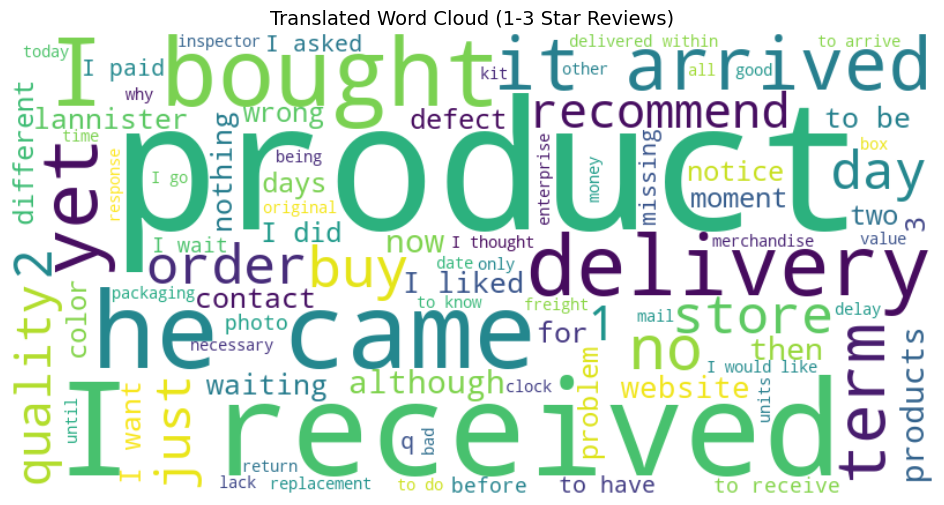

In [197]:
import pandas as pd
import plotly.express as px
import os
import re
import matplotlib.pyplot as plt
import nltk
from nltk.corpus import stopwords
from collections import Counter
from wordcloud import WordCloud
from deep_translator import GoogleTranslator

all_text = ' '.join(low_reviews['full_comment'].dropna().astype(str).tolist())
words = re.findall(r'\b\w+\b', all_text.lower())

# Load Portuguese and English stopwords:
stopwords_pt = set(stopwords.words('portuguese'))
stopwords_eng = set(stopwords.words('english'))
stop_words = stopwords_pt.union(stopwords_eng)

# Remove stopwords:
filtered_words = [word for word in words if word not in stop_words]

# Get 100 most common words:
common_words = Counter(filtered_words).most_common(100)

# Translate with cache:
translator = GoogleTranslator(source='pt', target='en')
cache = {}
translated_common_words = []

for word, count in common_words:
    try:
        if word not in cache:
            cache[word] = translator.translate(word)
        translated_common_words.append((cache[word], count))
    except Exception as e:
        translated_common_words.append((word, count))

# Create frequency dict for WordCloud:
translated_freq = dict(translated_common_words)

# Generate and display WordCloud:
wordcloud = WordCloud(
    width=800,
    height=400,
    background_color='white'
).generate_from_frequencies(translated_freq)

plt.figure(figsize=(12, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title("Translated Word Cloud (1-3 Star Reviews)", fontsize=14)
plt.show()

In [198]:
# Word frequency:
for word, count in translated_common_words:
    print(f"{word}: {count}")

product: 7277
I received: 3458
he came: 2099
I bought: 1975
delivery: 1742
delivered: 1493
yet: 1445
it arrived: 1441
term: 1225
no: 1006
buy: 854
order: 790
store: 782
2: 743
day: 731
good: 719
recommend: 674
1: 663
just: 653
quality: 643
although: 621
products: 608
now: 593
two: 558
then: 557
website: 521
lannister: 498
other: 485
nothing: 481
to be: 470
I want: 455
for: 443
mail: 441
waiting: 432
I liked: 429
contact: 425
different: 404
good: 401
wrong: 399
notice: 391
days: 389
problem: 375
two: 374
3: 362
defect: 360
color: 358
I did: 354
moment: 345
I paid: 344
q: 342
I asked: 339
to have: 336
missing: 332
to receive: 330
I wait: 321
before: 318
photo: 314
replacement: 314
freight: 312
good: 304
only: 301
delivered: 296
response: 294
I go: 292
merchandise: 287
return: 285
lack: 280
inspector: 276
box: 275
return: 271
bad: 266
to know: 264
within: 261
I thought: 260
packaging: 257
other: 253
clock: 250
I would like: 250
enterprise: 250
delay: 238
original: 237
today: 234
units: 23

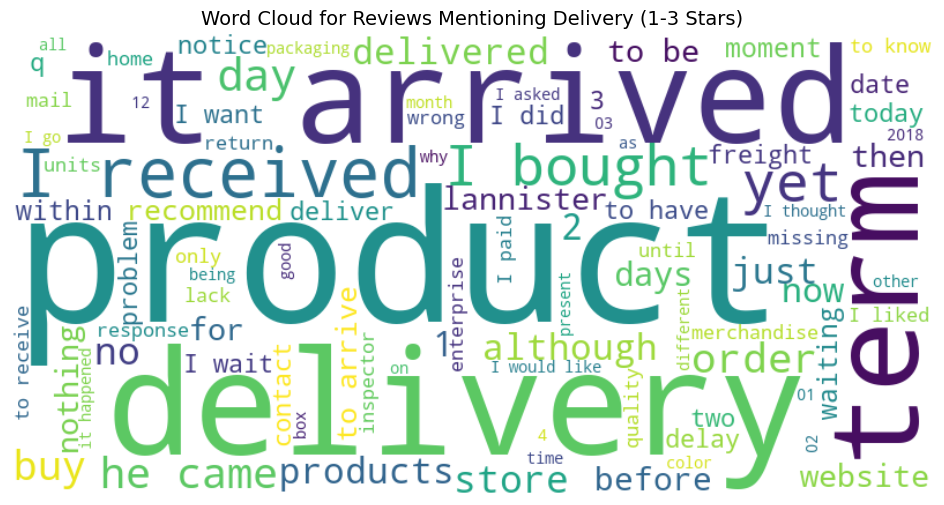

In [199]:
# Define delivery-related keywords (in both Portuguese and English):
delivery_keywords = ['entregue', 'entrega', 'chegou', 'chegar', 'prazo', 'delivered', 'delivery', 'arrived', 'arrival']

# Step 2: Filter reviews that mention any of those keywords:
def contains_delivery_word(text):
    text = text.lower()
    return any(keyword in text for keyword in delivery_keywords)

delivery_related_reviews = low_reviews[low_reviews['full_comment'].astype(str).apply(contains_delivery_word)]

# Join and clean text:
all_delivery_text = ' '.join(delivery_related_reviews['full_comment'].dropna().astype(str).tolist())
delivery_words = re.findall(r'\b\w+\b', all_delivery_text.lower())

# Load stopwords:
stopwords_pt = set(stopwords.words('portuguese'))
stopwords_eng = set(stopwords.words('english'))
stop_words = stopwords_pt.union(stopwords_eng)

# Remove stopwords:
filtered_delivery_words = [word for word in delivery_words if word not in stop_words]

# Get most common words:
common_delivery_words = Counter(filtered_delivery_words).most_common(100)

# Translate with cache:
translator = GoogleTranslator(source='pt', target='en')
cache = {}
translated_common_delivery_words = []

for word, count in common_delivery_words:
    try:
        if word not in cache:
            cache[word] = translator.translate(word)
        translated_common_delivery_words.append((cache[word], count))
    except Exception:
        translated_common_delivery_words.append((word, count))

# Create word cloud:
translated_delivery_freq = dict(translated_common_delivery_words)

wordcloud = WordCloud(
    width=800,
    height=400,
    background_color='white'
).generate_from_frequencies(translated_delivery_freq)

plt.figure(figsize=(12, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title("Word Cloud for Reviews Mentioning Delivery (1-3 Stars)", fontsize=14)
plt.show()

In [200]:
# Word frequency (translated, delivery-related low reviews):
for word, count in translated_common_delivery_words:
    print(f"{word}: {count}")

product: 2948
delivery: 1742
delivered: 1493
it arrived: 1441
term: 1225
I received: 919
I bought: 806
yet: 767
day: 492
he came: 441
order: 426
buy: 392
no: 358
store: 349
2: 329
although: 313
1: 308
products: 304
just: 303
delivered: 296
now: 283
two: 268
days: 263
before: 252
mail: 245
then: 242
for: 236
to be: 234
website: 232
nothing: 227
lannister: 227
recommend: 222
to arrive: 218
moment: 191
within: 190
waiting: 189
other: 178
delay: 176
good: 174
good: 171
delay: 170
contact: 170
notice: 169
date: 164
two: 164
3: 160
I want: 159
I did: 158
deliver: 152
freight: 150
delay: 150
q: 149
to have: 148
problem: 147
today: 147
I wait: 146
merchandise: 144
only: 141
lack: 139
to know: 137
I paid: 134
enterprise: 130
mail: 124
missing: 122
inspector: 121
return: 121
I liked: 118
response: 118
until: 116
to receive: 116
quality: 114
wrong: 111
home: 110
units: 109
I would like: 107
I go: 107
color: 107
03: 106
other: 105
as: 103
time: 100
being: 98
I asked: 98
on: 97
time: 97
it happened

In [201]:
# Total number of 1–3 star reviews:
total_low_reviews = len(low_reviews)

# Number of low reviews that mention delivery-related keywords:
delivery_issue_reviews = len(delivery_related_reviews)

# Percentage of low reviews mentioning delivery issues:
delivery_issue_percentage = (delivery_issue_reviews / total_low_reviews) * 100

print(f"Out of {total_low_reviews} low-rated reviews, {delivery_issue_reviews} mention delivery-related issues.")
print(f"That's approximately {delivery_issue_percentage:.2f}% of all 1-3 star reviews.")

Out of 20014 low-rated reviews, 4814 mention delivery-related issues.
That's approximately 24.05% of all 1-3 star reviews.


### Univariate Analysis

In [202]:
# Review score distribution:
fig = px.histogram(
    cleaned_delivered_df_reviews,
    x='review_score',
    title='Review Score Distribution',
    color='review_score',
    category_orders={'review_score': [1, 2, 3, 4, 5]},
    color_discrete_sequence=px.colors.qualitative.Bold
)
fig.show()

In [203]:
# Comment length:
cleaned_delivered_df_reviews['comment_length'] = cleaned_delivered_df_reviews['review_comment_message'].astype(str).apply(len)

fig = px.histogram(
    cleaned_delivered_df_reviews,
    x='comment_length',
    nbins=50,
    title='Length of Review Comments'
)
fig.show()

### Bivariate Analysis

In [204]:
# Review score vs comment length:
fig = px.box(
    cleaned_delivered_df_reviews,
    x='review_score',
    y='comment_length',
    title='Comment Length by Review Score',
    color='review_score'
)
fig.show()

In [205]:
# Review score over time:
cleaned_delivered_df_reviews['review_creation_date'] = pd.to_datetime(cleaned_delivered_df_reviews['review_creation_date'])

fig = px.box(
    cleaned_delivered_df_reviews,
    x=cleaned_delivered_df_reviews['review_creation_date'].dt.month,
    y='review_score',
    title='Monthly Review Score Distribution',
    labels={'x': 'Month'}
)
fig.show()

In [206]:
# Make sure comment length and month are already computed:
cleaned_delivered_df_reviews['comment_length'] = cleaned_delivered_df_reviews['review_comment_message'].astype(str).apply(len)
cleaned_delivered_df_reviews['month'] = pd.to_datetime(cleaned_delivered_df_reviews['review_creation_date']).dt.to_period("M").astype(str)

# Count reviews per score per month:
low_score_summary = (
    cleaned_delivered_df_reviews[cleaned_delivered_df_reviews['review_score'].isin([1, 2, 3])]
    .groupby(['month', 'review_score'])
    .agg(count=('review_id', 'count'))
    .reset_index()
)

# Pivot to wide format:
highlight_table = low_score_summary.pivot(index='month', columns='review_score', values='count').fillna(0)

# Add a total low score column:
highlight_table['total_low_reviews'] = highlight_table.sum(axis=1)

# Sort by total_low_reviews:
highlight_table = highlight_table.sort_values(by='total_low_reviews', ascending=False)

In [207]:
# Display the top 10 months with the most low score reviews:
top_low_score_months = highlight_table.head(10)
top_low_score_months

review_score,1,2,3,total_low_reviews
month,,,,
2018-03,1329.0,284.0,696.0,2309.0
2017-12,987.0,266.0,651.0,1904.0
2018-04,981.0,256.0,588.0,1825.0
2018-08,653.0,227.0,610.0,1490.0
2018-02,627.0,189.0,547.0,1363.0
2018-01,608.0,208.0,540.0,1356.0
2018-05,602.0,190.0,547.0,1339.0
2018-06,554.0,199.0,508.0,1261.0
2017-11,382.0,123.0,422.0,927.0


In [208]:
# Prepare data for highlighting:
highlight_plot_data = low_score_summary.copy()
highlight_plot_data['review_score'] = highlight_plot_data['review_score'].astype(str)

fig = px.bar(
    highlight_plot_data,
    x='month',
    y='count',
    color='review_score',
    barmode='stack',
    title='Low Review Score Distribution by Month (1-3 Stars)',
    color_discrete_sequence=px.colors.qualitative.Bold
)
fig.update_layout(xaxis_title='Month', yaxis_title='Number of Reviews')
fig.show()

In [209]:
# Prepare data for highlighting all review scores (1 to 5)
all_score_summary = cleaned_delivered_df_reviews.copy()
all_score_summary['review_score'] = all_score_summary['review_score'].astype(str)

# Group by month and review_score
all_score_plot_data = (
    all_score_summary
    .groupby(['month', 'review_score'])
    .size()
    .reset_index(name='count')
)

# Plot
fig = px.bar(
    all_score_plot_data,
    x='month',
    y='count',
    color='review_score',
    barmode='stack',
    title='Review Score Distribution by Month (1–5 Stars)',
    color_discrete_sequence=px.colors.qualitative.Bold
)

fig.update_layout(
    xaxis_title='Month',
    yaxis_title='Number of Reviews'
)

fig.show()

## Product Category Translation Dataset

# **Data Merging**

Load cleaned datasets

In [210]:
cleaned_delivered_df_orders           = read_olist_csv('../data/cleaned_data/olist_orders_dataset.csv')
cleaned_df_customers        = read_olist_csv('../data/cleaned_data/olist_customers_dataset.csv')
cleaned_delivered_df_order_items      = read_olist_csv('../data/cleaned_data/olist_order_items_dataset.csv')
cleaned_delivered_df_order_payments   = read_olist_csv('../data/cleaned_data/olist_order_payments_dataset.csv')
cleaned_delivered_df_reviews          = read_olist_csv('../data/cleaned_data/olist_order_reviews_dataset.csv')
cleaned_df_products         = read_olist_csv('../data/cleaned_data/olist_products_dataset.csv')
cleaned_df_prod_cat_tr      = read_olist_csv('../data/cleaned_data/product_category_name_translation.csv')
cleaned_df_sellers          = read_olist_csv('../data/cleaned_data/olist_sellers_dataset.csv')
cleaned_df_geolocation      = read_olist_csv('../data/cleaned_data/olist_geolocation_dataset.csv')

## Dataset Merging Strategy

![image.png](attachment:image.png)

To prepare the dataset for analysis and modelling, we follow this structured merging sequence:

1. **Start with `orders`** as the central table containing order lifecycle and timestamp information.
2. **Merge `orders` with `customers`** on `customer_id` to include customer demographic details such as city and state.
3. **Merge `order_items` with `products`** on `product_id` to bring in product-level information like category and attributes.
4. **Merge the `order_items + products` result with `sellers`** on `seller_id` to add seller location data.
5. **Merge the `orders + customers` dataset with the `order_items + products + sellers` dataset** on `order_id`, consolidating order-level and item-level information.
6. **Merge the result with `order_payments`** on `order_id` to include payment method and instalment data.
7. **Merge the result with `order_reviews`** on `order_id` to add customer feedback and review scores.
8. **Finally, merge the complete dataset with `product_category_name_translation`** on `product_category_name` to translate Portuguese product categories into English.

This step-by-step merging approach ensures that all relevant aspects such as orders, customers, products, sellers, payments, and reviews are integrated into a single, comprehensive dataset for robust analysis.

### Orders ⇄ Customers

In [211]:
# Merge orders and customers tables (1:1 relationship) using 'customer_id' as key:
merged_orders_customers = cleaned_delivered_df_orders.merge(
    cleaned_df_customers,       # for customers table
    on='customer_id',           # the key for merging
    how='left',                 # to keep all orders and add matching customer info
    indicator=True              # to add a column showing the source of each row match
)

# Print count of merge status (should be all 'both' if merge is successful):
print("orders ⇄ customers:", merged_orders_customers['_merge'].value_counts())

# Ensure all merged rows matched (i.e., each order has a customer):
assert (merged_orders_customers['_merge'] == 'both').all(), "⚠️ Some orders missing customers!"

# Drop the merge indicator column now that the check is done:
merged_orders_customers.drop(columns=['_merge'], inplace=True)

# Result:
display(merged_orders_customers.head())

orders ⇄ customers: _merge
both          96282
left_only         0
right_only        0
Name: count, dtype: int64


,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13,af07308b275d755c9edb36a90c618231,47813,barreiras,BA
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04,3a653a41f6f9fc3d2a113cf8398680e8,75265,vianopolis,GO
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15,7c142cf63193a1473d2e66489a9ae977,59296,sao goncalo do amarante,RN
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26,72632f0f9dd73dfee390c9b22eb56dd6,9195,santo andre,SP


In [212]:
# Check for any missing values in the merged DataFrame:
merged_orders_customers.isna().sum()

order_id                         0
customer_id                      0
order_status                     0
order_purchase_timestamp         0
order_approved_at                0
order_delivered_carrier_date     0
order_delivered_customer_date    0
order_estimated_delivery_date    0
customer_unique_id               0
customer_zip_code_prefix         0
customer_city                    0
customer_state                   0
dtype: int64

### Order Items ⇄ Products

In [213]:
# Enrich the order_items table with product details (1:1 relationship) using 'product_id':
enriched_order_items = cleaned_delivered_df_order_items.merge(
    cleaned_df_products,       # for product information table
    on='product_id',           # the key to merge on
    how='left',                # to keep all order items and attach matching product data
    indicator=True             # to include a column showing the source of each match
)

# Display merge status counts (useful for checking if any items lacked product info):
print("order_items ⇄ products:", enriched_order_items['_merge'].value_counts())

# Optional validation:
# assert (enriched_order_items['_merge'] == 'both').all(), "⚠️ Some items missing products!"
# enriched_order_items.drop(columns=['_merge'], inplace=True)

# Result:
display(enriched_order_items.head())

order_items ⇄ products: _merge
both          109936
left_only         17
right_only         0
Name: count, dtype: int64


,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,_merge
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.90,13.29,cool_stuff,58.0,598.0,4.0,650.0,28.0,9.0,14.0,both
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.90,19.93,pet_shop,56.0,239.0,2.0,30000.0,50.0,30.0,40.0,both
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.00,17.87,moveis_decoracao,59.0,695.0,2.0,3050.0,33.0,13.0,33.0,both
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4,2018-08-15 10:10:18,12.99,12.79,perfumaria,42.0,480.0,1.0,200.0,16.0,10.0,15.0,both
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87,2017-02-13 13:57:51,199.90,18.14,ferramentas_jardim,59.0,409.0,1.0,3750.0,35.0,40.0,30.0,both


In [214]:
# Check for any missing values in the enriched DataFrame:
enriched_order_items.isna().sum()

order_id                       0
order_item_id                  0
product_id                     0
seller_id                      0
shipping_limit_date            0
price                          0
freight_value                  0
product_category_name         17
product_name_lenght           17
product_description_lenght    17
product_photos_qty            17
product_weight_g              17
product_length_cm             17
product_height_cm             17
product_width_cm              17
_merge                         0
dtype: int64

In [215]:
# Check for items without products:
enriched_order_items[enriched_order_items['_merge'] == 'left_only']

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,_merge
6949,101157d4fae1c9fb74a00a5dee265c25,1,5eb564652db742ff8f28759cd8d2652a,4e922959ae960d389249c378d1c939f5,2017-04-11 08:02:26,29.0,14.52,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
9011,1521c6bb7b1028154c8c67cf80fa809f,1,5eb564652db742ff8f28759cd8d2652a,4e922959ae960d389249c378d1c939f5,2017-04-07 10:10:16,29.0,16.05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
28006,415cfaaaa8cea49f934470548797fed1,1,5eb564652db742ff8f28759cd8d2652a,4e922959ae960d389249c378d1c939f5,2017-04-07 10:35:19,29.0,14.52,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
28007,415cfaaaa8cea49f934470548797fed1,2,5eb564652db742ff8f28759cd8d2652a,4e922959ae960d389249c378d1c939f5,2017-04-07 10:35:19,29.0,14.52,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
38344,595316a07cd3dea9db7adfcc7e247ae7,1,5eb564652db742ff8f28759cd8d2652a,4e922959ae960d389249c378d1c939f5,2017-08-18 04:26:04,39.0,9.27,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
47252,6e150190fbe04c642a9cf0b80d83ee16,1,5eb564652db742ff8f28759cd8d2652a,4e922959ae960d389249c378d1c939f5,2017-06-30 16:45:14,39.0,16.79,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
47790,6f497c40431d5fb0cfbd6c943dd29215,1,5eb564652db742ff8f28759cd8d2652a,4e922959ae960d389249c378d1c939f5,2017-04-11 05:55:32,29.0,10.96,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
69432,a2456e7f02197951664897a94c87242d,1,5eb564652db742ff8f28759cd8d2652a,4e922959ae960d389249c378d1c939f5,2017-04-06 11:50:09,29.0,24.84,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
71800,a7a43f469c0d7bdb0a23a82db125aefa,1,5eb564652db742ff8f28759cd8d2652a,4e922959ae960d389249c378d1c939f5,2017-08-28 13:15:11,39.0,15.10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
80822,bbfc7badbed2f1828e22b6d629201bd4,1,5eb564652db742ff8f28759cd8d2652a,4e922959ae960d389249c378d1c939f5,2017-07-18 04:04:10,39.0,11.85,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only


In [216]:
# Remove order items that don't have matching products
print(f"Removing {(enriched_order_items['_merge'] == 'left_only').sum()} order items without matching products")
enriched_order_items = enriched_order_items[enriched_order_items['_merge'] == 'both']

Removing 17 order items without matching products


In [217]:
# Drop the merge indicator column now that the check is done:
enriched_order_items.drop(columns=['_merge'], inplace=True)
enriched_order_items.head()

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.90,13.29,cool_stuff,58.0,598.0,4.0,650.0,28.0,9.0,14.0
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.90,19.93,pet_shop,56.0,239.0,2.0,30000.0,50.0,30.0,40.0
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.00,17.87,moveis_decoracao,59.0,695.0,2.0,3050.0,33.0,13.0,33.0
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4,2018-08-15 10:10:18,12.99,12.79,perfumaria,42.0,480.0,1.0,200.0,16.0,10.0,15.0
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87,2017-02-13 13:57:51,199.90,18.14,ferramentas_jardim,59.0,409.0,1.0,3750.0,35.0,40.0,30.0


### Order Items + Products ⇄ Sellers

In [218]:
# Enrich the order_items data with seller details (1:1 relationship) using 'seller_id':
enriched_order_items = enriched_order_items.merge(
    cleaned_df_sellers,       # for seller information table
    on='seller_id',           # the key to merge on
    how='left',               # to keep all order items, attach matching seller data
    indicator=True            # to include a column showing the source of each match
)

# Display merge status counts (helps verify if all items had a matching seller):
print("enriched_order_items ⇄ sellers:", enriched_order_items['_merge'].value_counts())

# Ensure all items have seller information (raise error if any do not):
assert (enriched_order_items['_merge'] == 'both').all(), "⚠️ Some items missing sellers!"

# Drop the merge indicator column as it's no longer needed:
enriched_order_items.drop(columns=['_merge'], inplace=True)

# Result:
enriched_order_items.head()

enriched_order_items ⇄ sellers: _merge
both          109936
left_only          0
right_only         0
Name: count, dtype: int64


,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_zip_code_prefix,seller_city,seller_state
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.90,13.29,cool_stuff,58.0,598.0,4.0,650.0,28.0,9.0,14.0,27277,volta redonda,SP
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.90,19.93,pet_shop,56.0,239.0,2.0,30000.0,50.0,30.0,40.0,3471,sao paulo,SP
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.00,17.87,moveis_decoracao,59.0,695.0,2.0,3050.0,33.0,13.0,33.0,37564,borda da mata,MG
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4,2018-08-15 10:10:18,12.99,12.79,perfumaria,42.0,480.0,1.0,200.0,16.0,10.0,15.0,14403,franca,SP
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87,2017-02-13 13:57:51,199.90,18.14,ferramentas_jardim,59.0,409.0,1.0,3750.0,35.0,40.0,30.0,87900,loanda,PR


In [219]:
enriched_order_items.head()

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_zip_code_prefix,seller_city,seller_state
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.90,13.29,cool_stuff,58.0,598.0,4.0,650.0,28.0,9.0,14.0,27277,volta redonda,SP
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.90,19.93,pet_shop,56.0,239.0,2.0,30000.0,50.0,30.0,40.0,3471,sao paulo,SP
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.00,17.87,moveis_decoracao,59.0,695.0,2.0,3050.0,33.0,13.0,33.0,37564,borda da mata,MG
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4,2018-08-15 10:10:18,12.99,12.79,perfumaria,42.0,480.0,1.0,200.0,16.0,10.0,15.0,14403,franca,SP
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87,2017-02-13 13:57:51,199.90,18.14,ferramentas_jardim,59.0,409.0,1.0,3750.0,35.0,40.0,30.0,87900,loanda,PR


### Orders + Customers ⇄ Order Items + Products + Sellers

In [220]:
# Merge combined orders + customers data with enriched order_items (1:many relationship):
merged_orders_items = merged_orders_customers.merge(
    enriched_order_items,     # for the table that's already enriched with product and seller info
    on='order_id',            # to merge based on shared order ID
    how='left',               # to keep all orders, even if they have no associated items
    indicator=True            # to add a column indicating merge result (both/left_only/right_only)
)

# Print how many records matched successfully vs. not:
print("(orders + cust) ⇄ items:", merged_orders_items['_merge'].value_counts())

# Check that all items from order_items matched with an order:
n_items = len(enriched_order_items)
matched_items = (merged_orders_items['_merge'] == 'both').sum()
assert matched_items == n_items, f"⚠️ Only {matched_items}/{n_items} items matched!"

# Optional validation:
# assert (merged_orders_items['_merge'] == 'left_only').sum() == 0, "⚠️ Some orders have no items!"
# merged_orders_items.drop(columns=['_merge'], inplace=True)

# Result:
merged_orders_items.head()

(orders + cust) ⇄ items: _merge
both          109936
left_only         15
right_only         0
Name: count, dtype: int64


,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_zip_code_prefix,seller_city,seller_state,_merge
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,1.0,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-10-06 11:07:15,29.99,8.72,utilidades_domesticas,40.0,268.0,4.0,500.0,19.0,8.0,13.0,9350.0,maua,SP,both
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13,af07308b275d755c9edb36a90c618231,47813,barreiras,BA,1.0,595fac2a385ac33a80bd5114aec74eb8,289cdb325fb7e7f891c38608bf9e0962,2018-07-30 03:24:27,118.70,22.76,perfumaria,29.0,178.0,1.0,400.0,19.0,13.0,19.0,31570.0,belo horizonte,SP,both
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04,3a653a41f6f9fc3d2a113cf8398680e8,75265,vianopolis,GO,1.0,aa4383b373c6aca5d8797843e5594415,4869f7a5dfa277a7dca6462dcf3b52b2,2018-08-13 08:55:23,159.90,19.22,automotivo,46.0,232.0,1.0,420.0,24.0,19.0,21.0,14840.0,guariba,SP,both
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15,7c142cf63193a1473d2e66489a9ae977,59296,sao goncalo do amarante,RN,1.0,d0b61bfb1de832b15ba9d266ca96e5b0,66922902710d126a0e7d26b0e3805106,2017-11-23 19:45:59,45.00,27.20,pet_shop,59.0,468.0,3.0,450.0,30.0,10.0,20.0,31842.0,belo horizonte,MG,both
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26,72632f0f9dd73dfee390c9b22eb56dd6,9195,santo andre,SP,1.0,65266b2da20d04dbe00c5c2d3bb7859e,2c9e548be18521d1c43cde1c582c6de8,2018-02-19 20:31:37,19.90,8.72,papelaria,38.0,316.0,4.0,250.0,51.0,15.0,15.0,8752.0,mogi das cruzes,SP,both


**Note: 15 orders** have no associated items because their corresponding order items were dropped earlier due to missing product information. To maintain consistency and ensure data integrity, we will also drop these 15 orders from the merged dataset.

In [221]:
# Identify orders that do not have any matching items (likely due to earlier drops):
orders_without_items = merged_orders_items[merged_orders_items['_merge'] == 'left_only']
print(f"Number of orders without items: {len(orders_without_items)}")

# Remove those unmatched orders from the merged dataset:
print(f"Removing {(merged_orders_items['_merge'] == 'left_only').sum()} orders without matching items")
merged_orders_items = merged_orders_items[merged_orders_items['_merge'] == 'both']

# Drop the merge indicator column as it's no longer needed:
merged_orders_items.drop(columns=['_merge'], inplace=True)

# Check the shape of the final dataset after removing unmatched orders:
print(f"Final shape of merged_orders_items: {merged_orders_items.shape}")
merged_orders_items.head()

Number of orders without items: 15
Removing 15 orders without matching items
Final shape of merged_orders_items: (109936, 29)


,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_zip_code_prefix,seller_city,seller_state
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,1.0,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-10-06 11:07:15,29.99,8.72,utilidades_domesticas,40.0,268.0,4.0,500.0,19.0,8.0,13.0,9350.0,maua,SP
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13,af07308b275d755c9edb36a90c618231,47813,barreiras,BA,1.0,595fac2a385ac33a80bd5114aec74eb8,289cdb325fb7e7f891c38608bf9e0962,2018-07-30 03:24:27,118.70,22.76,perfumaria,29.0,178.0,1.0,400.0,19.0,13.0,19.0,31570.0,belo horizonte,SP
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04,3a653a41f6f9fc3d2a113cf8398680e8,75265,vianopolis,GO,1.0,aa4383b373c6aca5d8797843e5594415,4869f7a5dfa277a7dca6462dcf3b52b2,2018-08-13 08:55:23,159.90,19.22,automotivo,46.0,232.0,1.0,420.0,24.0,19.0,21.0,14840.0,guariba,SP
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15,7c142cf63193a1473d2e66489a9ae977,59296,sao goncalo do amarante,RN,1.0,d0b61bfb1de832b15ba9d266ca96e5b0,66922902710d126a0e7d26b0e3805106,2017-11-23 19:45:59,45.00,27.20,pet_shop,59.0,468.0,3.0,450.0,30.0,10.0,20.0,31842.0,belo horizonte,MG
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26,72632f0f9dd73dfee390c9b22eb56dd6,9195,santo andre,SP,1.0,65266b2da20d04dbe00c5c2d3bb7859e,2c9e548be18521d1c43cde1c582c6de8,2018-02-19 20:31:37,19.90,8.72,papelaria,38.0,316.0,4.0,250.0,51.0,15.0,15.0,8752.0,mogi das cruzes,SP


In [222]:
# Check for any missing values in the final merged DataFrame:
merged_orders_items.isna().sum()

order_id                         0
customer_id                      0
order_status                     0
order_purchase_timestamp         0
order_approved_at                0
order_delivered_carrier_date     0
order_delivered_customer_date    0
order_estimated_delivery_date    0
customer_unique_id               0
customer_zip_code_prefix         0
customer_city                    0
customer_state                   0
order_item_id                    0
product_id                       0
seller_id                        0
shipping_limit_date              0
price                            0
freight_value                    0
product_category_name            0
product_name_lenght              0
product_description_lenght       0
product_photos_qty               0
product_weight_g                 0
product_length_cm                0
product_height_cm                0
product_width_cm                 0
seller_zip_code_prefix           0
seller_city                      0
seller_state        

### Orders + Items + Customers + Sellers + Products ⇄ Payments

In [223]:
cleaned_delivered_df_order_payments.head(1)

,order_id,payment_sequential,payment_type,payment_installments,payment_value
0,b81ef226f3fe1789b1e8b2acac839d17,1,credit_card,8,99.33


In [224]:
# 1. Aggregate payments at the order level BEFORE the merge since 1 order can have multiple payment attempts recorded
pay_agg = (
    cleaned_delivered_df_order_payments
    .groupby('order_id', as_index=False)
    .agg(
        total_payment_value=('payment_value', 'sum'),
        n_payments=('payment_sequential', 'count'),
        payment_types=('payment_type', lambda x: ', '.join(sorted(set(x)))),
        max_installments=('payment_installments', 'max'),
    )
)


# 2. Merge aggregated payments to merged_orders_items (now every order_id is unique in pay_agg)
merged_orders_payments = merged_orders_items.merge(
    pay_agg,
    on='order_id',
    how='left',
    indicator=True
)

# 3. Sanity checks
print("with payments:", merged_orders_payments['_merge'].value_counts())
assert not (merged_orders_payments['_merge'] == 'right_only').any(), "⚠️ Orphan payments exist!"
# merged_orders_payments.drop(columns=['_merge'], inplace=True)

# 4. Sanity: Check for true item-level uniqueness (should be 1 row per order_id+order_item_id)
assert merged_orders_payments.duplicated(['order_id', 'order_item_id']).sum() == 0, "Still got duplicates at item level!"

display(merged_orders_payments.head())

with payments: _merge
both          109933
left_only          3
right_only         0
Name: count, dtype: int64


,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_zip_code_prefix,seller_city,seller_state,total_payment_value,n_payments,payment_types,max_installments,_merge
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,1.0,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-10-06 11:07:15,29.99,8.72,utilidades_domesticas,40.0,268.0,4.0,500.0,19.0,8.0,13.0,9350.0,maua,SP,38.71,3.0,"credit_card, voucher",1.0,both
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13,af07308b275d755c9edb36a90c618231,47813,barreiras,BA,1.0,595fac2a385ac33a80bd5114aec74eb8,289cdb325fb7e7f891c38608bf9e0962,2018-07-30 03:24:27,118.70,22.76,perfumaria,29.0,178.0,1.0,400.0,19.0,13.0,19.0,31570.0,belo horizonte,SP,141.46,1.0,boleto,1.0,both
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04,3a653a41f6f9fc3d2a113cf8398680e8,75265,vianopolis,GO,1.0,aa4383b373c6aca5d8797843e5594415,4869f7a5dfa277a7dca6462dcf3b52b2,2018-08-13 08:55:23,159.90,19.22,automotivo,46.0,232.0,1.0,420.0,24.0,19.0,21.0,14840.0,guariba,SP,179.12,1.0,credit_card,3.0,both
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15,7c142cf63193a1473d2e66489a9ae977,59296,sao goncalo do amarante,RN,1.0,d0b61bfb1de832b15ba9d266ca96e5b0,66922902710d126a0e7d26b0e3805106,2017-11-23 19:45:59,45.00,27.20,pet_shop,59.0,468.0,3.0,450.0,30.0,10.0,20.0,31842.0,belo horizonte,MG,72.20,1.0,credit_card,1.0,both
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26,72632f0f9dd73dfee390c9b22eb56dd6,9195,santo andre,SP,1.0,65266b2da20d04dbe00c5c2d3bb7859e,2c9e548be18521d1c43cde1c582c6de8,2018-02-19 20:31:37,19.90,8.72,papelaria,38.0,316.0,4.0,250.0,51.0,15.0,15.0,8752.0,mogi das cruzes,SP,28.62,1.0,credit_card,1.0,both


In [225]:
# Check for orders without payments:
merged_orders_payments[merged_orders_payments['_merge'] == 'left_only'][['order_id', 'order_item_id', 'product_id',
                                                                         'n_payments', 'payment_types', 'max_installments', 'total_payment_value',
                                                                         'price', 'freight_value']]

,order_id,order_item_id,product_id,n_payments,payment_types,max_installments,total_payment_value,price,freight_value
33962,bfbd0f9bdef84302105ad712db648a6c,1.0,5a6b04657a4c5ee34285d1e4619a96b4,NaN,NaN,NaN,NaN,44.99,2.83
33963,bfbd0f9bdef84302105ad712db648a6c,2.0,5a6b04657a4c5ee34285d1e4619a96b4,NaN,NaN,NaN,NaN,44.99,2.83
33964,bfbd0f9bdef84302105ad712db648a6c,3.0,5a6b04657a4c5ee34285d1e4619a96b4,NaN,NaN,NaN,NaN,44.99,2.83


In [226]:
original_df_order_payments[original_df_order_payments['order_id'] == 'bfbd0f9bdef84302105ad712db648a6c']

,order_id,payment_sequential,payment_type,payment_installments,payment_value


Reason for keeping the rows:

There is **1 order** (with **3 associated items**) that is missing payment information even in the original payments dataset. While the `payment_value` can be **inferred** by summing the `price` and `freight_value`, the remaining payment fields would need to be **imputed using synthetic values**. To ensure data completeness, we will:
- **Retain** the order
- **Infer** the `payment_value`
- **Impute** other missing fields with synthetic values
- **Flag** this order to indicate it contains imputed payment information

In [227]:
# original_df_order_payments['payment_type'].value_counts()

In [228]:
# missing_payment_mask = merged_orders_payments['order_id'] == 'bfbd0f9bdef84302105ad712db648a6c'

# # Calculate the payment value from price + freight_value
# merged_orders_payments.loc[missing_payment_mask, 'payment_value'] = (
#     merged_orders_payments.loc[missing_payment_mask, 'price'] + 
#     merged_orders_payments.loc[missing_payment_mask, 'freight_value']
# )

# # Set payment type to 'not_defined' (synthetic value, but this category exists in the original dataset)
# merged_orders_payments.loc[missing_payment_mask, 'payment_type'] = 'not_defined'

# # Add a flag to indicate this order has synthetic payment data
# merged_orders_payments['missing_payment_details'] = False
# merged_orders_payments.loc[missing_payment_mask, 'missing_payment_details'] = True

# merged_orders_payments[missing_payment_mask]

Alternative Approach: **Deleting the Row**

An alternative would be to **remove the order entirely** due to the missing payment information. This ensures that all records in the dataset have complete payment data and eliminates the need for imputation.

In [229]:
# Delete the 3 rows with missing payment info instead of keeping them
print(f"Removing {(merged_orders_payments['_merge'] == 'left_only').sum()} orders without payment information")
merged_orders_payments = merged_orders_payments[merged_orders_payments['_merge'] == 'both']

Removing 3 orders without payment information


In [230]:
# Drop the merge indicator column now that the check is done:
merged_orders_payments.drop(columns=['_merge'], inplace=True)
merged_orders_payments.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_zip_code_prefix,seller_city,seller_state,total_payment_value,n_payments,payment_types,max_installments
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,1.0,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-10-06 11:07:15,29.99,8.72,utilidades_domesticas,40.0,268.0,4.0,500.0,19.0,8.0,13.0,9350.0,maua,SP,38.71,3.0,"credit_card, voucher",1.0
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13,af07308b275d755c9edb36a90c618231,47813,barreiras,BA,1.0,595fac2a385ac33a80bd5114aec74eb8,289cdb325fb7e7f891c38608bf9e0962,2018-07-30 03:24:27,118.70,22.76,perfumaria,29.0,178.0,1.0,400.0,19.0,13.0,19.0,31570.0,belo horizonte,SP,141.46,1.0,boleto,1.0
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04,3a653a41f6f9fc3d2a113cf8398680e8,75265,vianopolis,GO,1.0,aa4383b373c6aca5d8797843e5594415,4869f7a5dfa277a7dca6462dcf3b52b2,2018-08-13 08:55:23,159.90,19.22,automotivo,46.0,232.0,1.0,420.0,24.0,19.0,21.0,14840.0,guariba,SP,179.12,1.0,credit_card,3.0
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15,7c142cf63193a1473d2e66489a9ae977,59296,sao goncalo do amarante,RN,1.0,d0b61bfb1de832b15ba9d266ca96e5b0,66922902710d126a0e7d26b0e3805106,2017-11-23 19:45:59,45.00,27.20,pet_shop,59.0,468.0,3.0,450.0,30.0,10.0,20.0,31842.0,belo horizonte,MG,72.20,1.0,credit_card,1.0
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26,72632f0f9dd73dfee390c9b22eb56dd6,9195,santo andre,SP,1.0,65266b2da20d04dbe00c5c2d3bb7859e,2c9e548be18521d1c43cde1c582c6de8,2018-02-19 20:31:37,19.90,8.72,papelaria,38.0,316.0,4.0,250.0,51.0,15.0,15.0,8752.0,mogi das cruzes,SP,28.62,1.0,credit_card,1.0


In [231]:
# Check for any remaining missing values in the final merged DataFrame:
merged_orders_payments.isna().sum()

order_id                         0
customer_id                      0
order_status                     0
order_purchase_timestamp         0
order_approved_at                0
order_delivered_carrier_date     0
order_delivered_customer_date    0
order_estimated_delivery_date    0
customer_unique_id               0
customer_zip_code_prefix         0
customer_city                    0
customer_state                   0
order_item_id                    0
product_id                       0
seller_id                        0
shipping_limit_date              0
price                            0
freight_value                    0
product_category_name            0
product_name_lenght              0
product_description_lenght       0
product_photos_qty               0
product_weight_g                 0
product_length_cm                0
product_height_cm                0
product_width_cm                 0
seller_zip_code_prefix           0
seller_city                      0
seller_state        

In [232]:
merged_orders_payments.shape

(109933, 33)

### Orders + Items + Customers + Sellers + Products + Payments ⇄ Reviews

In [233]:
# Merge enriched_orders with reviews (1:1 relationship):
merged_orders_reviews = merged_orders_payments.merge(
    cleaned_delivered_df_reviews,   # for reviews table
    on='order_id',                  # to merge based on shared order ID
    how='left',                     # to keep all orders and attach matching reviews
    indicator=True                  # to add a column showing the source of each row match
)

# Check merge result to identify unmatched records:
print("Review merge status:", merged_orders_reviews['_merge'].value_counts())

# Ensure no orphaned reviews exist (i.e., reviews without matching orders):
assert not (merged_orders_reviews['_merge'] == 'right_only').any(), "⚠️ Orphan reviews found!"

# Result:
# merged_orders_reviews.drop(columns=['_merge'], inplace=True)
merged_orders_reviews.head()

Review merge status: _merge
both          108612
left_only       1321
right_only         0
Name: count, dtype: int64


,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_zip_code_prefix,seller_city,seller_state,total_payment_value,n_payments,payment_types,max_installments,review_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp,_merge
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,1.0,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-10-06 11:07:15,29.99,8.72,utilidades_domesticas,40.0,268.0,4.0,500.0,19.0,8.0,13.0,9350.0,maua,SP,38.71,3.0,"credit_card, voucher",1.0,a54f0611adc9ed256b57ede6b6eb5114,4.0,NaN,"Não testei o produto ainda, mas ele veio correto e em boas condições. Apenas a caixa que veio bem amassada e danificada, o que ficará chato, pois se trata de um presente.",2017-10-11,2017-10-12 03:43:48,both
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13,af07308b275d755c9edb36a90c618231,47813,barreiras,BA,1.0,595fac2a385ac33a80bd5114aec74eb8,289cdb325fb7e7f891c38608bf9e0962,2018-07-30 03:24:27,118.70,22.76,perfumaria,29.0,178.0,1.0,400.0,19.0,13.0,19.0,31570.0,belo horizonte,SP,141.46,1.0,boleto,1.0,8d5266042046a06655c8db133d120ba5,4.0,Muito boa a loja,Muito bom o produto.,2018-08-08,2018-08-08 18:37:50,both
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04,3a653a41f6f9fc3d2a113cf8398680e8,75265,vianopolis,GO,1.0,aa4383b373c6aca5d8797843e5594415,4869f7a5dfa277a7dca6462dcf3b52b2,2018-08-13 08:55:23,159.90,19.22,automotivo,46.0,232.0,1.0,420.0,24.0,19.0,21.0,14840.0,guariba,SP,179.12,1.0,credit_card,3.0,e73b67b67587f7644d5bd1a52deb1b01,5.0,NaN,NaN,2018-08-18,2018-08-22 19:07:58,both
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15,7c142cf63193a1473d2e66489a9ae977,59296,sao goncalo do amarante,RN,1.0,d0b61bfb1de832b15ba9d266ca96e5b0,66922902710d126a0e7d26b0e3805106,2017-11-23 19:45:59,45.00,27.20,pet_shop,59.0,468.0,3.0,450.0,30.0,10.0,20.0,31842.0,belo horizonte,MG,72.20,1.0,credit_card,1.0,359d03e676b3c069f62cadba8dd3f6e8,5.0,NaN,O produto foi exatamente o que eu esperava e estava descrito no site e chegou bem antes da data prevista.,2017-12-03,2017-12-05 19:21:58,both
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26,72632f0f9dd73dfee390c9b22eb56dd6,9195,santo andre,SP,1.0,65266b2da20d04dbe00c5c2d3bb7859e,2c9e548be18521d1c43cde1c582c6de8,2018-02-19 20:31:37,19.90,8.72,papelaria,38.0,316.0,4.0,250.0,51.0,15.0,15.0,8752.0,mogi das cruzes,SP,28.62,1.0,credit_card,1.0,e50934924e227544ba8246aeb3770dd4,5.0,NaN,NaN,2018-02-17,2018-02-18 13:02:51,both


In [234]:
# Check for orders without reviews:
merged_orders_reviews[merged_orders_reviews['_merge'] == 'left_only']

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_zip_code_prefix,seller_city,seller_state,total_payment_value,n_payments,payment_types,max_installments,review_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp,_merge
16,403b97836b0c04a622354cf531062e5f,738b086814c6fcc74b8cc583f8516ee3,delivered,2018-01-02 19:00:43,2018-01-02 19:09:04,2018-01-03 18:19:09,2018-01-20 01:38:59,2018-02-06,6e26bbeaa107ec34112c64e1ee31c0f5,21381,rio de janeiro,RJ,1.0,638bbb2a5e4f360b71f332ddfebfd672,c4af86330efa7a2620772227d2d670c9,2018-01-12 19:09:04,1299.00,77.45,construcao_ferramentas_construcao,38.0,143.0,2.0,20850.0,100.0,25.0,50.0,8840.0,mogi das cruzes,SP,1376.45,1.0,credit_card,10.0,NaN,NaN,NaN,NaN,NaT,NaT,left_only
60,a685d016c8a26f71a0bb67821070e398,911e4c37f5cafe1604fe6767034bf1ae,delivered,2017-03-13 18:14:36,2017-03-13 18:14:36,2017-03-22 14:03:09,2017-04-06 13:37:16,2017-03-30,51838d41add414a0b1b989b7d251d9ee,13068,campinas,SP,1.0,ebd7c847c1e1cb69ec374ae0ebee1f4c,391fc6631aebcf3004804e51b40bcf1e,2017-03-17 18:14:36,84.90,14.36,moveis_decoracao,50.0,228.0,3.0,1200.0,40.0,15.0,30.0,14940.0,ibitinga,SP,99.26,1.0,boleto,1.0,NaN,NaN,NaN,NaN,NaT,NaT,left_only
92,b8801cccd8068de30112e4f49903d74a,f26a435864aebedff7f7c84f82ee229f,delivered,2017-07-30 03:06:35,2017-07-30 03:25:08,2017-07-31 16:42:54,2017-08-01 14:27:31,2017-08-16,bb4d84a2b45b22ed710ac8c0dec63d1a,8552,poa,SP,1.0,154e7e31ebfa092203795c972e5804a6,cc419e0650a3c5ba77189a1882b7556a,2017-08-08 03:25:08,19.99,7.78,beleza_saude,48.0,575.0,1.0,100.0,20.0,15.0,15.0,9015.0,santo andre,SP,27.77,1.0,credit_card,2.0,NaN,NaN,NaN,NaN,NaT,NaT,left_only
200,ce9feeba53c652dd6569cca62e2bb287,f7398fc942c8fa80e5419ae52e49f7fb,delivered,2018-04-15 19:42:06,2018-04-15 19:55:20,2018-04-19 14:32:30,2018-04-20 23:12:11,2018-04-26,d01cf8c6c7c836c5dd9320585928f42b,6414,barueri,SP,1.0,28b5fef7b6d63771e9784bc68c783793,d91fb3b7d041e83b64a00a3edfb37e4f,2018-04-19 19:55:20,45.00,11.86,eletrodomesticos,60.0,564.0,1.0,1500.0,65.0,8.0,38.0,11704.0,praia grande,SP,56.86,1.0,credit_card,1.0,NaN,NaN,NaN,NaN,NaT,NaT,left_only
277,7e3e92dc3eaf5389f32da97228f7dd0e,62d50e9a714ac024c196d9548594e2aa,delivered,2017-07-02 20:47:24,2017-07-02 21:03:55,2017-07-03 11:42:08,2017-07-11 20:22:31,2017-07-25,ba77e9b6506636dcbd03e463d4786f24,95059,caxias do sul,RS,1.0,f0bc0aed23d451f89495f7650d81e244,a3a38f4affed601eb87a97788c949667,2017-07-06 21:03:55,79.90,15.31,beleza_saude,45.0,124.0,2.0,900.0,30.0,5.0,23.0,89204.0,joinville,SC,95.21,1.0,credit_card,4.0,NaN,NaN,NaN,NaN,NaT,NaT,left_only
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
109492,2fcdb0c004a2a538d3dd724ea76916bd,cf826be53b1fe4a39bc33c7f5f827835,delivered,2017-11-22 11:39:00,2017-11-22 11:49:05,2017-11-23 22:58:51,2017-12-15 00:23:25,2017-12-18,d92462d83762d5e5c112bccc344119e6,65940,grajau,MA,1.0,8d139b1550c8cc91a3babc9cfe9fc147,c9c7905cffc4ef9ff9f113554423e671,2017-11-28 11:48:35,55.00,35.71,telefonia,53.0,1017.0,5.0,500.0,16.0,6.0,11.0,6871.0,itapecerica da serra,SP,90.71,1.0,credit_card,9.0,NaN,NaN,NaN,NaN,NaT,NaT,left_only
109589,2f2df159f26ddb73d55ee72372200d3e,86a7245fffe6a418ca1658a13ecc4531,delivered,2017-07-17 01:19:50,2017-07-17 01:30:09,2017-07-17 22:14:50,2017-07-26 09:44:00,2017-08-09,1d532194f005426adcdf6d969640d56e,35240,conselheiro pena,MG,1.0,4052517cac9e78357d895976124f6972,ce27a3cc3c8cc1ea79d11e561e9bebb6,2017-07-24 01:30:09,150.00,16.81,eletronicos,31.0,736.0,3.0,

**Note:** There are **1,372 order items** that do not have associated reviews. This is acceptable, as submitting a review is optional. To capture this, we'll introduce a new flag column called `has_review`, which will indicate whether or not a review exists for each order item.

In [235]:
# Add an explicit flag
merged_orders_reviews['has_review'] = merged_orders_reviews['review_id'].notna()
merged_orders_reviews[merged_orders_reviews['_merge'] == 'left_only'].head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_zip_code_prefix,seller_city,seller_state,total_payment_value,n_payments,payment_types,max_installments,review_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp,_merge,has_review
16,403b97836b0c04a622354cf531062e5f,738b086814c6fcc74b8cc583f8516ee3,delivered,2018-01-02 19:00:43,2018-01-02 19:09:04,2018-01-03 18:19:09,2018-01-20 01:38:59,2018-02-06,6e26bbeaa107ec34112c64e1ee31c0f5,21381,rio de janeiro,RJ,1.0,638bbb2a5e4f360b71f332ddfebfd672,c4af86330efa7a2620772227d2d670c9,2018-01-12 19:09:04,1299.00,77.45,construcao_ferramentas_construcao,38.0,143.0,2.0,20850.0,100.0,25.0,50.0,8840.0,mogi das cruzes,SP,1376.45,1.0,credit_card,10.0,NaN,NaN,NaN,NaN,NaT,NaT,left_only,False
60,a685d016c8a26f71a0bb67821070e398,911e4c37f5cafe1604fe6767034bf1ae,delivered,2017-03-13 18:14:36,2017-03-13 18:14:36,2017-03-22 14:03:09,2017-04-06 13:37:16,2017-03-30,51838d41add414a0b1b989b7d251d9ee,13068,campinas,SP,1.0,ebd7c847c1e1cb69ec374ae0ebee1f4c,391fc6631aebcf3004804e51b40bcf1e,2017-03-17 18:14:36,84.90,14.36,moveis_decoracao,50.0,228.0,3.0,1200.0,40.0,15.0,30.0,14940.0,ibitinga,SP,99.26,1.0,boleto,1.0,NaN,NaN,NaN,NaN,NaT,NaT,left_only,False
92,b8801cccd8068de30112e4f49903d74a,f26a435864aebedff7f7c84f82ee229f,delivered,2017-07-30 03:06:35,2017-07-30 03:25:08,2017-07-31 16:42:54,2017-08-01 14:27:31,2017-08-16,bb4d84a2b45b22ed710ac8c0dec63d1a,8552,poa,SP,1.0,154e7e31ebfa092203795c972e5804a6,cc419e0650a3c5ba77189a1882b7556a,2017-08-08 03:25:08,19.99,7.78,beleza_saude,48.0,575.0,1.0,100.0,20.0,15.0,15.0,9015.0,santo andre,SP,27.77,1.0,credit_card,2.0,NaN,NaN,NaN,NaN,NaT,NaT,left_only,False
200,ce9feeba53c652dd6569cca62e2bb287,f7398fc942c8fa80e5419ae52e49f7fb,delivered,2018-04-15 19:42:06,2018-04-15 19:55:20,2018-04-19 14:32:30,2018-04-20 23:12:11,2018-04-26,d01cf8c6c7c836c5dd9320585928f42b,6414,barueri,SP,1.0,28b5fef7b6d63771e9784bc68c783793,d91fb3b7d041e83b64a00a3edfb37e4f,2018-04-19 19:55:20,45.00,11.86,eletrodomesticos,60.0,564.0,1.0,1500.0,65.0,8.0,38.0,11704.0,praia grande,SP,56.86,1.0,credit_card,1.0,NaN,NaN,NaN,NaN,NaT,NaT,left_only,False
277,7e3e92dc3eaf5389f32da97228f7dd0e,62d50e9a714ac024c196d9548594e2aa,delivered,2017-07-02 20:47:24,2017-07-02 21:03:55,2017-07-03 11:42:08,2017-07-11 20:22:31,2017-07-25,ba77e9b6506636dcbd03e463d4786f24,95059,caxias do sul,RS,1.0,f0bc0aed23d451f89495f7650d81e244,a3a38f4affed601eb87a97788c949667,2017-07-06 21:03:55,79.90,15.31,beleza_saude,45.0,124.0,2.0,900.0,30.0,5.0,23.0,89204.0,joinville,SC,95.21,1.0,credit_card,4.0,NaN,NaN,NaN,NaN,NaT,NaT,left_only,False


In [236]:
# Drop the '_merge' indicator column now that we've verified the merge integrity and check missing reviews:
merged_orders_reviews.drop(columns=['_merge'], inplace=True)
merged_orders_reviews.isna().sum()

order_id                             0
customer_id                          0
order_status                         0
order_purchase_timestamp             0
order_approved_at                    0
order_delivered_carrier_date         0
order_delivered_customer_date        0
order_estimated_delivery_date        0
customer_unique_id                   0
customer_zip_code_prefix             0
customer_city                        0
customer_state                       0
order_item_id                        0
product_id                           0
seller_id                            0
shipping_limit_date                  0
price                                0
freight_value                        0
product_category_name                0
product_name_lenght                  0
product_description_lenght           0
product_photos_qty                   0
product_weight_g                     0
product_length_cm                    0
product_height_cm                    0
product_width_cm         

In [237]:
merged_orders_reviews.shape

(109933, 40)

### Complete Orders ⇄ Product Category Translation

In [239]:
# Merge order data with category translation table to get English category names:
merged_orders_translated = merged_orders_reviews.merge(
    cleaned_df_prod_cat_tr,         # for product category translation table
    on='product_category_name',     # to merge based on shared product category name
    how='left',                     # to keep all orders and attach matching category translations
    indicator=True                  # to add a column showing the source of each row match
)

# Check the merge result to ensure all categories were matched:
print("with category translation:", merged_orders_translated['_merge'].value_counts())

# Optional validation:
# assert (merged_orders_translated['_merge'] == 'both').all(), "⚠️ Missing category translations!"

# Result:
merged_orders_translated.head()

with category translation: _merge
both          108393
left_only       1540
right_only         0
Name: count, dtype: int64


,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_zip_code_prefix,seller_city,seller_state,total_payment_value,n_payments,payment_types,max_installments,review_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp,has_review,product_category_name_english,_merge
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,1.0,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-10-06 11:07:15,29.99,8.72,utilidades_domesticas,40.0,268.0,4.0,500.0,19.0,8.0,13.0,9350.0,maua,SP,38.71,3.0,"credit_card, voucher",1.0,a54f0611adc9ed256b57ede6b6eb5114,4.0,NaN,"Não testei o produto ainda, mas ele veio correto e em boas condições. Apenas a caixa que veio bem amassada e danificada, o que ficará chato, pois se trata de um presente.",2017-10-11,2017-10-12 03:43:48,True,housewares,both
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13,af07308b275d755c9edb36a90c618231,47813,barreiras,BA,1.0,595fac2a385ac33a80bd5114aec74eb8,289cdb325fb7e7f891c38608bf9e0962,2018-07-30 03:24:27,118.70,22.76,perfumaria,29.0,178.0,1.0,400.0,19.0,13.0,19.0,31570.0,belo horizonte,SP,141.46,1.0,boleto,1.0,8d5266042046a06655c8db133d120ba5,4.0,Muito boa a loja,Muito bom o produto.,2018-08-08,2018-08-08 18:37:50,True,perfumery,both
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04,3a653a41f6f9fc3d2a113cf8398680e8,75265,vianopolis,GO,1.0,aa4383b373c6aca5d8797843e5594415,4869f7a5dfa277a7dca6462dcf3b52b2,2018-08-13 08:55:23,159.90,19.22,automotivo,46.0,232.0,1.0,420.0,24.0,19.0,21.0,14840.0,guariba,SP,179.12,1.0,credit_card,3.0,e73b67b67587f7644d5bd1a52deb1b01,5.0,NaN,NaN,2018-08-18,2018-08-22 19:07:58,True,auto,both
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15,7c142cf63193a1473d2e66489a9ae977,59296,sao goncalo do amarante,RN,1.0,d0b61bfb1de832b15ba9d266ca96e5b0,66922902710d126a0e7d26b0e3805106,2017-11-23 19:45:59,45.00,27.20,pet_shop,59.0,468.0,3.0,450.0,30.0,10.0,20.0,31842.0,belo horizonte,MG,72.20,1.0,credit_card,1.0,359d03e676b3c069f62cadba8dd3f6e8,5.0,NaN,O produto foi exatamente o que eu esperava e estava descrito no site e chegou bem antes da data prevista.,2017-12-03,2017-12-05 19:21:58,True,pet_shop,both
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26,72632f0f9dd73dfee390c9b22eb56dd6,9195,santo andre,SP,1.0,65266b2da20d04dbe00c5c2d3bb7859e,2c9e548be18521d1c43cde1c582c6de8,2018-02-19 20:31:37,19.90,8.72,papelaria,38.0,316.0,4.0,250.0,51.0,15.0,15.0,8752.0,mogi das cruzes,SP,28.62,1.0,credit_card,1.0,e50934924e227544ba8246aeb3770dd4,5.0,NaN,NaN,2018-02-17,2018-02-18 13:02:51,True,stationery,both


In [240]:
# Check for any orders that do not have a matching product category translation:
merged_orders_translated[merged_orders_translated['_merge'] == 'left_only'][['product_category_name', 'product_category_name_english']].head(10)

,product_category_name,product_category_name_english
119,unknown_category,NaN
206,unknown_category,NaN
258,unknown_category,NaN
296,unknown_category,NaN
365,unknown_category,NaN
513,unknown_category,NaN
570,unknown_category,NaN
754,unknown_category,NaN
783,unknown_category,NaN
1019,portateis_cozinha_e_preparadores_de_alimentos,NaN


**Note:** There are **1,638 order items** without an English translation for their `product_category_name`. This is expected for the `'unknown_category'` entries, as they naturally have no corresponding translation. To handle this, we'll fill the missing values with the original `product_category_name` for those cases.

In [241]:
# Replace missing English translations for unknown_category:
mask_unknown = merged_orders_translated['product_category_name'] == 'unknown_category'
merged_orders_translated.loc[mask_unknown, 'product_category_name_english'] = 'unknown_category'

# Result:
print(f"Number of items with 'unknown_category': {mask_unknown.sum()}")

Number of items with 'unknown_category': 1518


**Note:** Apparently, **1,615 items** have no translation because their `product_category_name` is `'unknown_category'`, which is expected and acceptable. This means there are only **23 items** left that truly lack a translation and may need to be addressed separately.

In [242]:
# Check remaining items without a translation:
merged_orders_translated[merged_orders_translated['product_category_name_english'].isna()][['product_category_name', 'product_category_name_english']]

,product_category_name,product_category_name_english
1019,portateis_cozinha_e_preparadores_de_alimentos,NaN
2444,pc_gamer,NaN
8236,portateis_cozinha_e_preparadores_de_alimentos,NaN
9958,portateis_cozinha_e_preparadores_de_alimentos,NaN
12383,portateis_cozinha_e_preparadores_de_alimentos,NaN
12826,pc_gamer,NaN
19006,portateis_cozinha_e_preparadores_de_alimentos,NaN
29509,portateis_cozinha_e_preparadores_de_alimentos,NaN
29510,portateis_cozinha_e_preparadores_de_alimentos,NaN
40455,pc_gamer,NaN


**Note:** There are only **two product categories** without an English translation:  
- `portateis_cozinha_e_preparadores_de_alimentos`  
- `pc_gamer`

Since it's just these two, we will manually translate them to ensure completeness.

In [243]:
# Manually translate the missing product category names
translations = {
    'portateis_cozinha_e_preparadores_de_alimentos': 'portable_kitchen_food_processors',
    'pc_gamer': 'gaming_pc'
}

# Apply the translations
for pt_category, en_category in translations.items():
    mask = merged_orders_translated['product_category_name'] == pt_category
    merged_orders_translated.loc[mask, 'product_category_name_english'] = en_category

# Verify all categories now have translations
missing_translations = merged_orders_translated[merged_orders_translated['product_category_name_english'].isna()]
print(f"Number of items still missing translations: {len(missing_translations)}")

Number of items still missing translations: 0


In [244]:
# Drop the merge indicator column now that we've verified all translations and check missing translations:
merged_orders_translated.drop(columns=['_merge'], inplace=True)
merged_orders_translated.isna().sum()

order_id                             0
customer_id                          0
order_status                         0
order_purchase_timestamp             0
order_approved_at                    0
order_delivered_carrier_date         0
order_delivered_customer_date        0
order_estimated_delivery_date        0
customer_unique_id                   0
customer_zip_code_prefix             0
customer_city                        0
customer_state                       0
order_item_id                        0
product_id                           0
seller_id                            0
shipping_limit_date                  0
price                                0
freight_value                        0
product_category_name                0
product_name_lenght                  0
product_description_lenght           0
product_photos_qty                   0
product_weight_g                     0
product_length_cm                    0
product_height_cm                    0
product_width_cm         

### Final Master Dataset

In [245]:
# Create a final copy of the merged dataset for export:
master_olist_dataset = merged_orders_translated.copy()

# Final check on the shape of the dataset before exporting:
print("Final master table shape:", master_olist_dataset.shape)

# Export the cleaned and merged dataset to CSV:
master_olist_dataset.to_csv('../data/cleaned_data/master_olist_dataset.csv', index=False)
print("Saved master_olist_dataset.csv")

Final master table shape: (109933, 41)
Saved master_olist_dataset.csv


In [246]:
# 1. Check: Is (order_id, order_item_id) unique in the master?
duplicates = master_olist_dataset.duplicated(subset=['order_id', 'order_item_id'], keep=False)
n_duplicates = duplicates.sum()
print(f"Number of duplicated item-level rows: {n_duplicates}")

# Optional: Show a few examples
if n_duplicates > 0:
    print(master_olist_dataset.loc[duplicates, ['order_id', 'order_item_id']].head(10))
    
# Find (order_id, order_item_id) pairs that appear more than once
dupes = (
    master_olist_dataset
    .groupby(['order_id', 'order_item_id'])
    .size()
    .reset_index(name='count')
    .query('count > 1')
)

print(f"Number of unique (order_id, order_item_id) with duplicates: {dupes.shape[0]}")
print(dupes.head())


Number of duplicated item-level rows: 0
Number of unique (order_id, order_item_id) with duplicates: 0
Empty DataFrame
Columns: [order_id, order_item_id, count]
Index: []


In [247]:
# Display basic information about the orders dataset:
master_olist_dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 109933 entries, 0 to 109932
Data columns (total 41 columns):
 #   Column                         Non-Null Count   Dtype         
---  ------                         --------------   -----         
 0   order_id                       109933 non-null  object        
 1   customer_id                    109933 non-null  object        
 2   order_status                   109933 non-null  object        
 3   order_purchase_timestamp       109933 non-null  datetime64[ns]
 4   order_approved_at              109933 non-null  datetime64[ns]
 5   order_delivered_carrier_date   109933 non-null  datetime64[ns]
 6   order_delivered_customer_date  109933 non-null  datetime64[ns]
 7   order_estimated_delivery_date  109933 non-null  datetime64[ns]
 8   customer_unique_id             109933 non-null  object        
 9   customer_zip_code_prefix       109933 non-null  int64         
 10  customer_city                  109933 non-null  object        
 11  